# Telco Churn Analysis

# **INTRODUCTION**

Telco receives a lot of customers who subscribe to their service to get access to the fastest possible communication access through mobile and internet services. There are diverse set of applications which Telco gives to their users such as mobile services and communication tools to name a few.

One of the challenges that the company faces is to get to know beforehand whether a customer who has activated a service under Telco is going to leave or stay in the service (churn). If they know that a customer is going to leave the service based on a set of factors such as Gender and whether they are Senior citizen or not, they can come up with affordable plans or give promotional offers so that they retain the customer without them having to move to options from other companies.

# **OVERVIEW**

In this article we will be working on the telco_data churn analysis and here we will be doing a complete EDA process to determine that if the customer from that particular telco_data industry will leave that telco_data service or not and meanwhile we will draw some insights from data visualization and analysis so that we could get the factors which will effect the output i.e. churn of the customer.

# **DATASET** **INFO**
This sample dataset has the customers who have left the telco_data company.

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
#import the required libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.ticker as mtick
import matplotlib.pyplot as plt
%matplotlib inline
sns.set_context("talk") 
# Set context for presentation


In [3]:
sns.set_style("white")

### Load the data file

In [4]:
telco_data = pd.read_csv('Customer-Churn.csv')
telco=telco_data.copy()

Now while using head function we can see that beginning records.

In [5]:
telco_data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


From shape attribute we can see the shape of the data i.e number of records and number of columns in the dataset like (1200,13) so that particular dataset will have 1200 rows and 13 columns.

In [6]:
telco_data.shape

(7043, 21)

In [7]:
telco_data.columns.values

array(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges',
       'TotalCharges', 'Churn'], dtype=object)

In [8]:
# Checking the data types of all the columns
telco_data.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges         object
Churn                object
dtype: object

In [9]:
# Now let's see the statistics part of our data i.e. mean, standard deviation and so on.
telco_data.describe()

,SeniorCitizen,tenure,MonthlyCharges
count,7043.000000,7043.000000,7043.000000
mean,0.162147,32.371149,64.761692
std,0.368612,24.559481,30.090047
min,0.000000,0.000000,18.250000
25%,0.000000,9.000000,35.500000
50%,0.000000,29.000000,70.350000
75%,0.000000,55.000000,89.850000
max,1.000000,72.000000,118.750000


SeniorCitizen is actually a categorical hence the 25%-50%-75% distribution is not propoer

We can also conclude that 75% people have tenure.

Average Monthly charges are USD 64.76 whereas 25% customers pay more than USD 89.85 per month

In [10]:
telco_data['Churn'].value_counts().plot(kind='barh', figsize=(8, 6))
plt.xlabel("Count", labelpad=14)
plt.ylabel("Target Variable", labelpad=14)
plt.title("Count of TARGET Variable per category", y=1.02);
plt.close()

In [11]:
telco_data['Churn'].value_counts()/len(telco_data['Churn'])*100

Churn
No     73.463013
Yes    26.536987
Name: count, dtype: float64

In [12]:
telco_data['Churn'].value_counts()

Churn
No     5174
Yes    1869
Name: count, dtype: int64

* In the above output we can see that our dataset is highly imbalanced i.e. Yes is 27% around and No% is 73 around
* So we analyse the data with other features while taking the target values separately to get some insights.

In [13]:
# This code will return us the valid and valuabe information about the dataset also we can see that the verbose mode is on so it will
# give all the hidden information also.
telco_data.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


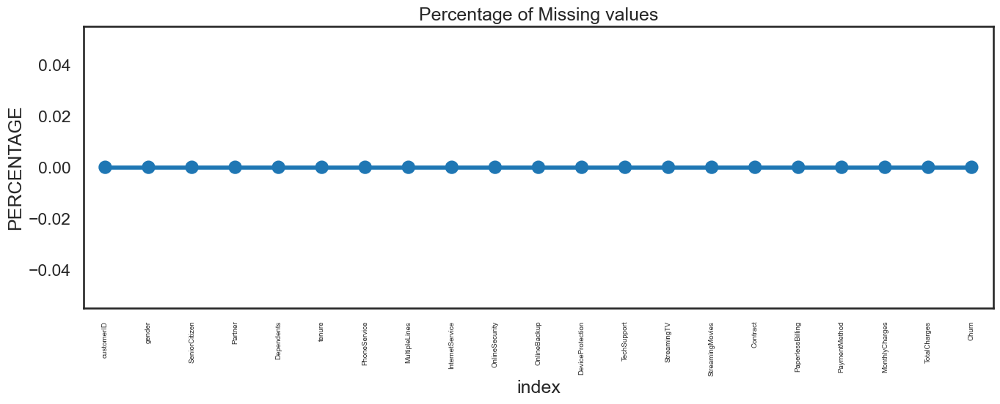

In [14]:
missing = pd.DataFrame((telco_data.isnull().sum())*100/telco_data.shape[0]).reset_index()
plt.figure(figsize=(16,5))
ax = sns.pointplot(x='index',y=0,data=missing)
plt.xticks(rotation =90,fontsize =7)
plt.title("Percentage of Missing values")
plt.ylabel("PERCENTAGE")
plt.show()
plt.close()

### Missing Data - Initial Intuition

* Here, we don't have any missing data.
General Thumb Rules:

* When we see the lot of outliers in the dataset then don't really use mean because if the dataset has lots of outliers then we would be in the situation where the regression analysis will have drastic changes.
* And if we get features which have high number of missing values then it's better to drop them.
* As there's no thumb rule on what criteria do we delete the columns with high number of missing values, still one can delete the columns, if you have more than 30-40% of missing values.

# **DATA** **CLEANING**


**1.** Here we will be copying the telco_data data to preprocess it further

In [15]:
telco_data_copy = telco_data.copy()

**2.** Total Charges should be numeric amount. So it's better to convert them to numeral type

In [16]:
telco_data.TotalCharges = pd.to_numeric(telco_data.TotalCharges, errors='coerce')
telco_data.isnull().sum()

customerID           0
gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64

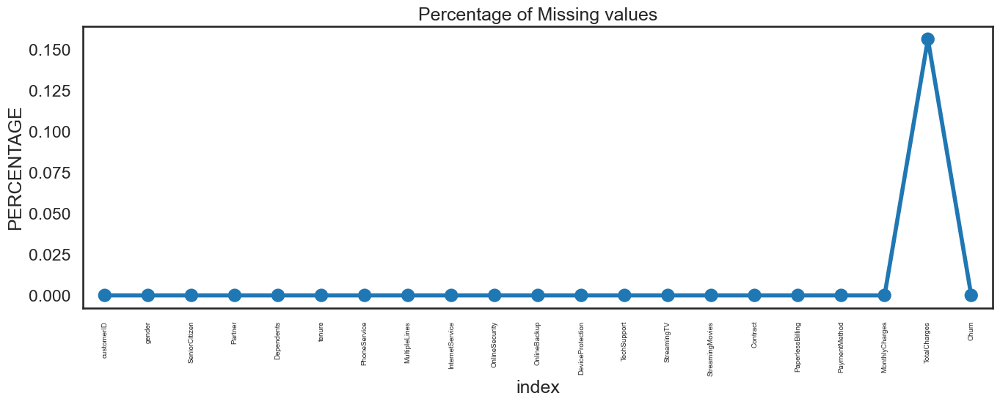

In [17]:
missing = pd.DataFrame((telco_data.isnull().sum())*100/telco_data.shape[0]).reset_index()
plt.figure(figsize=(16,5))
ax = sns.pointplot(x='index',y=0,data=missing)
plt.xticks(rotation =90,fontsize =7)
plt.title("Percentage of Missing values")
plt.ylabel("PERCENTAGE")
plt.show()
plt.close()

**3.** Here we can see that there are missing values in the Total charges column.

In [18]:
telco_data.loc[telco_data ['TotalCharges'].isnull() == True]

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,4472-LVYGI,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,NaN,No
753,3115-CZMZD,Male,0,No,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,NaN,No
936,5709-LVOEQ,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,...,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,NaN,No
1082,4367-NUYAO,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,NaN,No
1340,1371-DWPAZ,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,NaN,No
3331,7644-OMVMY,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,NaN,No
3826,3213-VVOLG,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,NaN,No
4380,2520-SGTTA,Female,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,NaN,No
5218,2923-ARZLG,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,NaN,No
6670,4075-WKNIU,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,...,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,NaN,No


4. Missing Value Treatement

Since the % of these records compared to total dataset is very low ie 0.15%, it is safe to ignore them from further processing.

In [19]:
#Removing missing values
telco_data.dropna(how = 'any', inplace = True)

#telco_data.fillna(0)

**5.** Feature binning:

Divide customers into bins based on tenure e.g. for tenure < 12 months: assign a tenure group if 1-12, for tenure between 1 to 2 Yrs, tenure group of 13-24; so on...

In [20]:
# Get the max tenure
print(telco_data['tenure'].max()) #72

72


In [21]:
# Here we will try to group the tenures
labels = ["{0} - {1}".format(i, i + 11) for i in range(1, 72, 12)]

telco_data['tenure_group'] = pd.cut(telco_data.tenure, range(1, 80, 12), right=False, labels=labels)

In [22]:
telco_data['tenure_group'].value_counts()

tenure_group
1 - 12     2175
61 - 72    1407
13 - 24    1024
25 - 36     832
49 - 60     832
37 - 48     762
Name: count, dtype: int64

Remove the word "automatic" from 'PaymentMethod' column

In [23]:

telco_data['PaymentMethod'] = telco_data['PaymentMethod'].str.replace(r'\s*\(automatic\)', '', regex=True)

**6.** Remove columns not required for processing

In [24]:
#drop column customerID and tenure
telco_data.drop(columns= ['customerID','tenure'], axis=1, inplace=True)
telco_data.head()

,gender,SeniorCitizen,Partner,Dependents,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,tenure_group
0,Female,0,Yes,No,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No,1 - 12
1,Male,0,No,No,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No,25 - 36
2,Male,0,No,No,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes,1 - 12
3,Male,0,No,No,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer,42.30,1840.75,No,37 - 48
4,Female,0,No,No,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes,1 - 12


In [25]:
telco_cleaned=telco_data.copy()

7. Feature Encoding:</br>
 We use Label-Encoding for target-variable and Dummy-Encoding to convert categorical values into binary numerical values  i.e. Yes=1 ; No = 0

In [26]:
#performing Label Encoding on Churn
telco_data_numeric=telco_data.copy()
telco_data_numeric['Churn'] = np.where(telco_data_numeric.Churn == 'Yes',1,0)

In [27]:
telco_data_numeric.head()

,gender,SeniorCitizen,Partner,Dependents,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,tenure_group
0,Female,0,Yes,No,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,0,1 - 12
1,Male,0,No,No,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,0,25 - 36
2,Male,0,No,No,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,1,1 - 12
3,Male,0,No,No,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer,42.30,1840.75,0,37 - 48
4,Female,0,No,No,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,1,1 - 12


In [28]:
#Performing Dummy Encoding on categorical columns
telco_data_dummies = pd.get_dummies(telco_data_numeric,dtype=int)
telco_data_dummies.head()

,SeniorCitizen,MonthlyCharges,TotalCharges,Churn,gender_Female,gender_Male,Partner_No,Partner_Yes,Dependents_No,Dependents_Yes,...,PaymentMethod_Bank transfer,PaymentMethod_Credit card,PaymentMethod_Electronic check,PaymentMethod_Mailed check,tenure_group_1 - 12,tenure_group_13 - 24,tenure_group_25 - 36,tenure_group_37 - 48,tenure_group_49 - 60,tenure_group_61 - 72
0,0,29.85,29.85,0,1,0,0,1,1,0,...,0,0,1,0,1,0,0,0,0,0
1,0,56.95,1889.50,0,0,1,1,0,1,0,...,0,0,0,1,0,0,1,0,0,0
2,0,53.85,108.15,1,0,1,1,0,1,0,...,0,0,0,1,1,0,0,0,0,0
3,0,42.30,1840.75,0,0,1,1,0,1,0,...,1,0,0,0,0,0,0,1,0,0
4,0,70.70,151.65,1,1,0,1,0,1,0,...,0,0,1,0,1,0,0,0,0,0


# **EXPLORATORY DATA ANALYSIS**

In [29]:
#setting palettes for plotting
churn_palette=['#9d2c00','#2066a8']

cpalette = {"No": "#ff5233", "Yes": "#821ff9",0: "#ff5233", 1: "#821ff9"} # other:9d2c00,2066a8

count_palette= ["#FF5733", "#DAF7A6","#FFC300", "#C70039",'#dd5182',"#444e86", '#955196',  '#ff6e54', '#ff764a','#ffa600']

In [30]:
telco_data['SeniorCitizen'] = np.where(telco_data.SeniorCitizen == 1,"Yes","No")
telco_cleaned['SeniorCitizen']=np.where(telco_data.SeniorCitizen == 1,"Yes","No")

In [31]:
telco_data.dtypes

gender                object
SeniorCitizen         object
Partner               object
Dependents            object
PhoneService          object
MultipleLines         object
InternetService       object
OnlineSecurity        object
OnlineBackup          object
DeviceProtection      object
TechSupport           object
StreamingTV           object
StreamingMovies       object
Contract              object
PaperlessBilling      object
PaymentMethod         object
MonthlyCharges       float64
TotalCharges         float64
Churn                 object
tenure_group        category
dtype: object

In [32]:
# Get a list of object-type column names
object_columns = telco_data.select_dtypes(include='object').columns
# Convert object-type columns to categorical type
telco_data[object_columns] = telco_data[object_columns].astype('category')

telco_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   gender            7032 non-null   category
 1   SeniorCitizen     7032 non-null   category
 2   Partner           7032 non-null   category
 3   Dependents        7032 non-null   category
 4   PhoneService      7032 non-null   category
 5   MultipleLines     7032 non-null   category
 6   InternetService   7032 non-null   category
 7   OnlineSecurity    7032 non-null   category
 8   OnlineBackup      7032 non-null   category
 9   DeviceProtection  7032 non-null   category
 10  TechSupport       7032 non-null   category
 11  StreamingTV       7032 non-null   category
 12  StreamingMovies   7032 non-null   category
 13  Contract          7032 non-null   category
 14  PaperlessBilling  7032 non-null   category
 15  PaymentMethod     7032 non-null   category
 16  MonthlyCharges    7032 non-nu

In [33]:
#colors=['red','steelblue','darkorange','darkviolet','gold','mediumblue','lime']
#churn_palette=['#9d2c00','#2066a8']
#cpalette = {"No": "#2066a8", "Yes": "#9d2c00",0: "#2066a8", 1: "#9d2c00"}
#sns.set_palette(sns.color_palette('Dark Red'))

In [34]:
#creating column-name lists for each category
categorical_col=[]
numerical_col=[]
for col in telco_data.columns:
    if (telco_data[col].dtype == 'int64' or telco_data[col].dtype=='float64'):
       numerical_col.append(col)
    else:
      categorical_col.append(col)
if( 'Churn' in categorical_col): categorical_col.remove('Churn')


In [35]:
print("Catergorical columns are:\n",categorical_col)
print("\n Numerical columns are:\n",numerical_col)

Catergorical columns are:
 ['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'tenure_group']

 Numerical columns are:
 ['MonthlyCharges', 'TotalCharges']


In [36]:
pd.options.display.max_rows = None

pd.options.display.max_columns = None

# **1. UNIVARIATE ANALYSIS**

## **1A. UNIVARIATE CATEGORICAL ANALYSIS**

dist_uni_plot() is user-defined function for plotting distribution using a countplot and pie chart to show the %distribution.

 Univariate analysis plots for a given dataframe and its column is shown using a count plot and the respective churn rate is calculated with crosstab() and a heatmap is used to display the churn rates.

In [37]:
def dist_uni_plot(telco_data,col):
        n=telco_data[col].nunique()
        labelcount=telco_data[col].value_counts()
        labels=labelcount.index
        churnlabel=telco_data['Churn'].value_counts().index
        if (n>3):
           figsize=(16,16)
        else: figsize=(12,12)
        fig, axes = plt.subplots(2, 2, figsize=figsize, layout="constrained")
        sns.set_style('white')

        #plt.use.style('seaborn-v0_8')
        fig.suptitle('Distribution and Univariate Analysis of '+col+'  wrt. Churn')

        #SETTING AXES
        dist_cnt_plt=axes[0][0]
        pie_plt=axes[0][1]
        uni_cnt_plt=axes[1][0]
        heatmap_plt=axes[1][1]

        #1. DISTRIBUTION OF COLUMNS

        sns.countplot(ax=dist_cnt_plt,data=telco_data, x=col, palette=count_palette)#count_palette)
        sns.despine()
        dist_cnt_plt.set_title('1a. Count  of '+col )

        #bar labels
        for p in dist_cnt_plt.patches:
                dist_cnt_plt.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 5), textcoords='offset points')
        dist_cnt_plt.grid(False)
        
        #if(n>3):
            #dist_cnt_plt.set_xticklabels(dist_cnt_plt.get_xticklabels(), rotation=45)
        

        #2. PIE FOR PERCENTAGE

        labels=telco_data[col].value_counts().index
        pie_plt.pie(telco_data[col].value_counts(), colors=count_palette,autopct='%1.1f%%',pctdistance=0.75,startangle=90, wedgeprops={'width': 0.5})

        #setting the title and legend
        pie_plt.set_title('1b. % distribution of '+ col)
        pie_plt.legend(labels,bbox_to_anchor=(0.5, 1.3), loc='upper center',ncols=2)
        pie_plt.grid(False)

        #3. COUNT PLOT FOR UNIVARIATE ANALYSIS

        sns.countplot(ax=uni_cnt_plt,data=telco_data, x=col, hue='Churn', palette=cpalette)
        sns.despine()
        uni_cnt_plt.set_title('2a. Univariate Analysis of '+col+' wrt. Churn')

        #add bar labels
        for p in uni_cnt_plt.patches:
            uni_cnt_plt.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                                  ha='center', va='center', xytext=(0, 5), textcoords='offset points')
        uni_cnt_plt.legend(title='Churn',bbox_to_anchor=(0.5, 1.3), loc='upper center',ncols=2)
        
        #if n>3:
           # uni_cnt_plt.set_xticklabels(uni_cnt_plt.get_xticklabels(), rotation=45)
        uni_cnt_plt.grid(False)


        #4. HEATMAP FOR CROSSTAB SHOWING CHURN RATE

        churn_arr=(pd.crosstab(telco_data[col],telco_data['Churn'])).to_numpy()
        churnrate=churn_arr/churn_arr.sum(axis=1, keepdims=True)
        sns.heatmap(churnrate*100, xticklabels=churnlabel,yticklabels=labels, annot=True,fmt=".2f",cmap='RdPu',cbar=False,linecolor= "white",linewidths = 0.1)#sns.cubehelix_palette(dark=.25, light=.75,as_cmap=True),linewidth=.5
        heatmap_plt.set_title("2b. Heatmap for "+col+ " wrt. Churn-Rate")
        heatmap_plt.grid(False)


        fig.get_layout_engine().set( hspace=0.05,wspace=0.05)
        #plt.tight_layout()
        plt.savefig('plots/Univariate_plots/dist_uni_'+col+'.png')

        plt.show()




In [38]:
import warnings
warnings.filterwarnings('ignore')

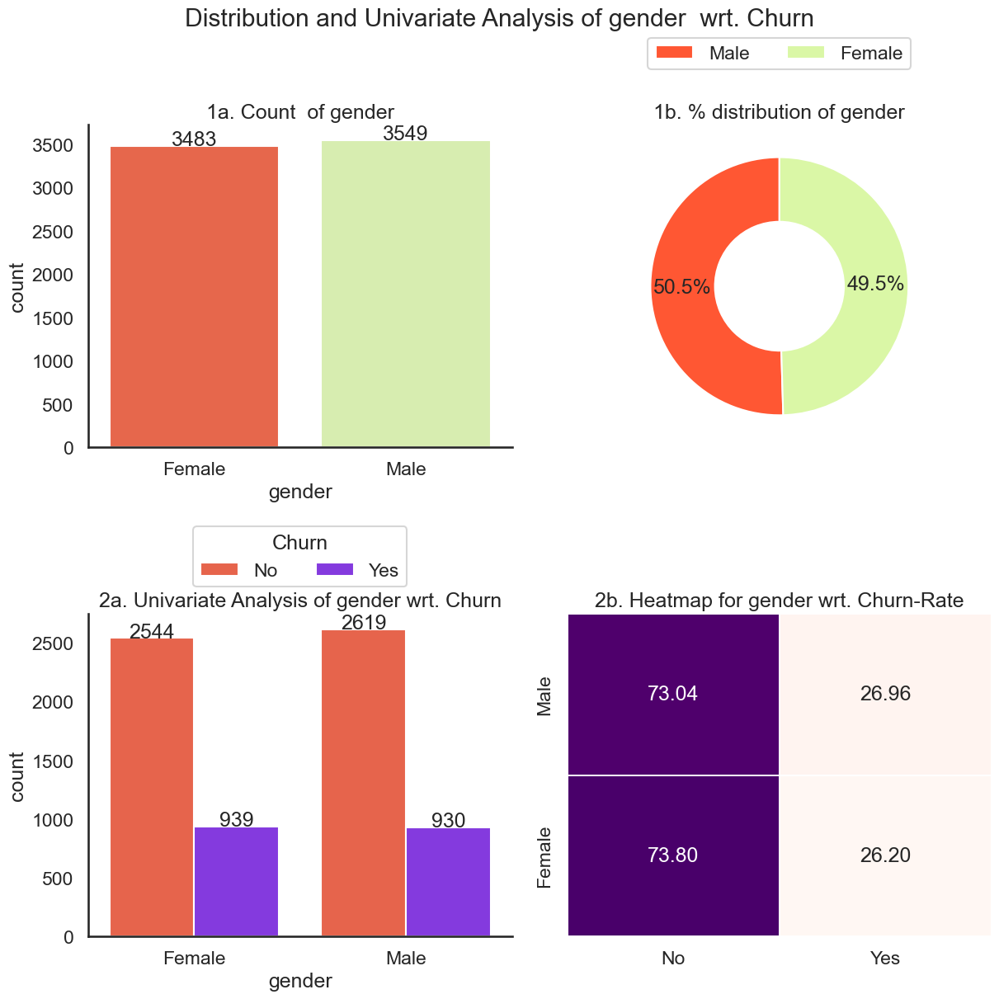

In [39]:
dist_uni_plot(telco_data,col='gender')

 Insight:
1. We see that there is equal distribution of male and females.
2. The Churn rate for females (~26.95%) and males (26.2%) is same.

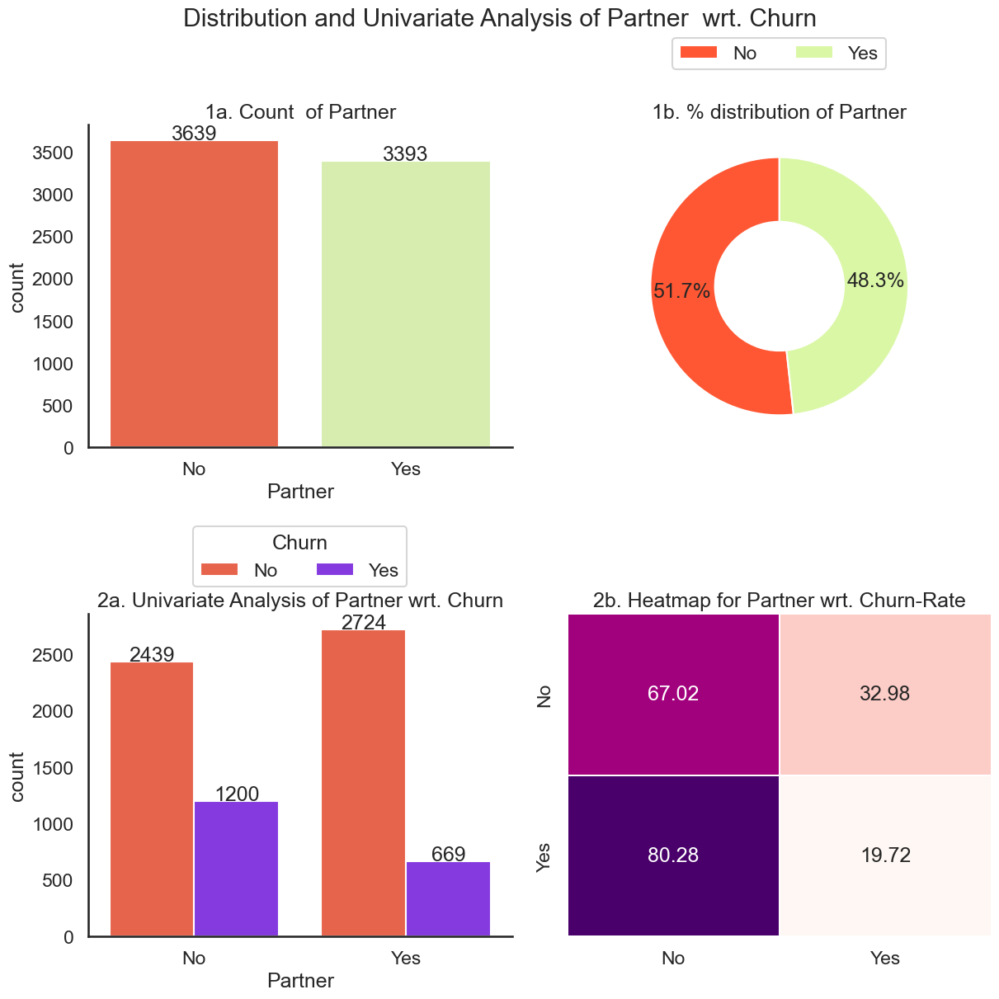

In [40]:
dist_uni_plot(telco_data,'Partner')



Insight:
1. 52% customers dont have partners compared to the ones who have partners.
2. The churn rate of customers with partners is 19.7% where as its 32.97% for
 the customers without partners. 
3. So Customers without partners are more likely to churn.

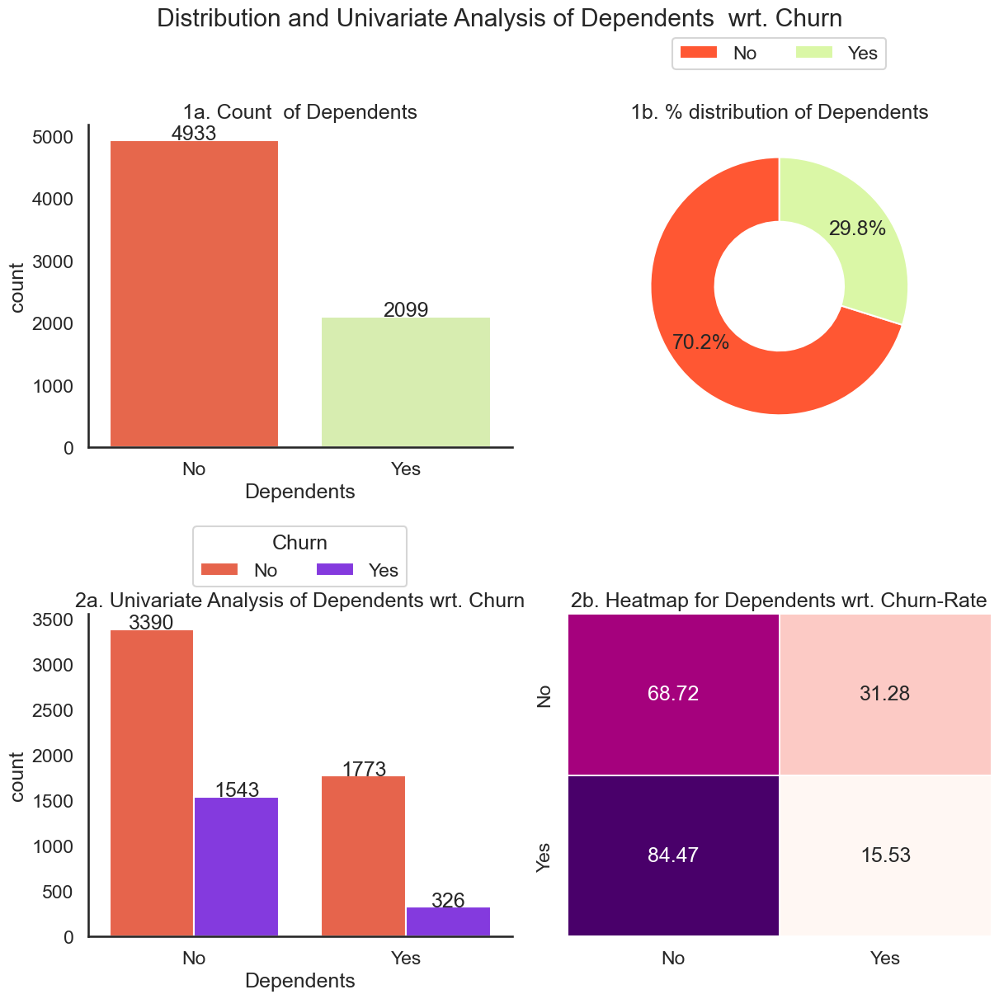

In [41]:
dist_uni_plot(telco_data,'Dependents')

Insight:
1. 70% of Customers have a dependent.
2. Customers with a dependant havea significantly lower churn rate when compare to the cutomers with a dependent ~31.28%


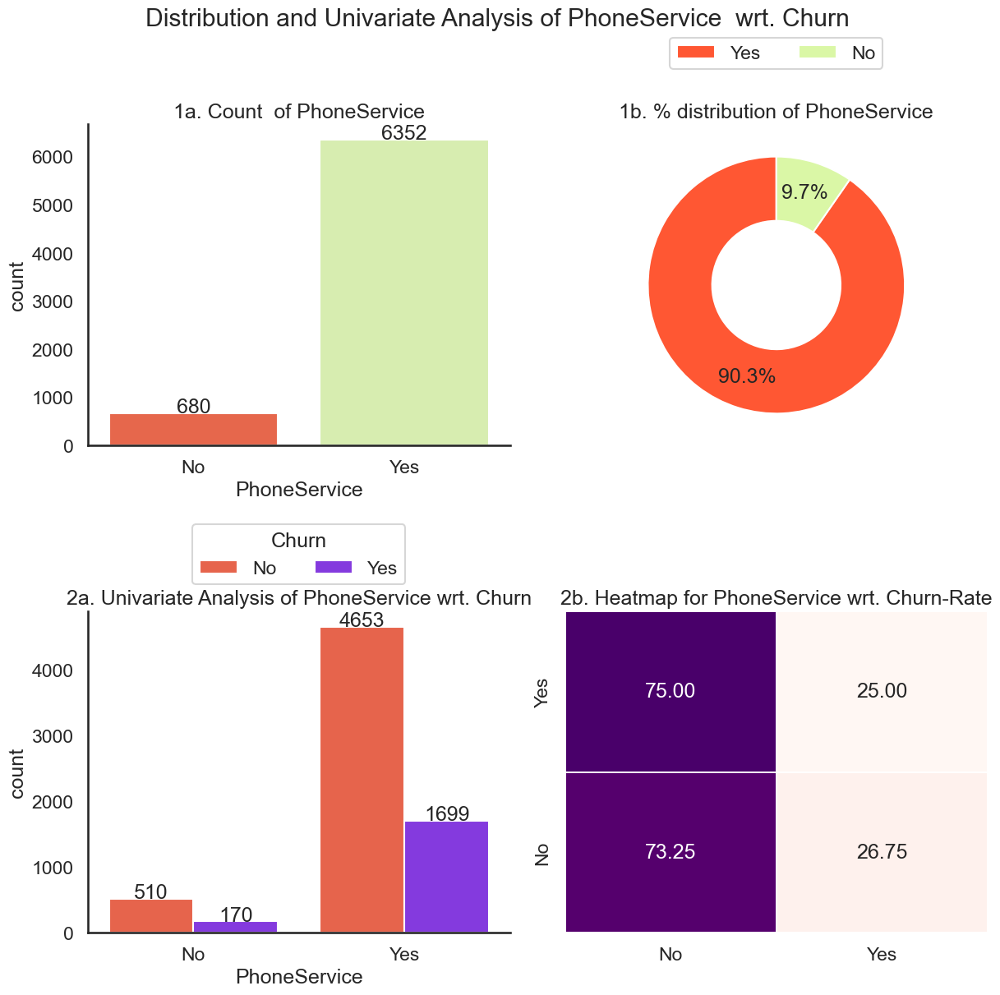

In [42]:
dist_uni_plot(telco_data,'PhoneService')

Insight:
1. 90.3% customers have a phone service.
2. But the churn rate for customers with and without churn rate is similar ~26.75%

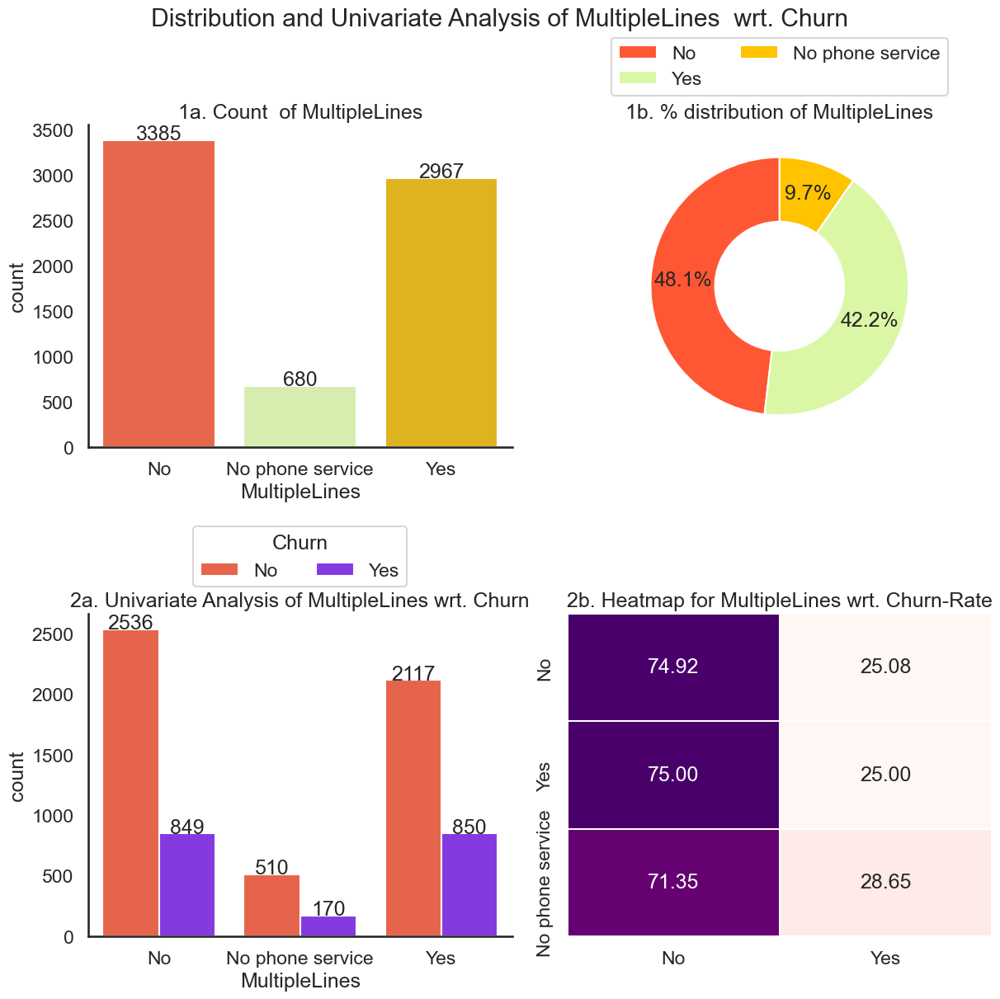

In [43]:
dist_uni_plot(telco_data, 'MultipleLines')

 Insight:
1. 48.1% customers dont have multiple lines.
2. 42% Customers have a multiple line. So they might cancel inactive accounts frequently
3. Customers with  no phoner service have more churn rate ~29%. Customers with other options too have a significant churn rate.  


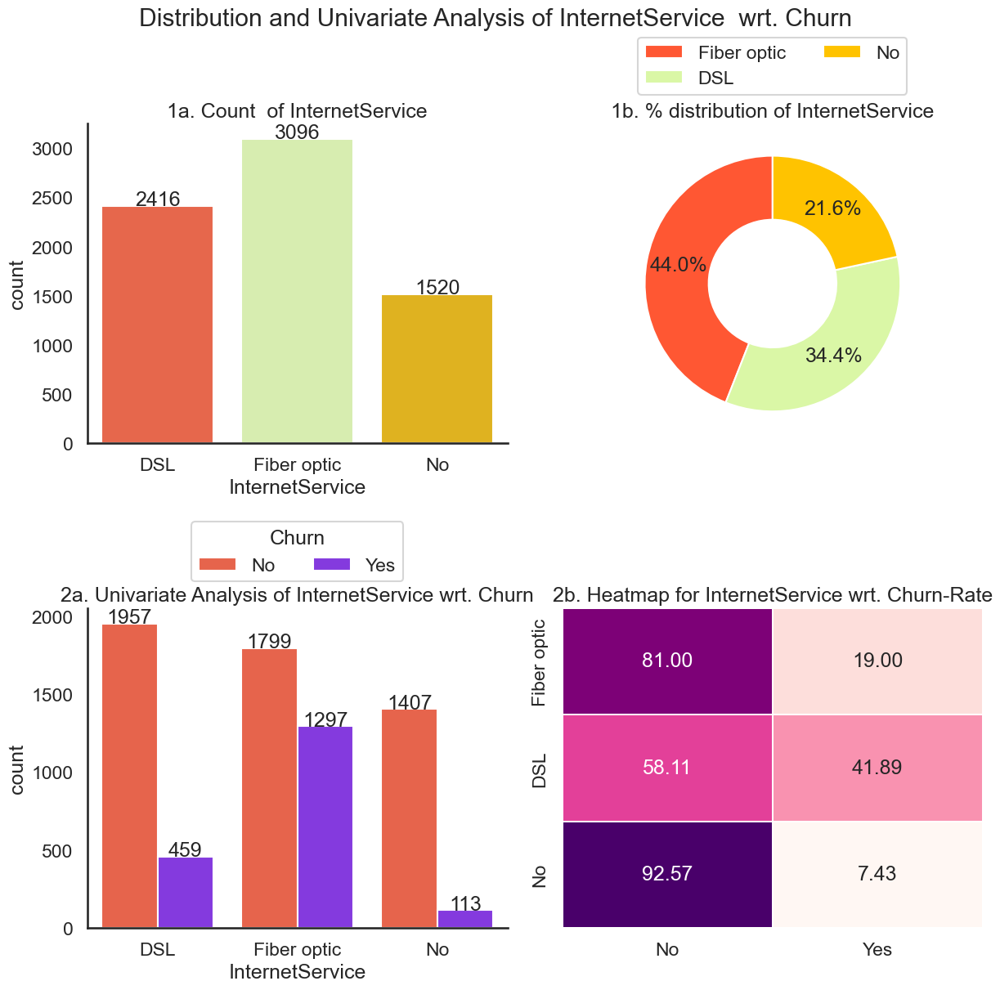

In [44]:
dist_uni_plot(telco_data,'InternetService')

Insight:

1. It could be seen that most of the Telco services are Fiber Optic service as this option is becoming common among customers (~44%)
2. Customers without internet have very low churn rate 7% whereas as the users for fibre optic service increases, churn rate also increases(~42%)


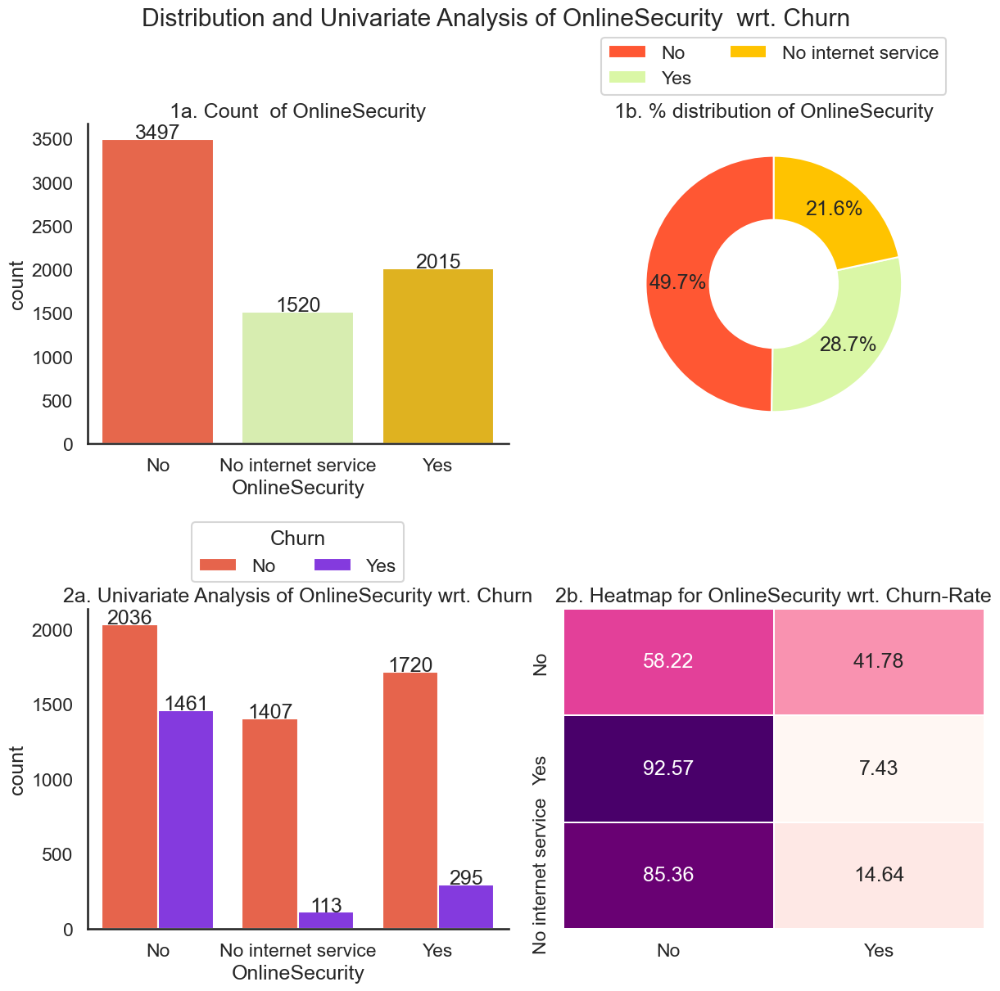

In [45]:
dist_uni_plot(telco_data,'OnlineSecurity')

Insight:
1. 49.7% of Customers dont have online security
2. Customers with no online security is more likely  to churn ~41.78%
wheras other options are significantly low.

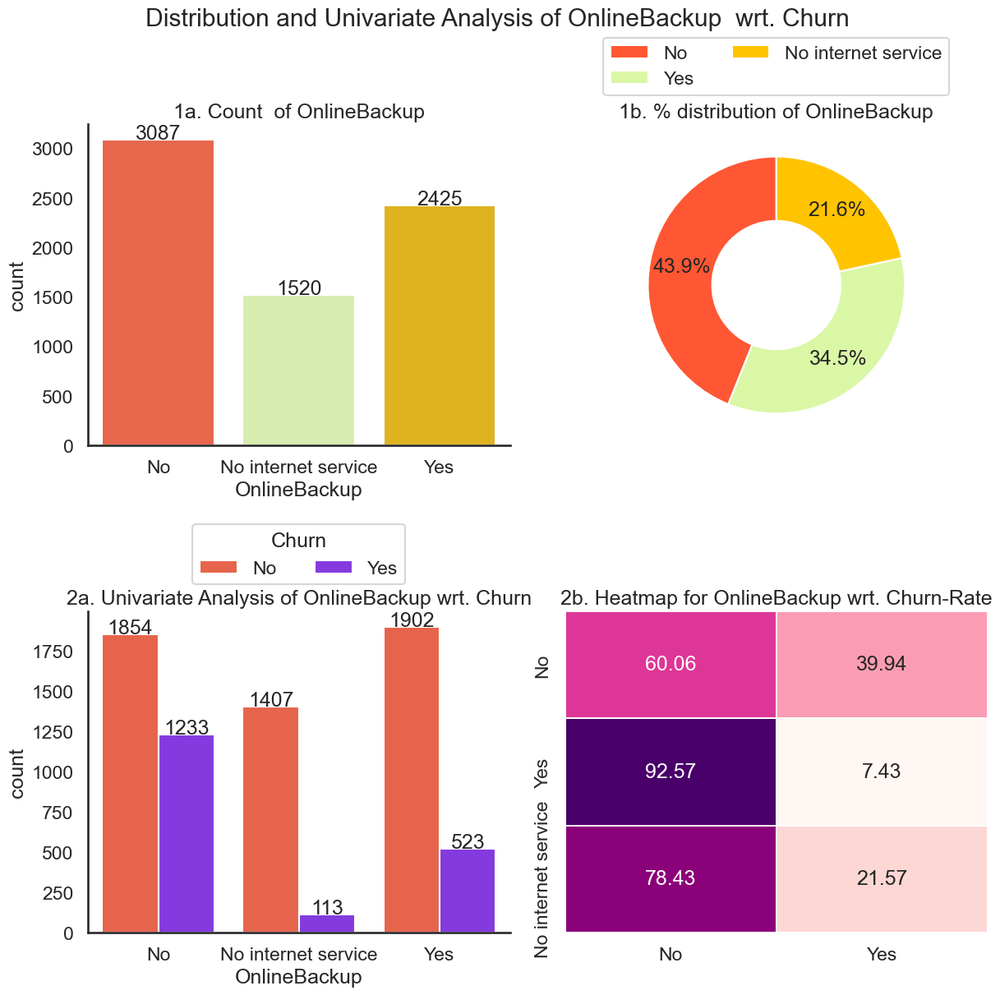

In [46]:
dist_uni_plot(telco_data, 'OnlineBackup')

Insight:

1. 43.9% customers do not prefer Online Backup Services as clearly shown in the above plot.
2. There are quite a customers who do not opt the internet service as well.
3. Therefore, we should also consider whether a person has an internet service or not before determining whether they would prefer online backup.
4. Customers who had internet had a very low churn rate ~7%
5. Customers without internet or no backup are likely to churn with churn rates ~ 22% and 40% respectively  


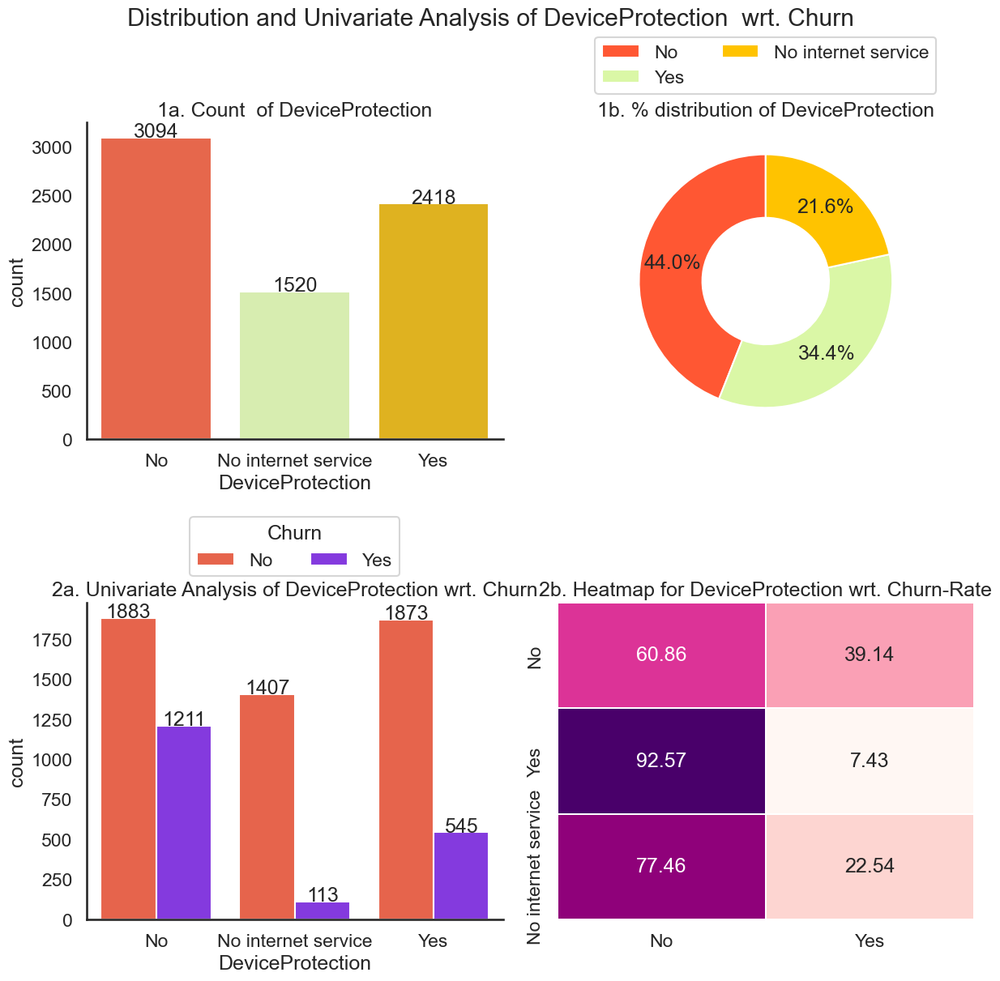

In [47]:
dist_uni_plot(telco_data,'DeviceProtection')

Insight:

1. Most of the cusomers didnt have device protection.
2. Customers who dont have device protection have 39.14% churnrate

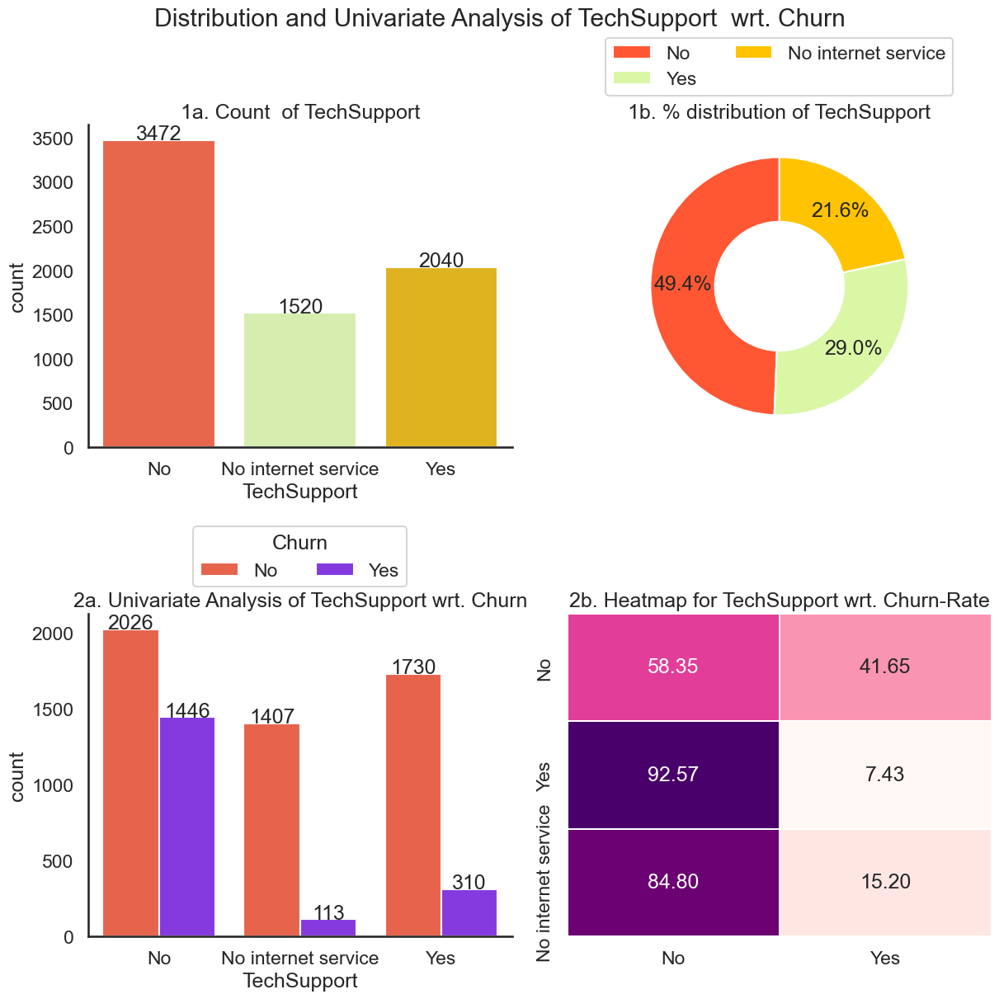

In [48]:
dist_uni_plot(telco_data, 'TechSupport')



Insight:
1. Most customers dont have tech support.
2. Customers who dont have Tech Support have highest churn rates 41.65%. Customers who have Tech Support have lowest churn rates 7.4%. 

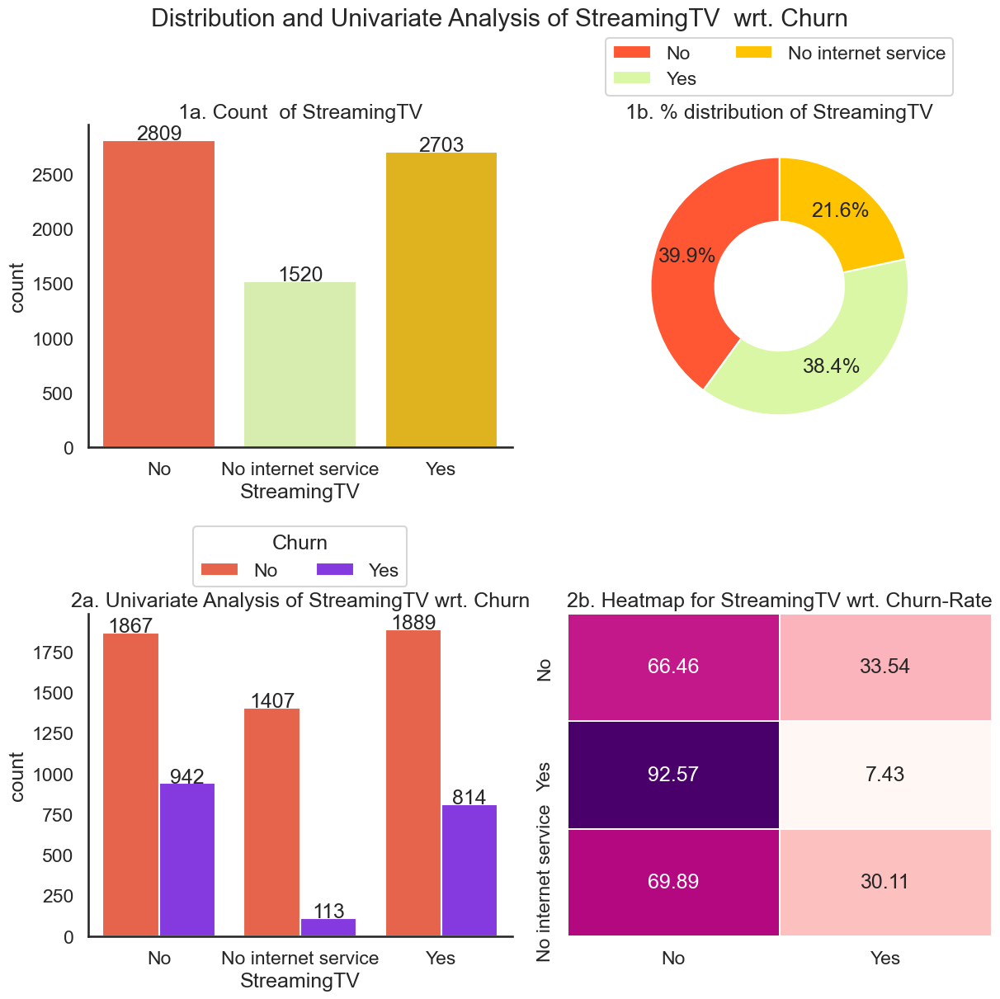

In [49]:
dist_uni_plot(telco_data,'StreamingTV')

Insight:

1. The number of Customers with no streaming TV or dont have a internet service are likely to churn.
2. Customers with no internet and no streaming tv have a churn rate in 30-35%

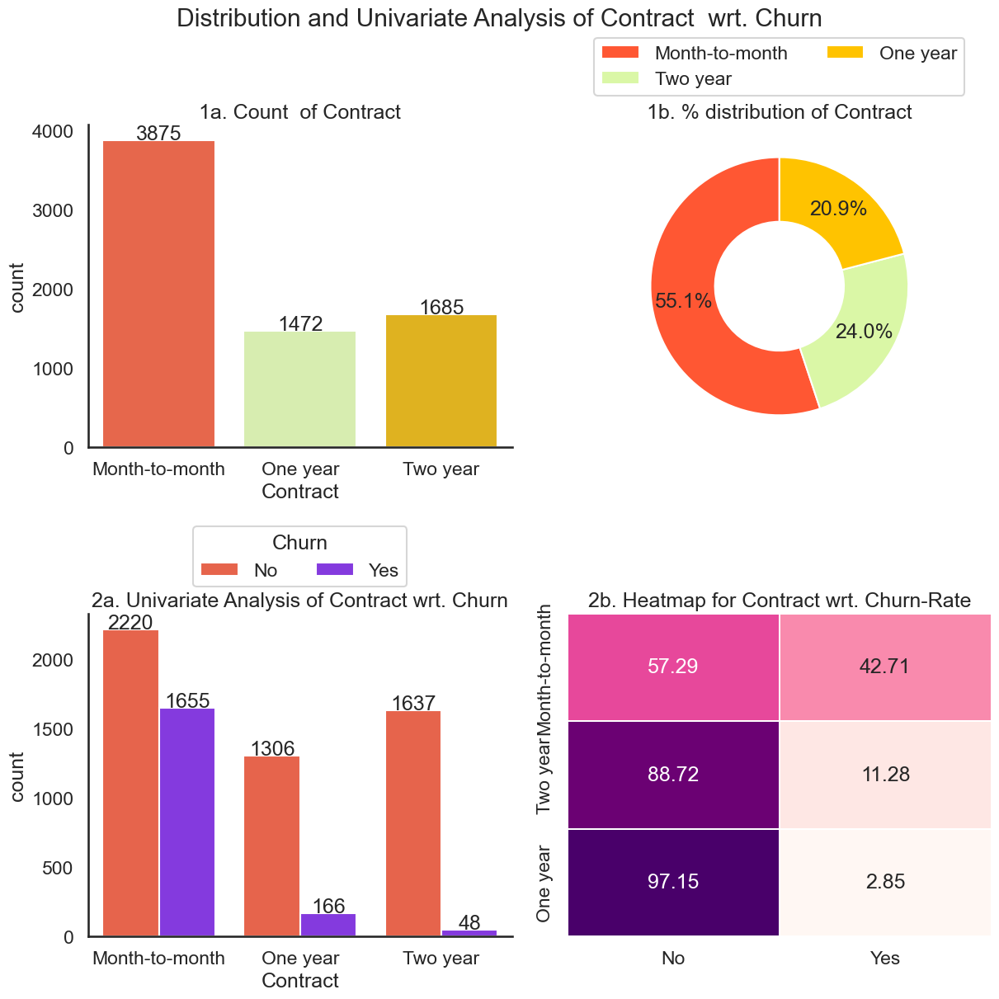

In [50]:
dist_uni_plot(telco_data, 'Contract')

Insight:

1. We have a significantly large portion of the data where the contract is month-to-month 43% compared to either one-year and two-year contracts which are having very lower churn rates
2. This is true in real-life as well because most of the customers prefer to stick with month-to-month contract rather than staying with the same service for a long period of time.


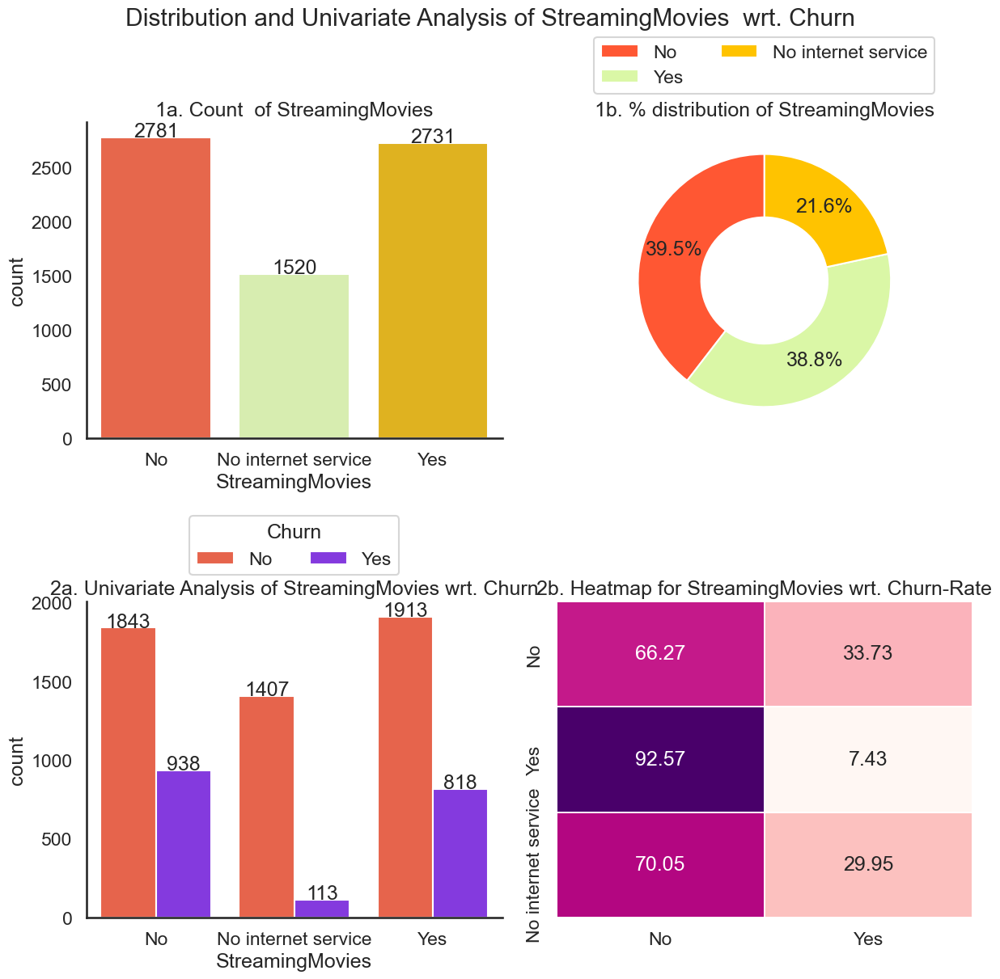

In [51]:

dist_uni_plot(telco_data,'StreamingMovies')


Insight:
1. 39% customers dont have an option for streaming movies and their churn rate is very low.
2. No internet servive and no streaming movies option services have their churn rates in 30~35%

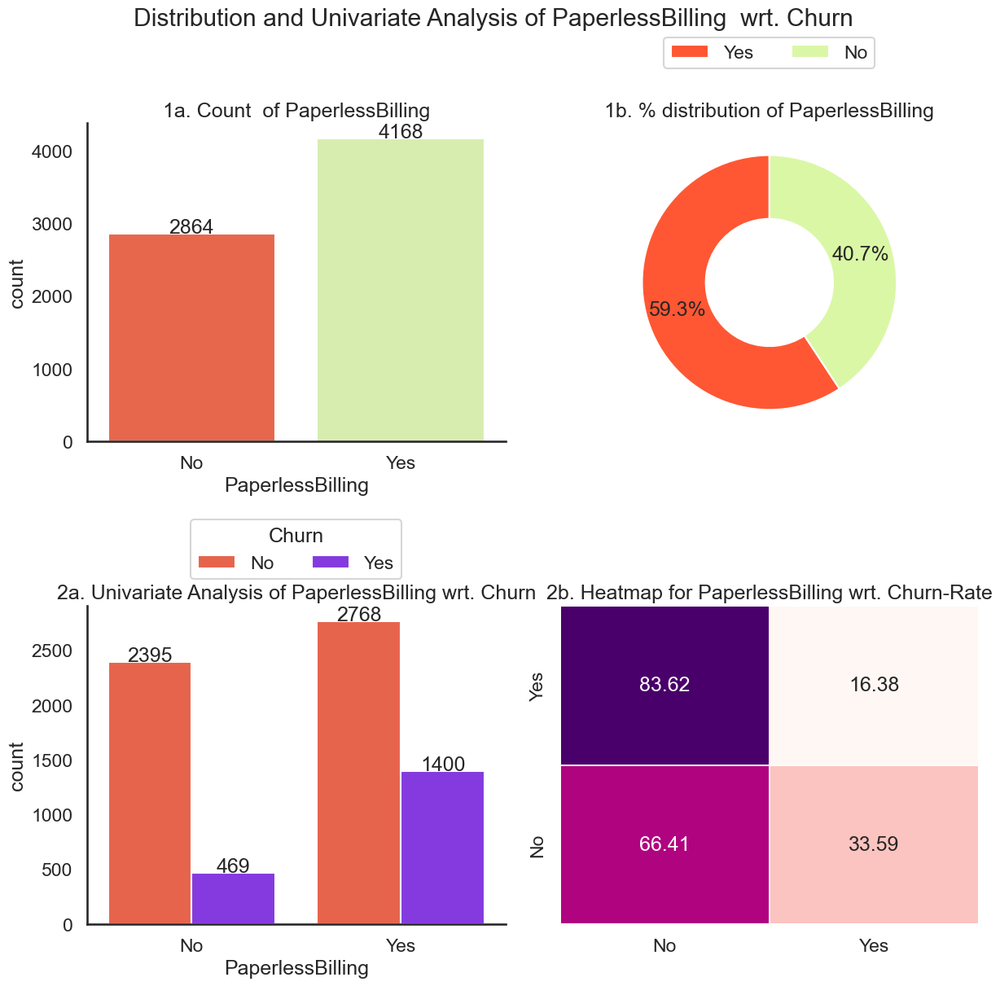

In [52]:

dist_uni_plot(telco_data,'PaperlessBilling')


Insight:

1. 59.3% of Customers prefer paperless billing as an option
2. Customers who preferred paperless bill methods are low churners

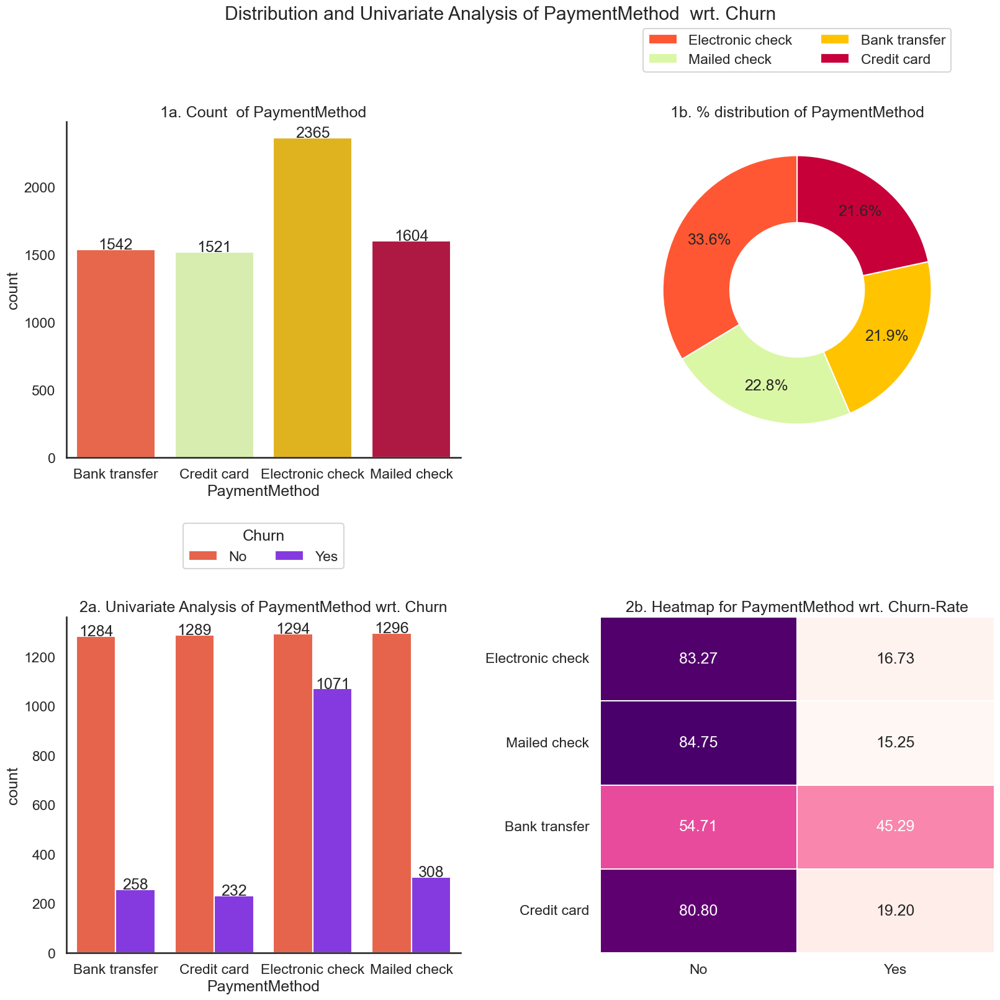

In [53]:
dist_uni_plot(telco_data,'PaymentMethod')

Insight:

1. 33.3 of customers from Telco prefer Electronic Check compared to other options.
2. There are other options which are popular among the customers as well such as Mailed check, Bank transfer (automatic) and Credit card (automatic) respectively.
3. Churn rate is highest with Bank Transfers ie 45.29% whereas other methods are likely have lower rate of churn

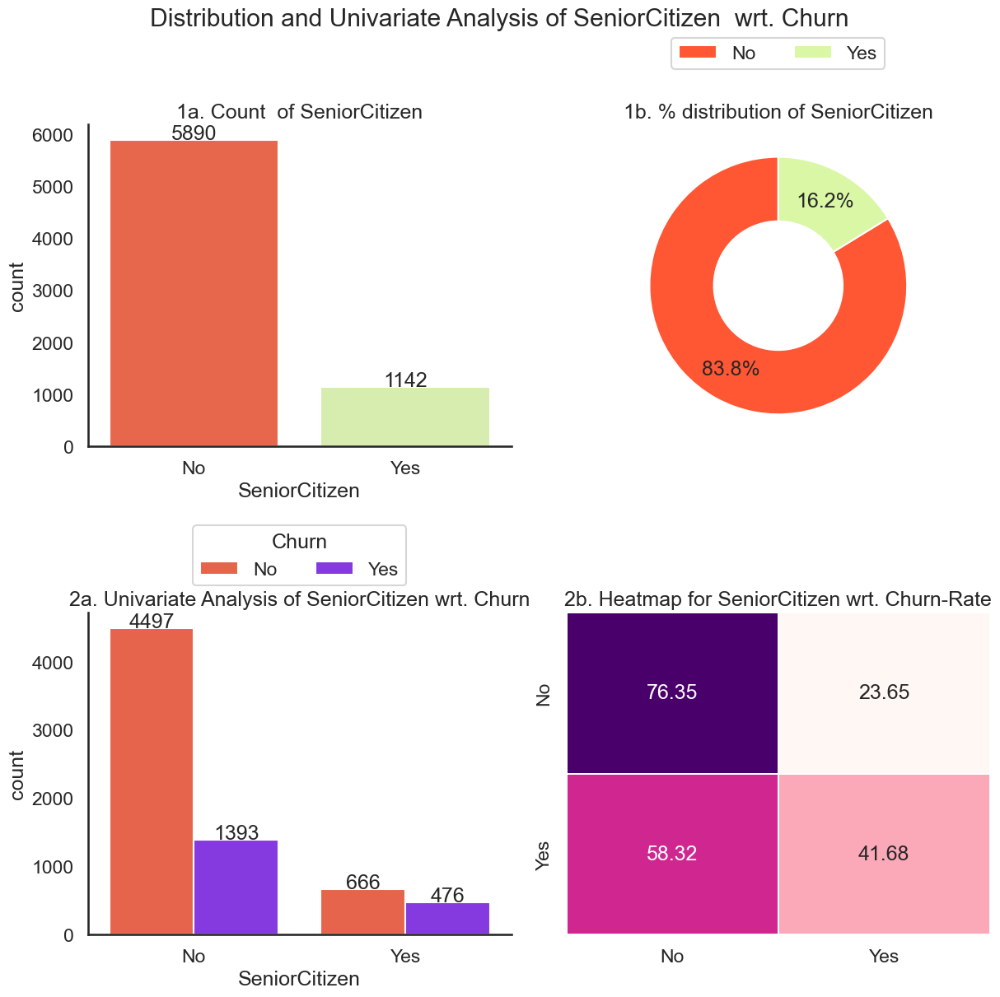

In [54]:
dist_uni_plot(telco_data,'SeniorCitizen')

Insight:
1. 83.8% of Customers are young citizens.
2. 41.68% of senior citizens switch their lines frequently.

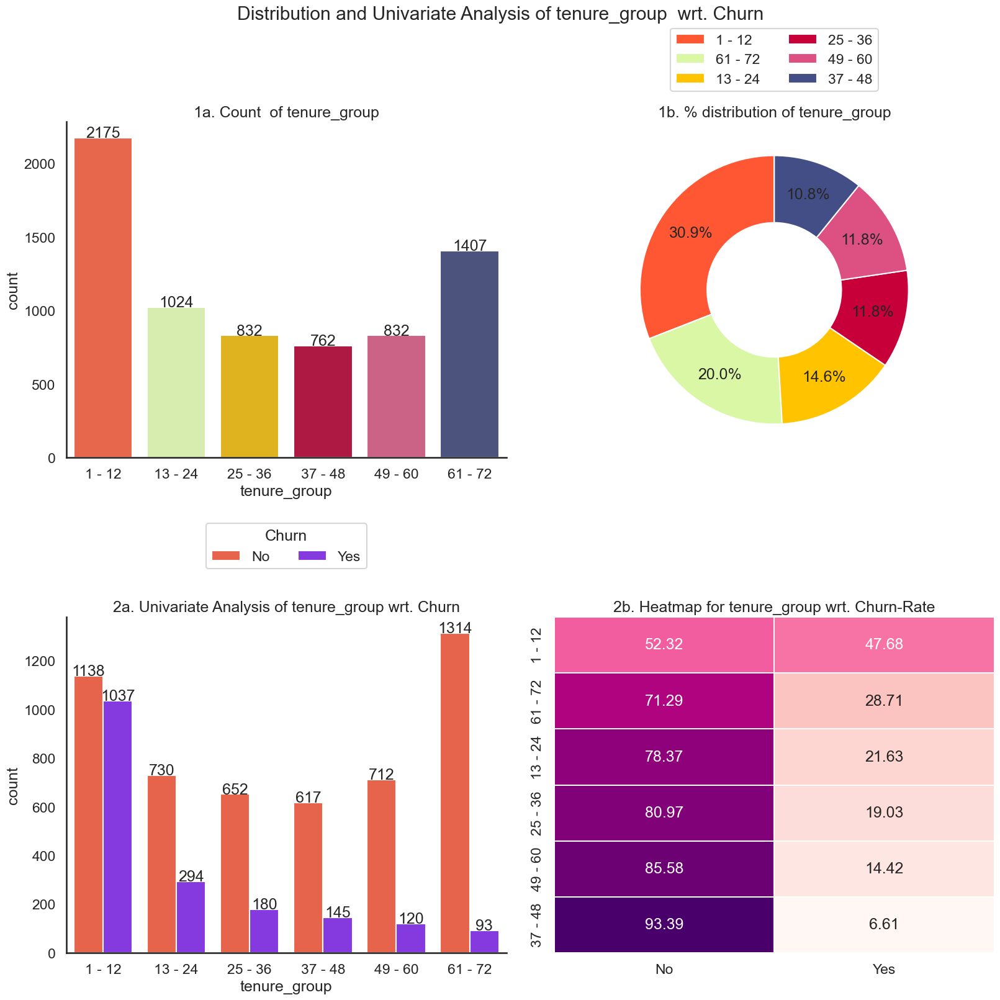

In [55]:
dist_uni_plot(telco_data,'tenure_group')

Insight:
1. 30.9% of the Customers are in the 1-12 month group ie are new customers indicating high churn rate at Telco.
2. As the length of tenure group increases,churn rate drops drasctically showing loyalty in long term customers.
3. The churn rate of the customers in the first year is 48% where as in 61-72 group is 7%

## **1B. UNIVARIATE NUMERICAL ANALYSIS**


**Churn by Monthly Charges and Total Charges**

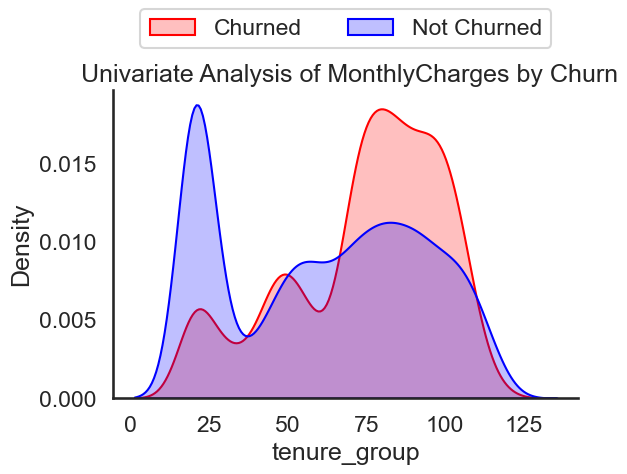

In [56]:

    plt.figure(figsize=(6,4))
    plot=sns.kdeplot(telco_data.loc[telco_data["Churn"] == 'Yes', 'MonthlyCharges'], color="Red", fill=True, label='Churned')
    sns.kdeplot(telco_data.loc[telco_data["Churn"] == 'No', 'MonthlyCharges'], color="Blue", fill=True, label='Not Churned')
    sns.despine()
    plot.legend(bbox_to_anchor=(0.5, 1.1), ncols=2, loc='lower center')
    plot.set_ylabel('Density')
    plot.set_xlabel(col)
    plot.set_title(" Univariate Analysis of MonthlyCharges by Churn")
    plt.subplots_adjust(hspace=5)
    plt.savefig('plots/Univariate_plots/Univ_MonthlyCharges.png')

    plt.show()
    plt.close()

Insight from monthly-charges density plot:
1. Churn is high when Monthly Charges ar high



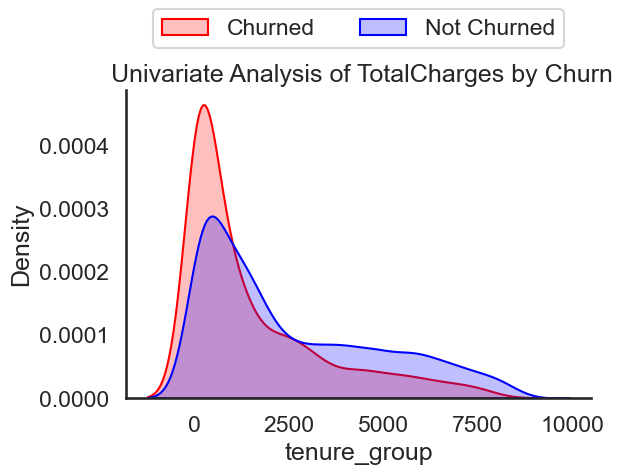

In [57]:
    plt.figure(figsize=(6,4))
    plot=sns.kdeplot(telco_data.loc[telco_data["Churn"] == 'Yes', 'TotalCharges'], color="Red", fill=True, label='Churned')
    sns.kdeplot(telco_data.loc[telco_data["Churn"] == 'No', 'TotalCharges'], color="Blue", fill=True, label='Not Churned')
    sns.despine()
    plot.legend(bbox_to_anchor=(0.5, 1.1), ncols=2, loc='lower center')
    plot.set_ylabel('Density')
    plot.set_xlabel(col)
    plot.set_title(" Univariate Analysis of TotalCharges by Churn")
    plt.subplots_adjust(hspace=5)
    plt.savefig('plots/Univariate_plots/Univ_TotalCharges.png')

    plt.show()
    plt.close()

Insight from total-charges density plot:
1. Here we get the surprising insight that as we can see that more churn is there with lower charges.

Tenure, Monthly Charges & Total Charges then the picture is bit clear :- Higher Monthly Charge at lower tenure results into lower Total Charge. Hence, all these 3 factors viz **Higher Monthly Charge**,  **Lower tenure** and **Lower Total Charge** are linkd to **High Churn**.

# 2. BIVARIATE ANALYSIS

## **2A. BIVARIATE ANALYSIS BETWEEN CATEGORICAL COLUMNS**

We use the userdefined function 'bivariate_plot()' to plot the bivariate analysis plots with respect to a particular column. The catplot() uses the Facet grid to diplay subplots for all values the column takes.

To display churn rate in a heatmap, we take the cross product between columns with their respective churn values as yes and no and store in c1 and c2. Cross product always returns a dataframe. Numerical computations can be perdformed on dataframe if they contain only numeric values. so churn rate is churn customers/total customers ie c1/(c1+c2)*100.

In [58]:

def bivariate_plot(telco_data,col):


    column_index=categorical_col.index(col)
    for i,x in enumerate(categorical_col[column_index+1:]):


        if(telco_data[x].nunique()>3)   :
                 ht=6
                 asp=1.5
        else:
            ht=5
            asp=1.15
        crosstab_data = pd.crosstab([telco_data[col], telco_data[x]], telco_data['Churn'])

        # Reset the index to convert crosstab to a DataFrame
        crosstab_data = crosstab_data.reset_index()

        # Melt the crosstab data for seaborn
        melted_data = crosstab_data.melt(id_vars=[col, x], value_vars=['Yes', 'No'], var_name='Churn', value_name='Count')

        # Plot using seaborn displot
        plot = sns.displot(palette=cpalette,data=melted_data, x=x, weights='Count', hue='Churn', col=col,col_wrap=2, multiple='dodge', shrink=0.8, height=ht, aspect=asp)
        plt.grid(visible=False)
        # Accessing each axis in the grid
        for ax in plot.axes.flat:
            # Setting the bar values
            for p in ax.patches:
                if(p.get_height()):
                    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 5), textcoords='offset points')


        # Adjusting the layout

        plot.fig.subplots_adjust(hspace=0.5,wspace=0.1)
        plot.fig.suptitle(f'{i+1}. Bivariate Analysis of {x} vs {col} with Churn as Hue',y=1.05,fontsize=20)
         # Save the plot
        plt.savefig(f'plots/categorical_plots/Bivariate_Analysis_of_{x}_and_{col}_with_Churn.png')
        
        #HEATMAP

        c1 = pd.crosstab(telco_data[telco_data.Churn=='Yes'][x], telco_data[telco_data.Churn=='Yes'][col])
        c2 = pd.crosstab(telco_data[telco_data.Churn=='No'][x], telco_data[telco_data.Churn=='No'][col])
        result =round( c1 / (c1 + c2) * 100,2)


        g=sns.FacetGrid(result)
        sns.heatmap(result,annot=True,cmap='Purples',fmt='.2f',annot_kws={"size": 10})
        plt.grid(visible=False)
        g.fig.suptitle("heatmap of Churn-rate for " +x+ " and  " +col,y=1.02,fontsize=15)
        
        plt.xticks(fontsize=7)
        plt.yticks(fontsize=7)

        # Rotate x tick labels
        if telco_data[x].nunique()>3>3:
            plt.xticks(rotation=45)
        # Display the plot
         # Save the plot
        plt.savefig(f'plots/heatmaps/Heatmap_of_{x}_and_{col}_with_Churn.png')
        plt.show()
        plt.close()

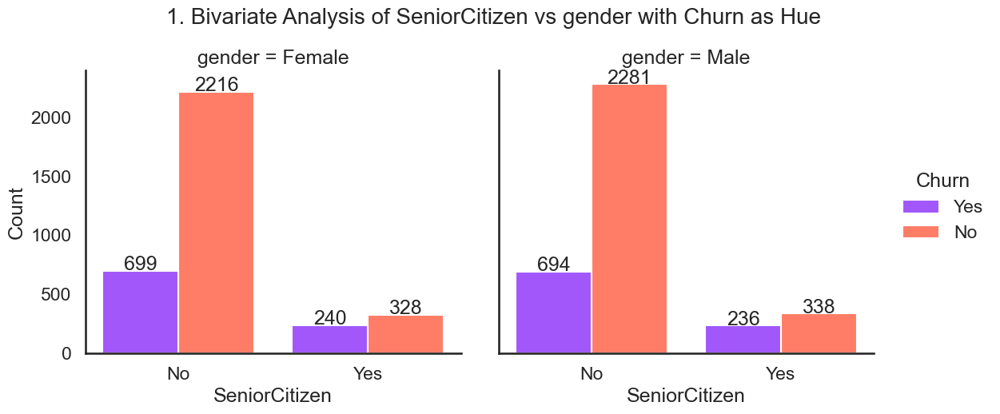

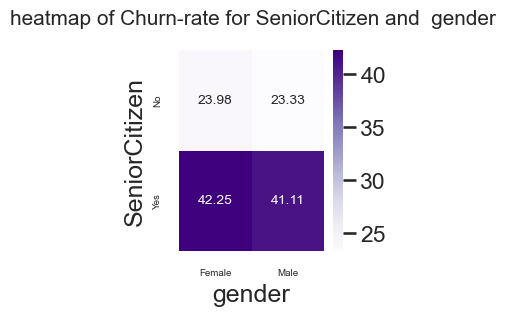

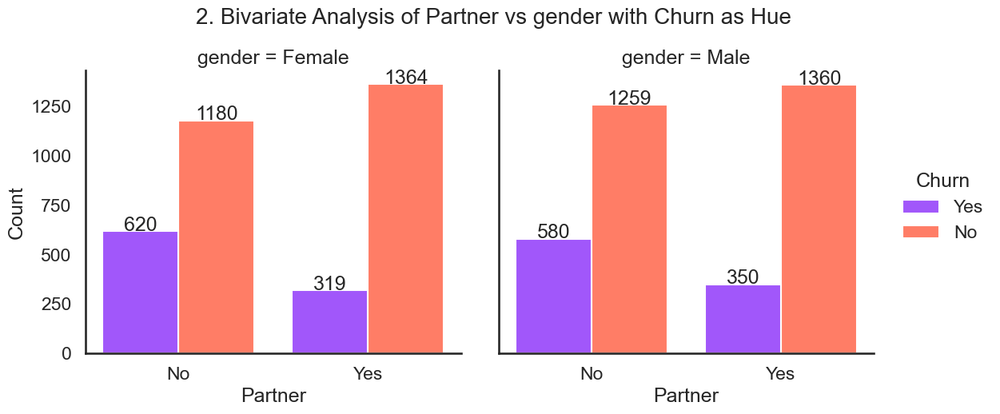

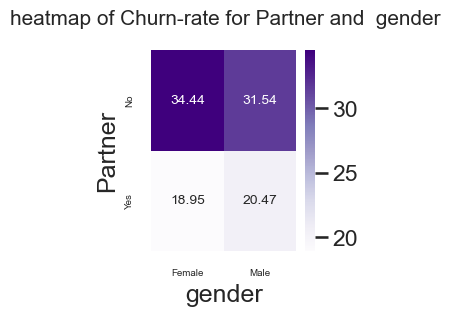

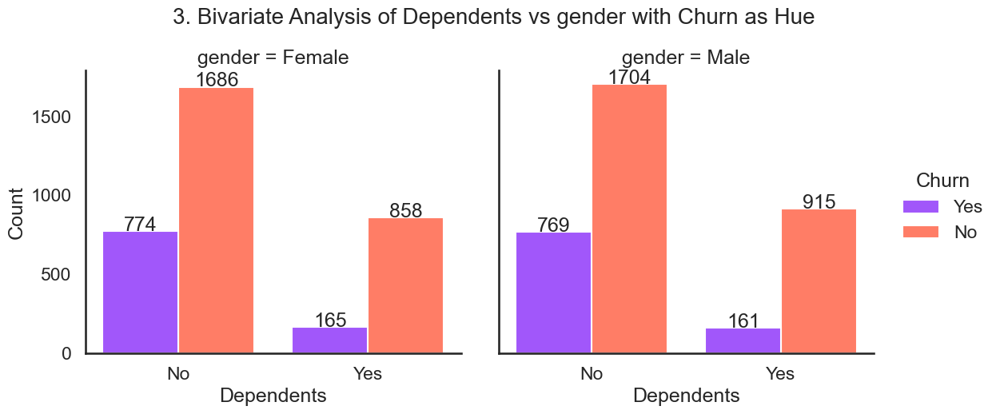

...

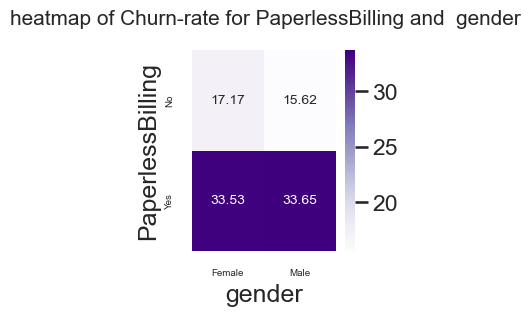

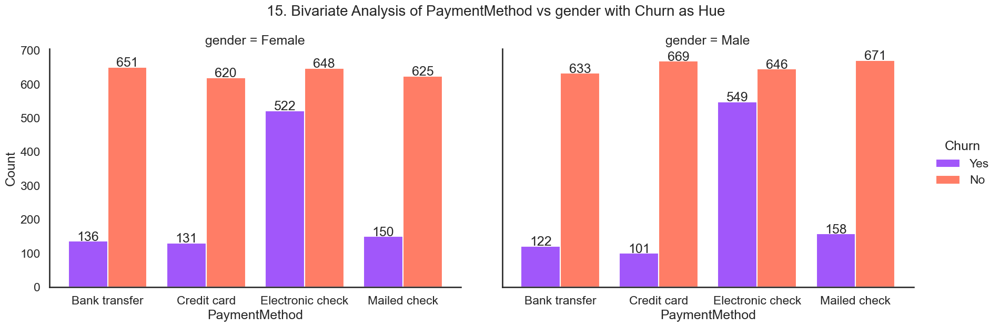

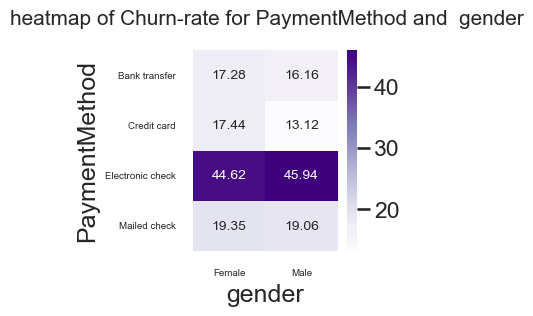

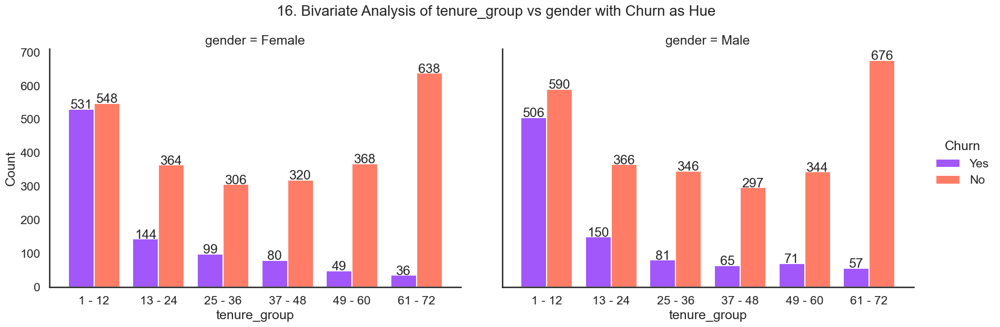

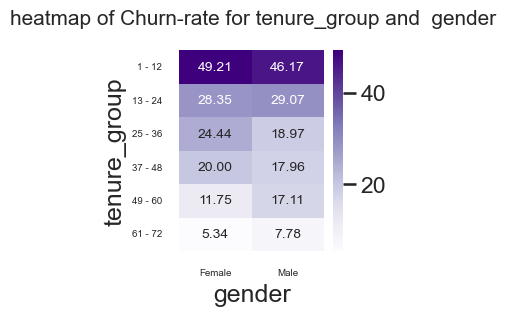

In [59]:


bivariate_plot(telco_data,'gender')

**Insight:**
1. senior citizens are high churners at 23% .gender has no impact on the churn rate
2. Female without partners are more churners at 34% and male without  a partner are churning at 31%. Female with partners are low churners at 18%
3. Customers without dependents are high churners irrespective of gender.Male Customers with dependents are low churners at 15%
4. Female cusotmers with Phone service churn at 27.2%, whare as males at 26%.Phone service churn rate is not dependant on gender
5. Male cusotmers with multiple are high churners at 29%.Female cusotmers with and wihtout service churn at 28% ans 26.5%
6. Female users with fibre optoc internet are high churners at 42.7 and male are high churner stoo at 41%.Customers with No intrrnet service are low churners
7. Female cusotmers with No online security are high churners at 42.1% whereas male at 41.5Customers with no interenet service are low churners.
8. Female with no online backup are high chhurners at 40.8 and male at39.8...gender has no effect on online backup
9. Female with no device protection ar high churners at 40% wheras men at 38.2%
10. Male with no tech support are low curners at 14%.
11. Female with No streaming tv service are high churners at 34.7 where as men at 32.4..customers with no internet servie are low churners.are low churners at 7%.
12. Female with No streaming movies service are high churners at 34.8 where as men at 32.6..customers with no internet servie are low churners at 7%.
13. Female with month to month contracts are hihg churner st at 43.74 where as men at 41.60...in one year ans two year contract, the churn rate of female is lower than that of men.
14. Male without paperless billing are low churners at 15.5.where as no paperlessbilling have no affect on gender
15. Customers with payment as electronic checkue are high customers
16. Female customers are high churners in1-12 yr group ag 49.2%. Female citizens in the tenure range..25-36,37-48 are high churners when compared to males.Females in 61-72 are lowest churners at 5%






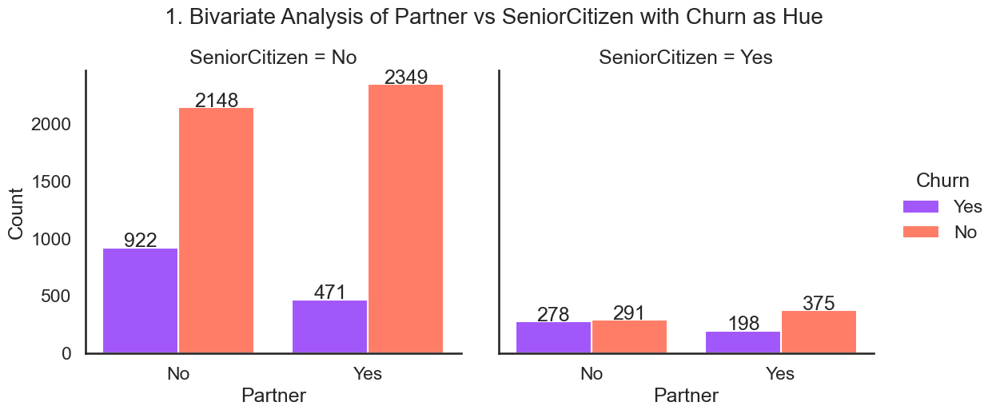

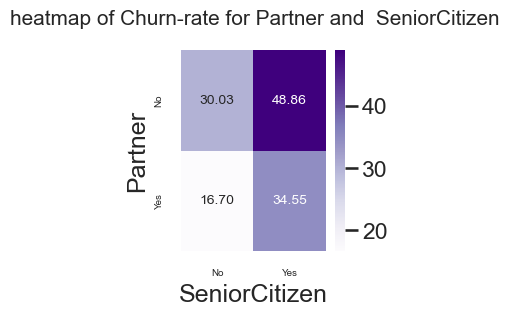

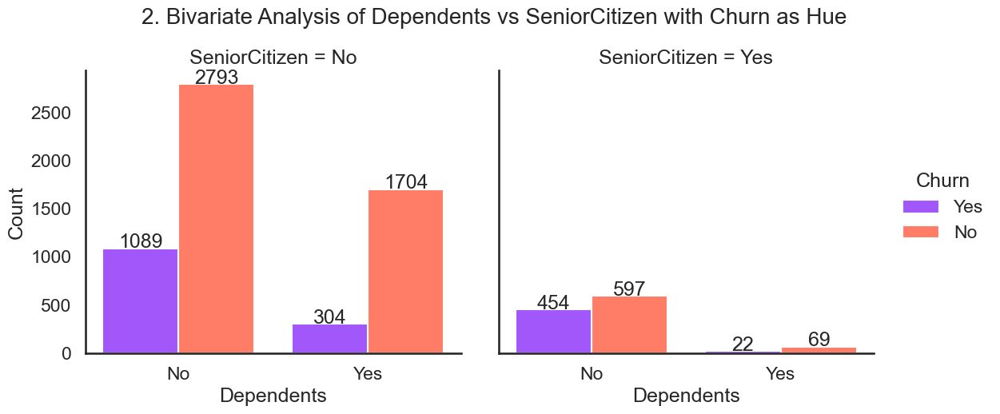

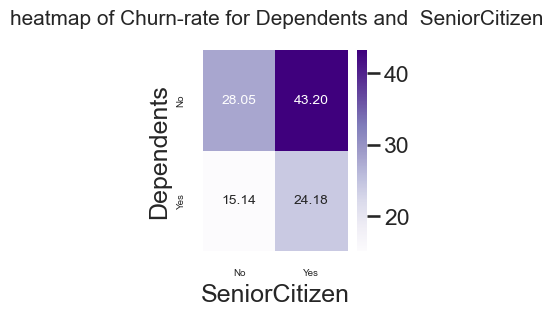

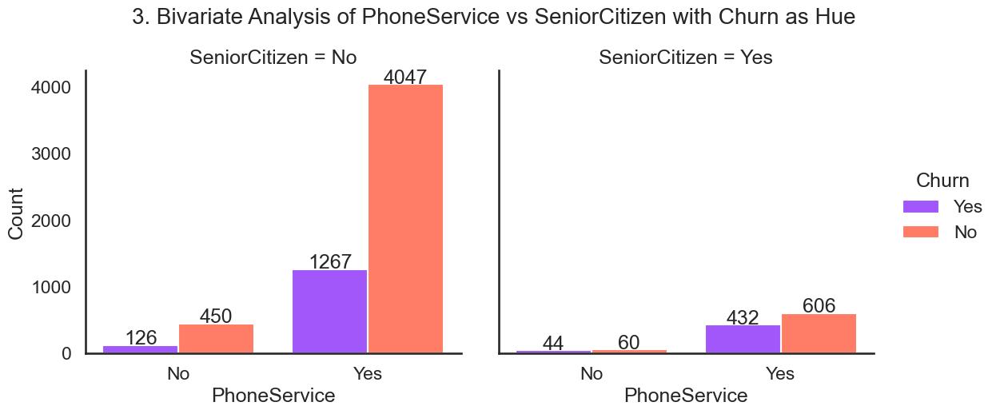

...

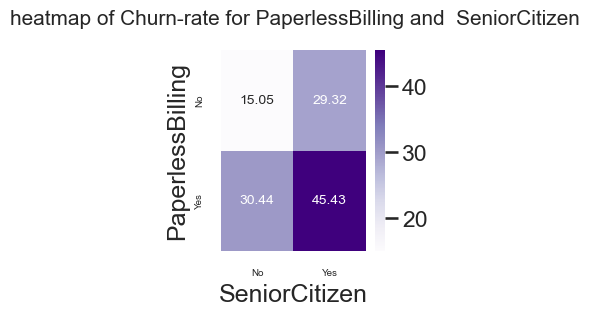

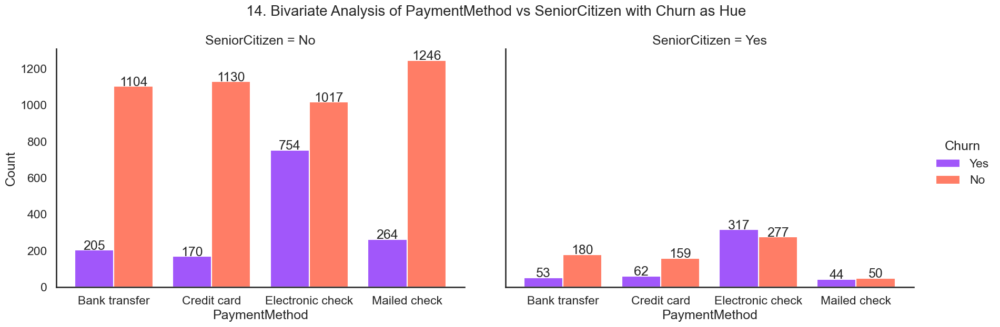

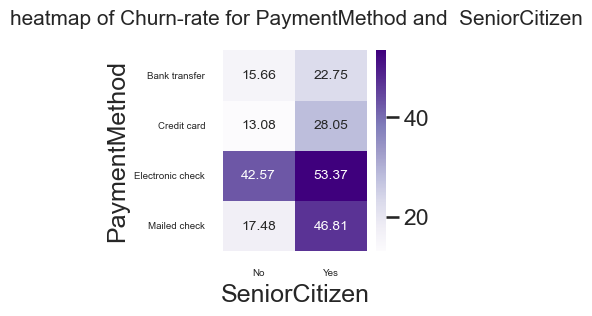

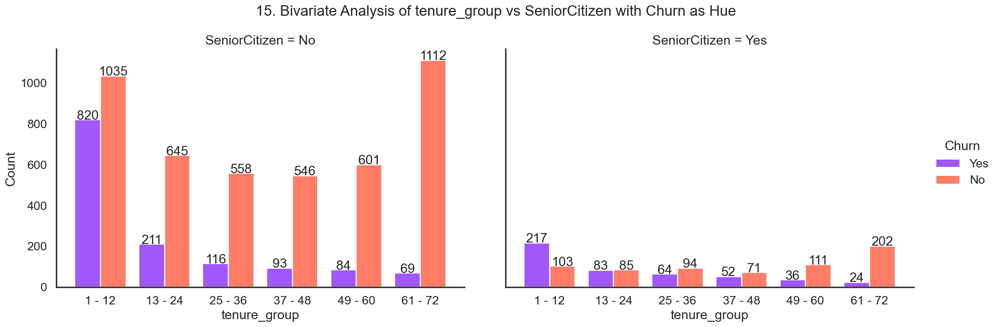

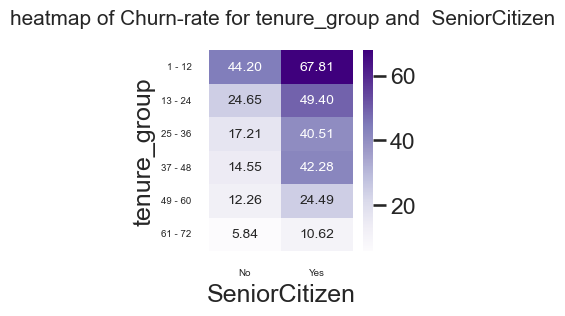

In [60]:
bivariate_plot(telco_data,'SeniorCitizen')

Insight:

1.Senior citizens with no partners are high churners with 48.8%. Non-senior customers with partners are low churners at 16.7%  

2. senior citizens with no dependents are high churners at 43.2%.. Non senior citizens with dependents are low churners at 15%

3.Senior citizens irrespective of their phone service are high churners with 42%

4.Senior citizens with no service are high churners at 42.3%. Senior citizens have no impact og multiple lines on them

5.senior citizen with fiber optic internet service are high churners at 47.2%.Non senior citizens without internet service are low churners at 7.3%

6. Senior citizens with no online security are high churners at 50.3%. Non-Senior citizens who have no internet connections are low churners at 7.3%

7. Senior citizens with no online backup are high churners at 52.7%. Non-Senior citizens who have no internet connections are low churners at 7.3%

8. Senior citizens with no Tech support are high churners at 50.6%. Non-Senior citizens who have no internet connections are low churners at 7.3%

9. Senior citizens with no Device Protection are high churners at 51.3%. Non-Senior citizens who have no internet connections are low churners at 7.3%

10. Senior citizens with no Streaming TV service are high churners at 46.7%. Non-Senior citizens who have no internet connections are low churners at 7.3%

11. Senior citizens with no Streaming Movies service are high churners at 46.7%. Non-Senior citizens who have no internet connections are low churners at 7.3%

12. Senior citizens with month-to-month contract are high churners at 54.6%.As the length of contract  customers  increases, the churn rate decreases. Non senior citizens have the lowest churn rate of 2.7% in 2 year contract.

13. Senior citizens with Paperless Billing option are high churners at 45.43%. Non seniors without Paperless billing option are low churners at 15%

14. Customers with Electronic check payment method are high churners.  Senior citizens with payment method as electronic check and mailed check are high churners at 53.37% and 46.81%. Non senior citizens with automatic credit card payment are low churners at 13%

15. Customers in 1-12 months tenure are high churners. Senior citizens are high churners in each tenure group. As tenure increases the churn rate of customers decreases with lowest churn rate of 5.84% being non senior citizens in 61-72 months tenure group.

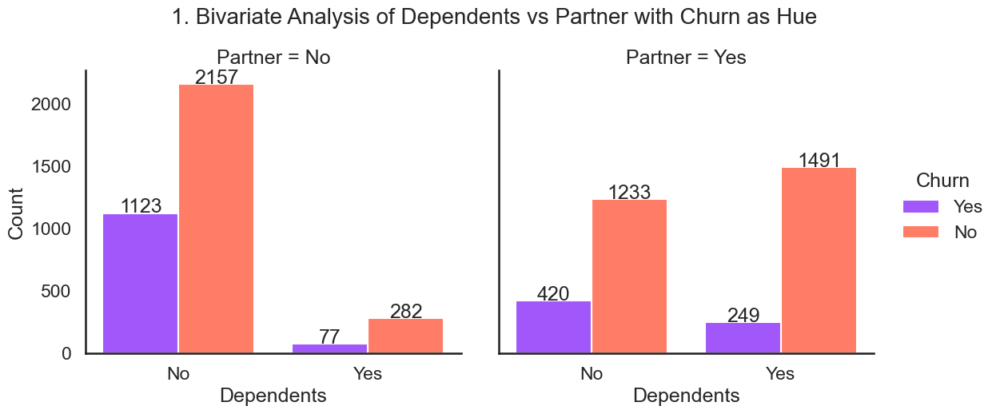

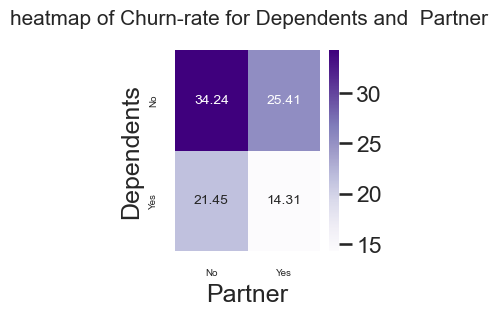

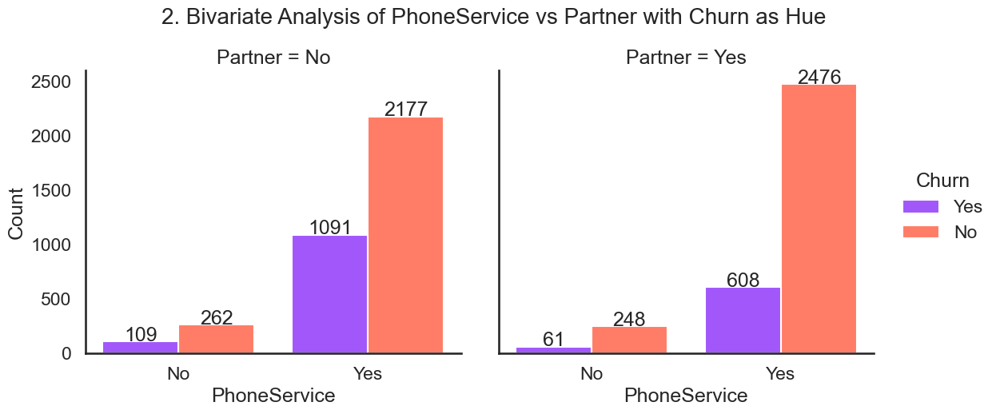

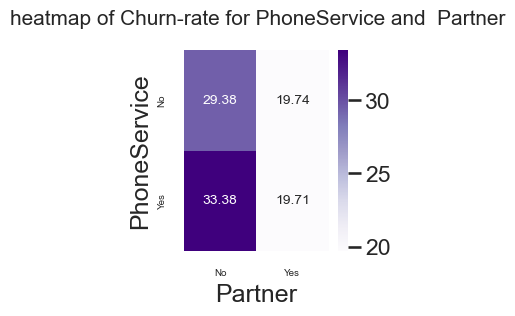

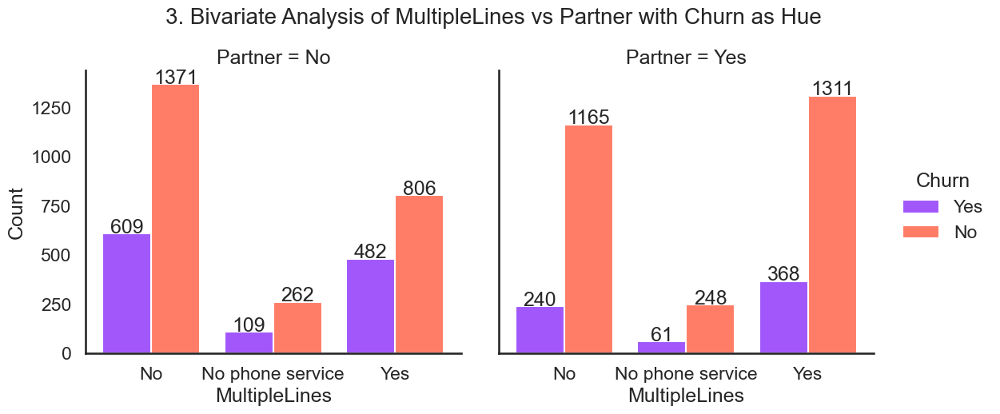

...

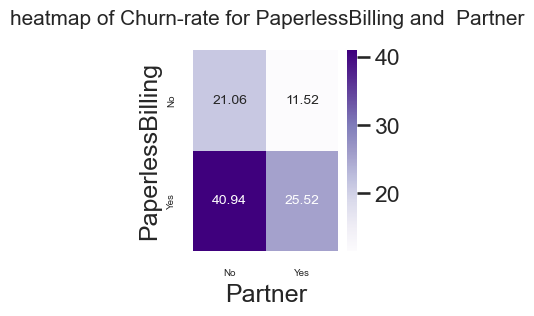

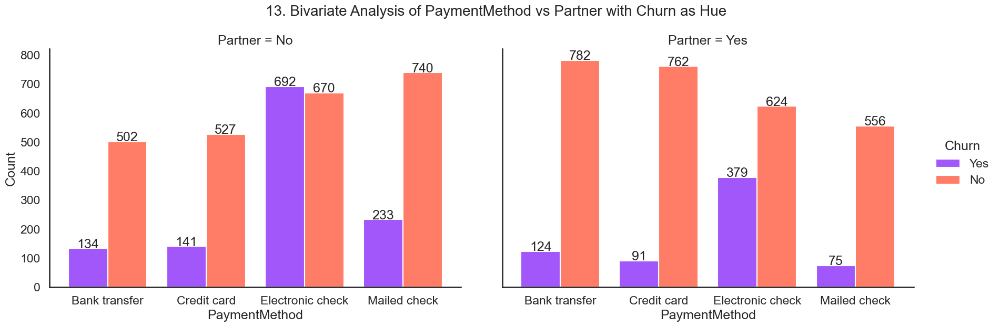

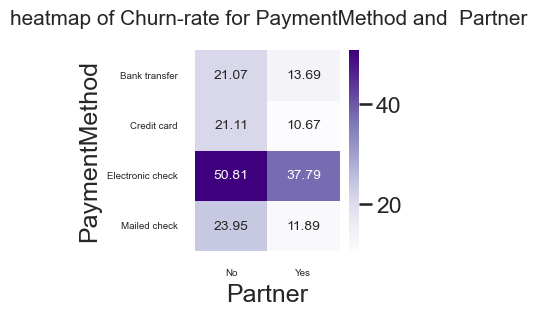

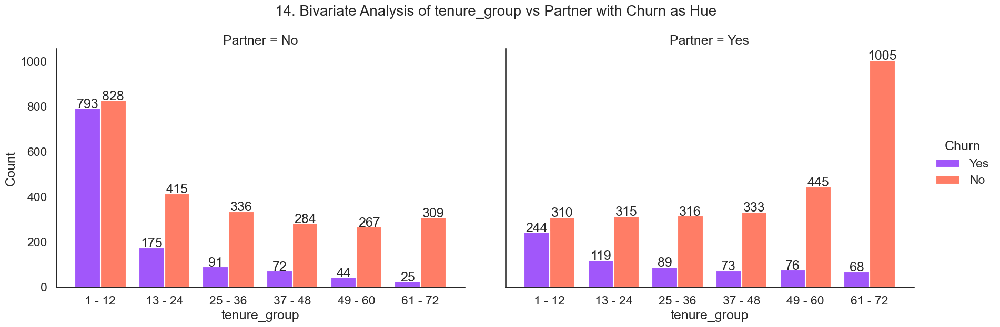

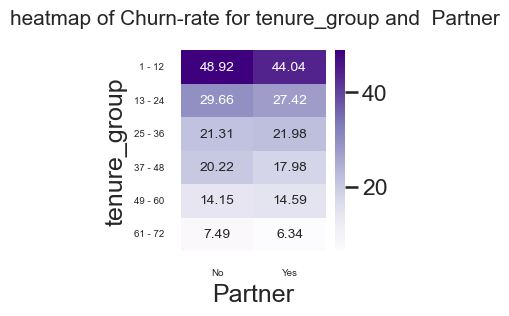

In [61]:
bivariate_plot(telco_data,'Partner')


Insight:

  1. Customers with no partners and no dependents are more likely to churn at 34.2%. Customers with partners and dependents are low churners at 14%

  2. Customers with no partners having  a phone service are high churners at 33.3%

  3. Customers with no partners and multiple lines are high churners with 37.42%. Customers with partner and no multiple lines are low churners at 17%

  4. Customers with Fiber optic internet service are high churners where customers with no partners at 49.6%  . Customers with a partner and no internet service are very low churners at 3.9%

  5. Customers with no partners and no online security are high churners at 47.1%. Customers with a partner and no internet service available are very low churners at 3.96%

  6. Customers with no partners and no online Backup are high churners at 45.2%. Customers with a partner and no internet service available are very low churners at 3.96%

  7. Customers with no partners and no Device Protection are high churners at 44.9%. Customers with a partner and no internet service available are very low churners at 3.96%

  8. Customers with no partners and no online Tech Support are high churners at 47.4%. Customers with a partner and no internet service available are very low churners at 3.96%

  9. Customers with no partners and no online Streaming TV are high churners at 39.04%. Customers with a partner and no internet service available are very low churners at 3.96%

  10. Customers with no partners and no Streaming Movies are high churners at 39.74%. Customers with a partner and no internet service available are very low churners at 3.96%

  11. Customers with no partners and month to month contract are high churners at 44.7%. Customers with a two-year contract are low churners.

  12. Customers with no partners and paperless Billing service are high churners at 40.94%. Customers with a partner and no paperless Billing service are low churners at 11.6%

  13. Customers with Electronic check service are high churners, with especially no partners at 50.84%. Customers with a partner and mailed check service are low churners at 11.8%.

  14. Customers in 1-12 tenure group are high churners, especially with no partners at 48.92%. Customers with a partner and in 61-72 months tenure are low churners at 6.3%



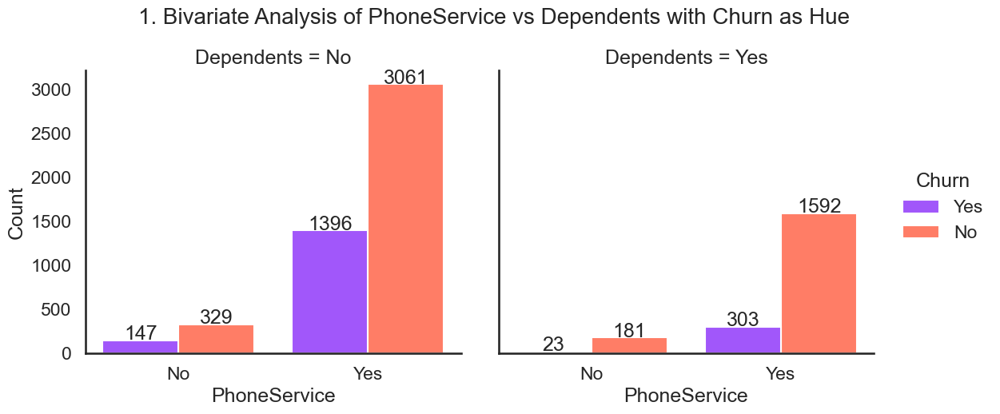

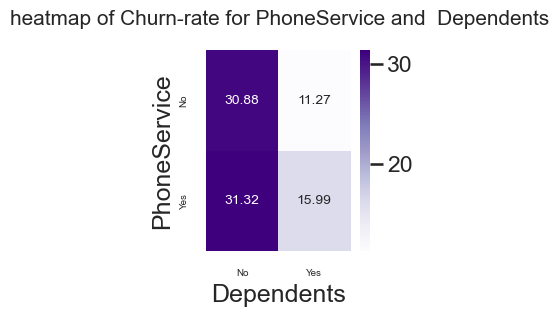

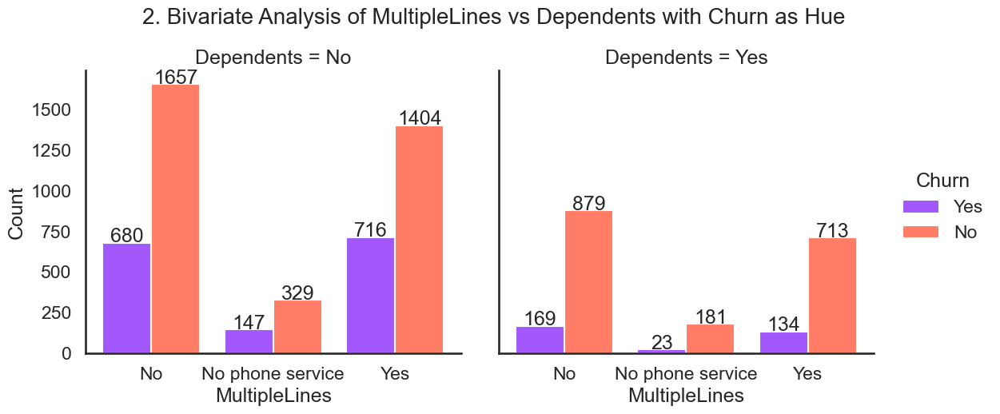

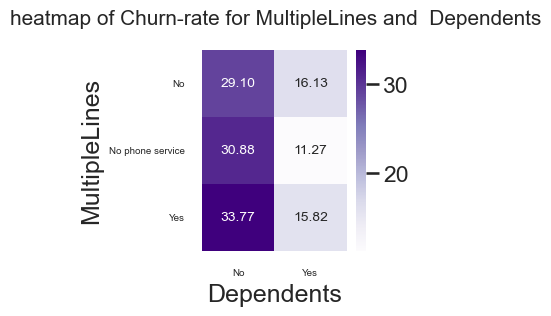

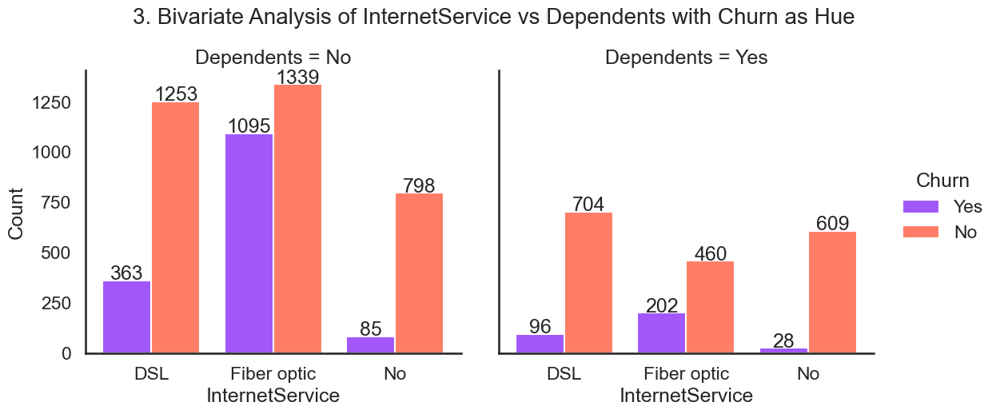

...

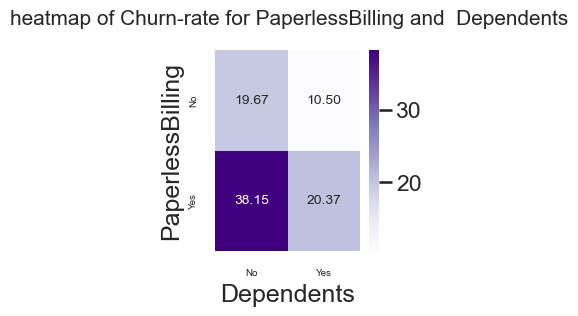

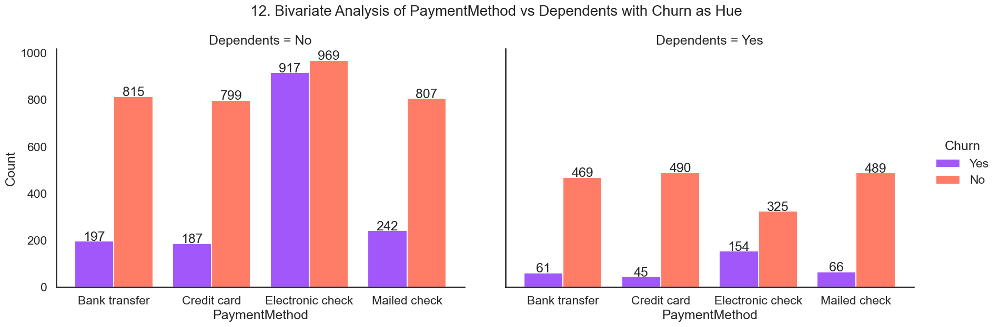

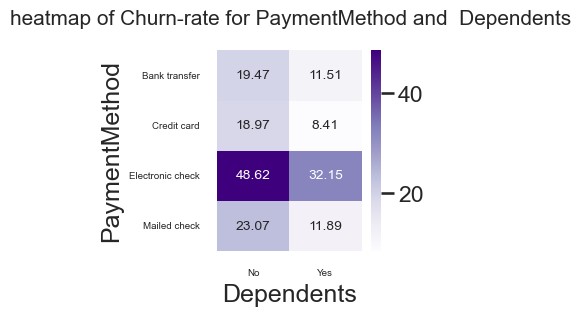

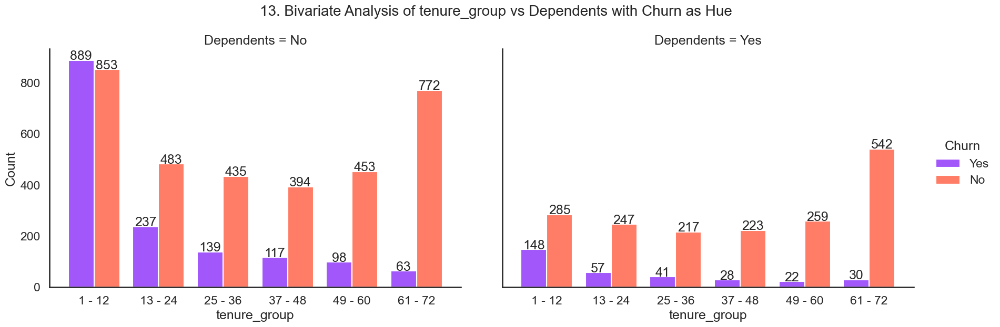

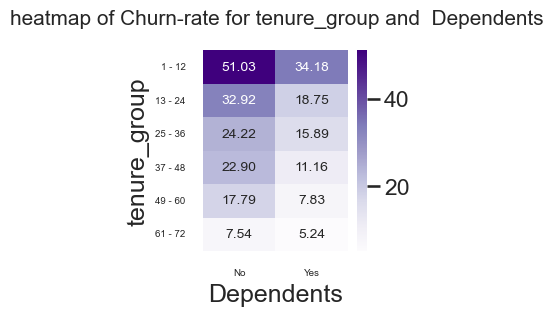

In [62]:
bivariate_plot(telco_data,'Dependents')

Insight:

1. Customers with no dependents are high churners. Customers with a dependent a no phone service are low churners at 11.2%

2. Customers with multiple lines and no dependents are high churners at 33.8. Customers with  dependents and no phone service are low churners at 11.2%

3. Customers with fiber Optic Internet service are high churners, especially with no dependents are at 45%. Customers with a no internet service and dependents are low churners at 4.4%

4. Customers with no Online Security are high churners, especially with no dependents are at 44.7%. Customers with a no internet service and dependents are low churners at 4.4%

  

5.  Customers with no Online Backup and with no dependents are at 43.4%. Customers with a no internet service and dependents are low churners at 4.4%

6.  Customers with no Device protection and no dependents are at 43%. Customers with a no internet service and dependents are low churners at 4.4%

7.  Customers with no Tech Soupport and no dependents are at 45%. Customers with a no internet service and dependents are low churners at 4.4%

8.  Customers with no dependents and with and without a streaming TV service are high churners at  37% and 34.86% respectively  . Customers with a no internet service and dependents are low churners at 4.4%

9. Customers with no dependents and with and without a streaming Movies service are high churners at  37.5% and 34.83%  respectively  . Customers with a no internet service and dependents are low churners at 4.4%

10. Customers  in month to month contract are high churners, especially those with no dependents at 45.2%. Customers in 2 year contract are low churners especially those with partners at 2.3%

11.  Customers with no dependents and a paperless billing service are high churners at 38.15% where as customers with a dependents and no paperless Billing service are low churners at 10.5%

12. Customers with electronic check payment and no dependents are high churners at  48.6% whereas customers with a dependent and credit card payment are low churners at 8.4%

13. Customers with dependents in 1-12months and 12-24 months tenure are high churners  at 51.03% and 33%  .Customers with dependents in 1-12 months tenure are high churners at 34%. Customers in 61-72 month tenure are low churners.

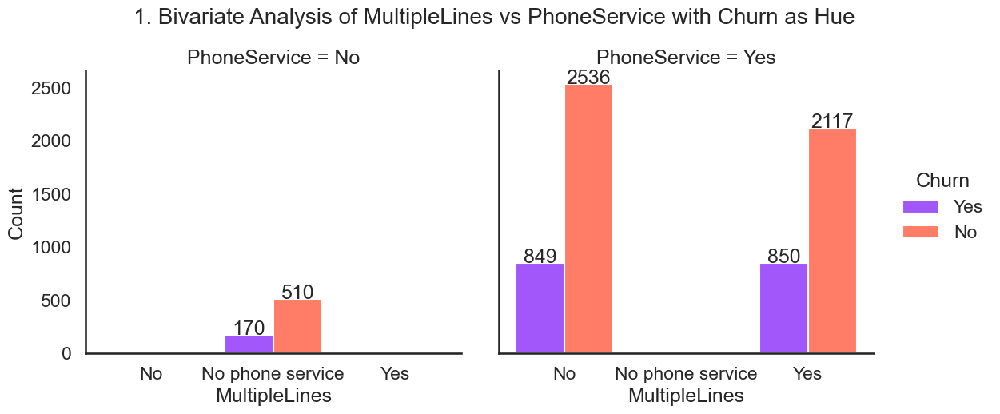

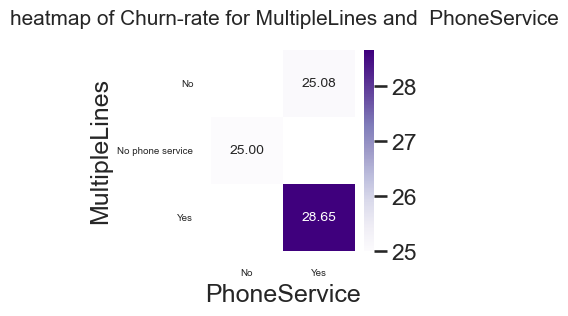

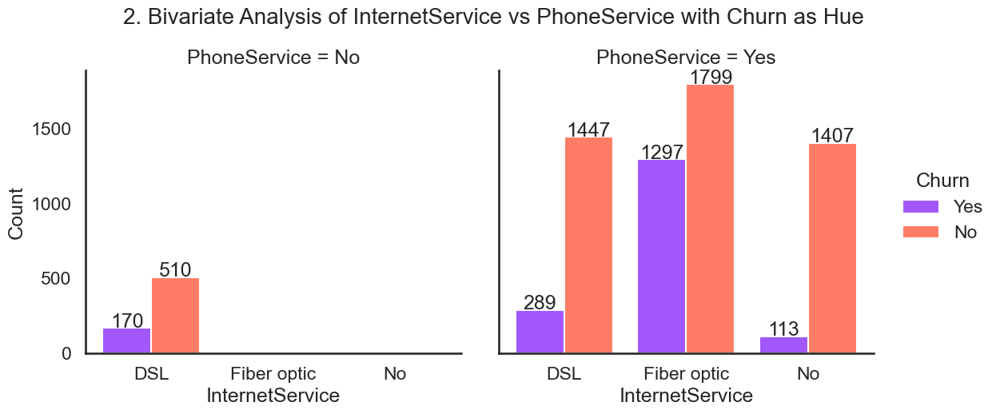

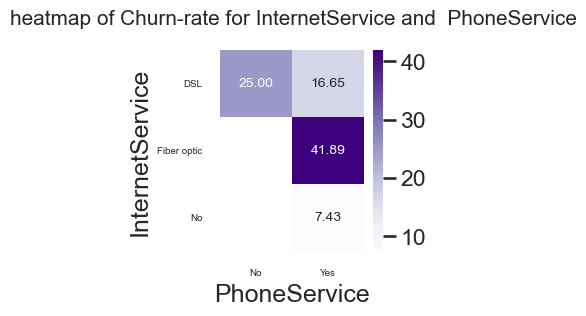

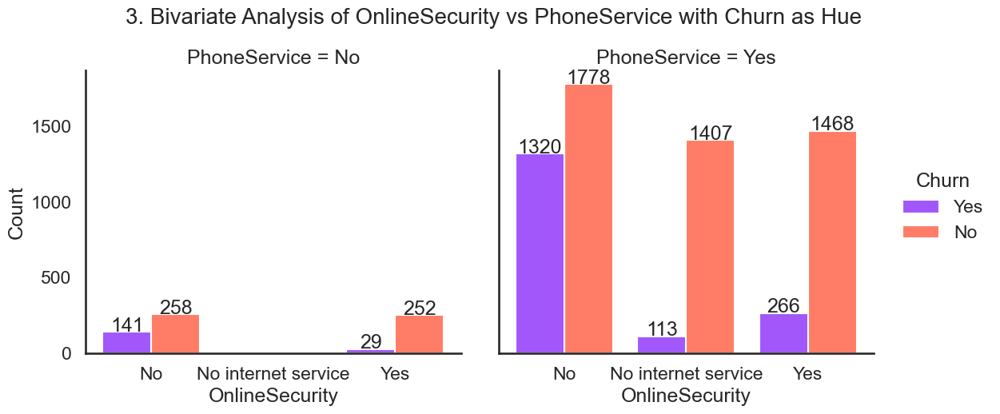

...

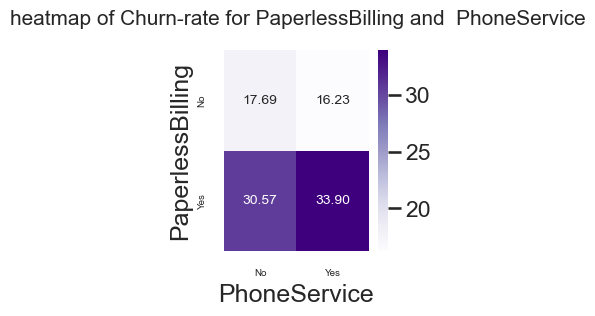

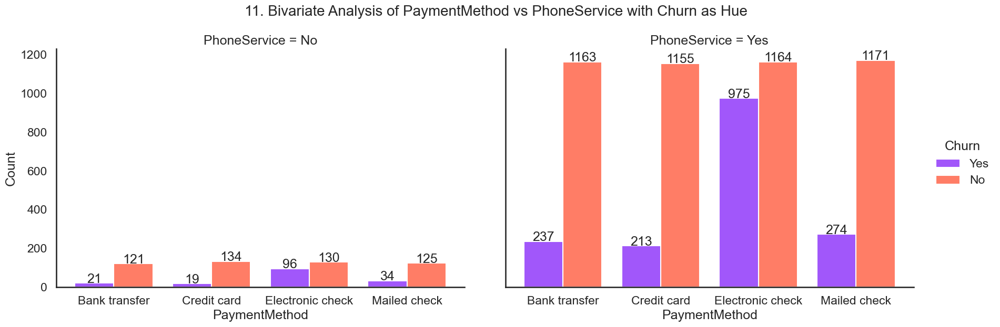

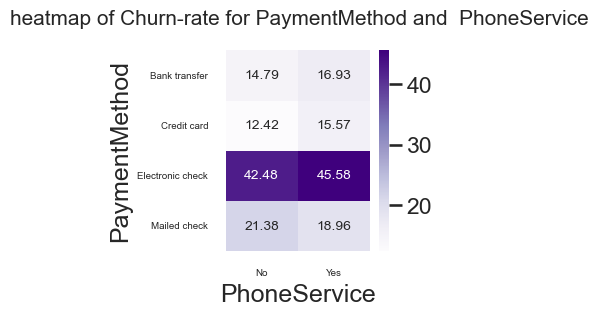

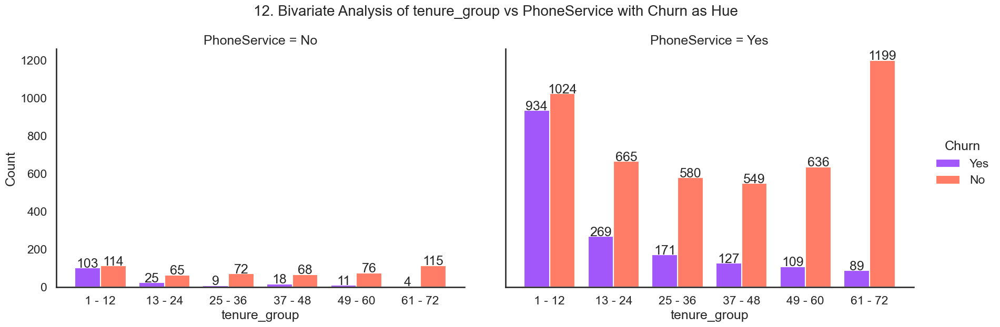

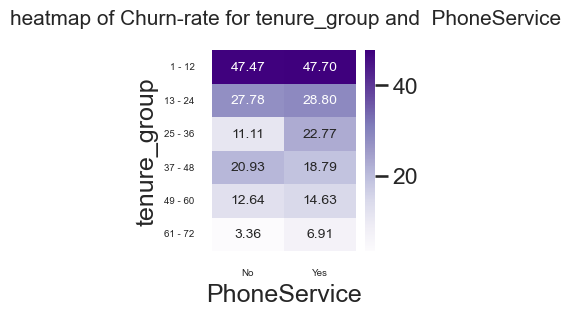

In [63]:
bivariate_plot(telco_data,'PhoneService')

Insight:
1. Customers having phone service with and without multiple lines are high churners at 28% and 25%. Customers with no phone service are low churners.



2. Customers with phone service and a fiberoptic internet service are high churners at 41.89%. Customers with no phone service and DSL internet service are high churners at 25%  . Customers with a phone service but no internet connection are low churners at 7%.

3. Customers with No Online security are high churners especially the one with a phone service at 42.6%. Customers without  internet service are low churners.  

4. Customers with No Online Backup are high churners especially the one with a phone service at 41.36%. Customers without  internet service are low churners.

5. Customers with No Device protection are high churners especially the one with a phone service at 40.12%. Customers without  internet service are low churners.

6. Customers with No Tech Support are high churners especially the one with a phone service at 42.36%. Customers without  internet service are low churners.



7. Customers with and without Streaming TV  service are high churners especially the one with a phone service at 34.6%. Customers without  internet service are low churners.



8. Customers with and without Streaming Movies service are high churners especially the one with a phone service at 34.6%. Customers without  internet service are low churners.

9. Customers having a month to month contract are high churners especially the one with a phone service at 43%. Customers without  internet service are low churners. Customers in two year contract are low churners especially without phone service at 1.89%

10. Customers without  a paperless Billing option are low Churners. Customers with a paperless billing option are high churners especially with a phone service 34%.

11. Customers with Electronic mail check are high churners especially with a phone service at 45.5%. Customers with no phone service and a credit card payment method are low churners at 12.4%.

12. Customers in 1-12 and 13-24 tenure are high churners with 47% and 27% churn rate.The churn rate decreases gradually as  tenure increases with lowest churn rate at 61-72 tenure especially for those without a phone service at 3.36%

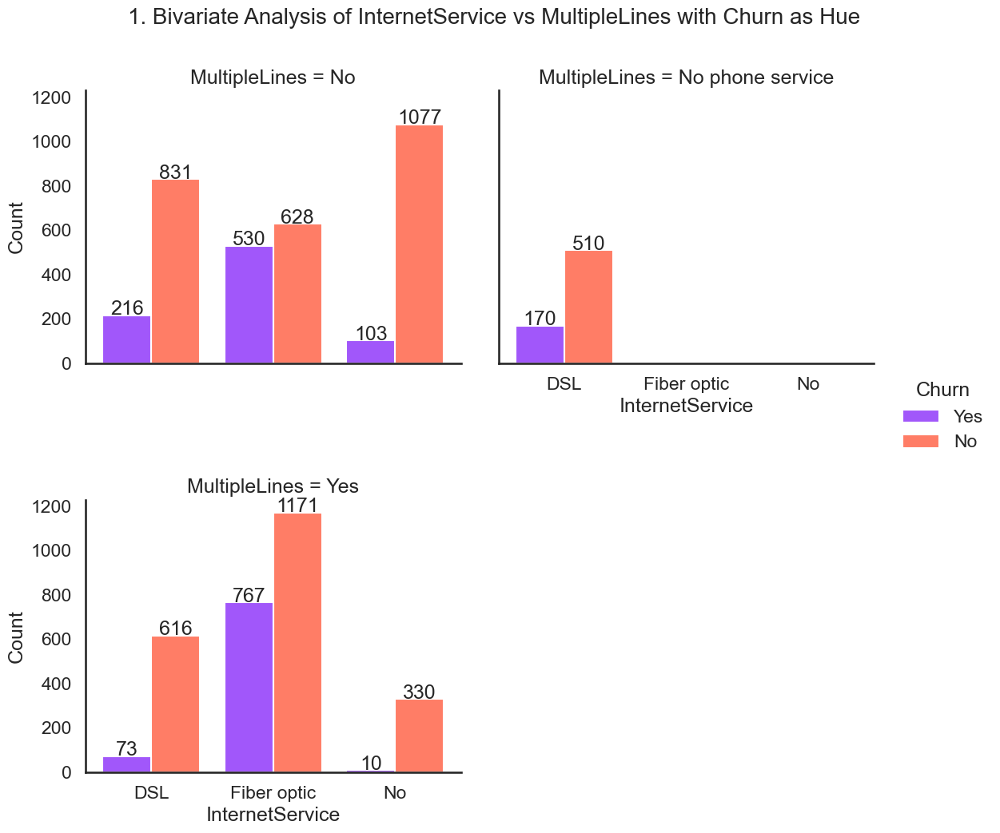

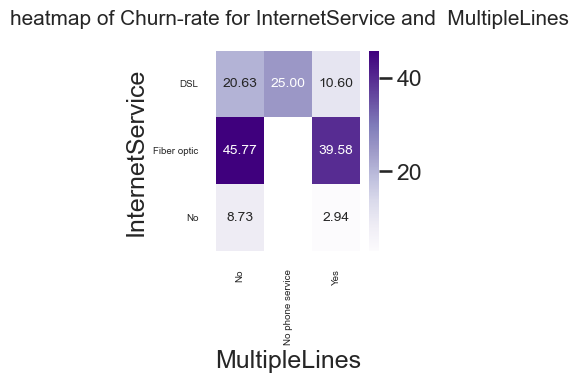

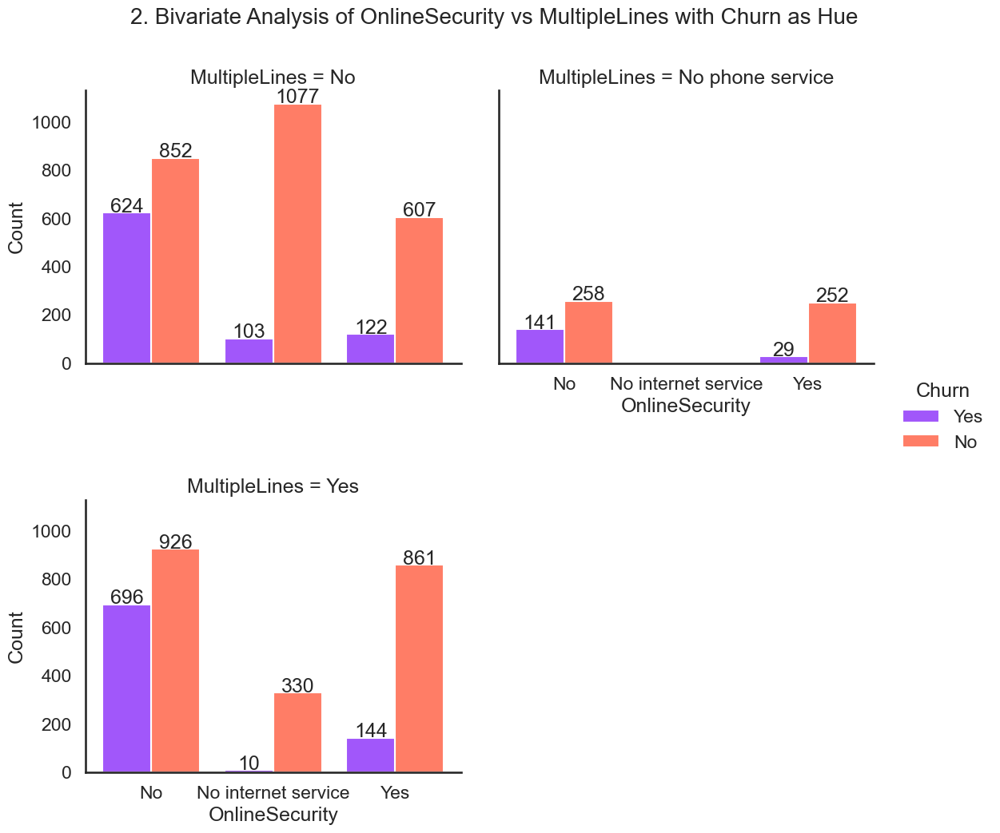

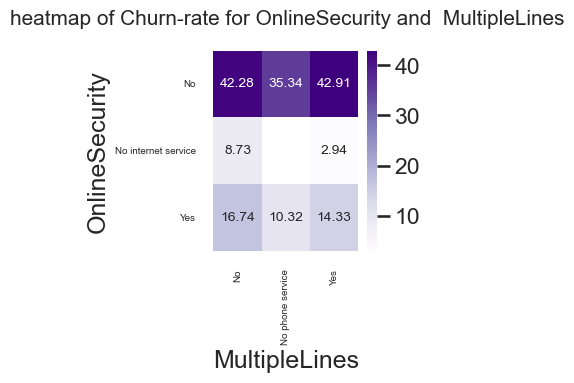

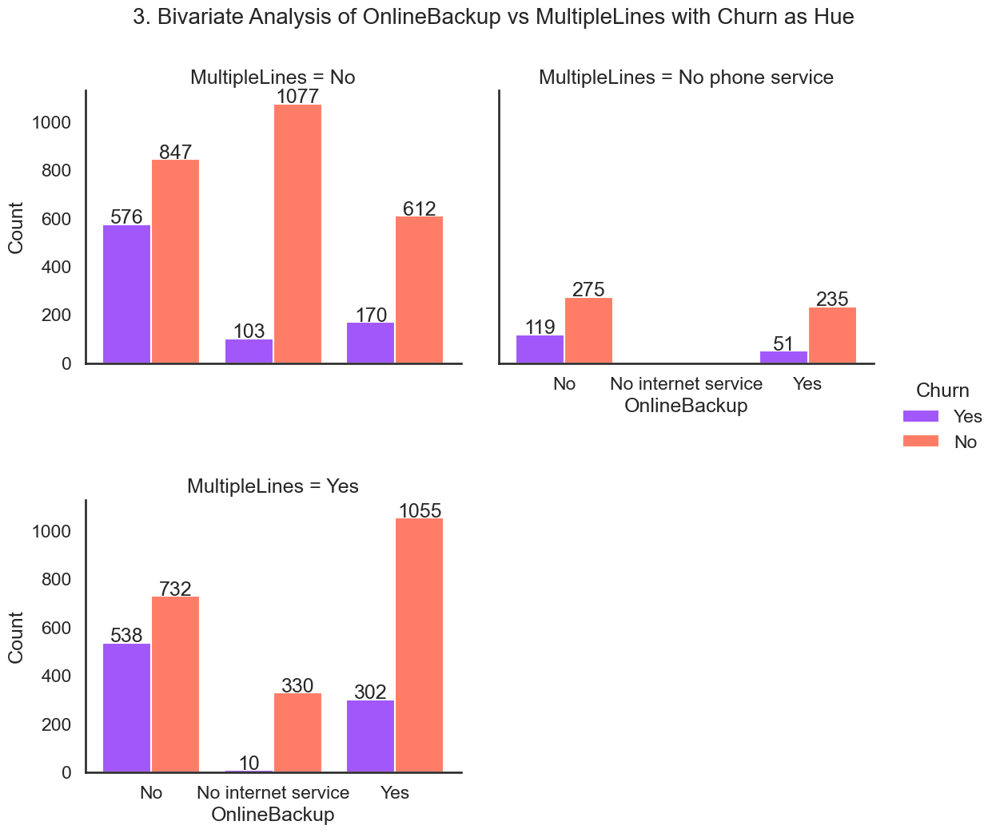

...

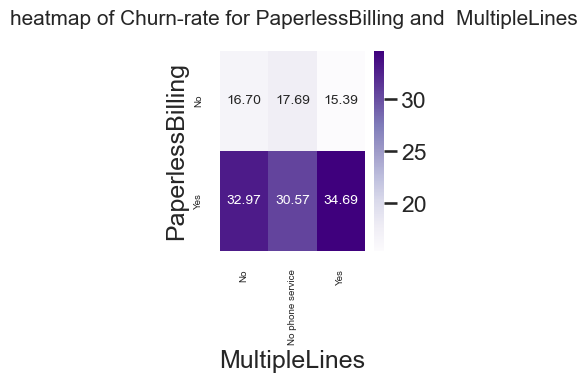

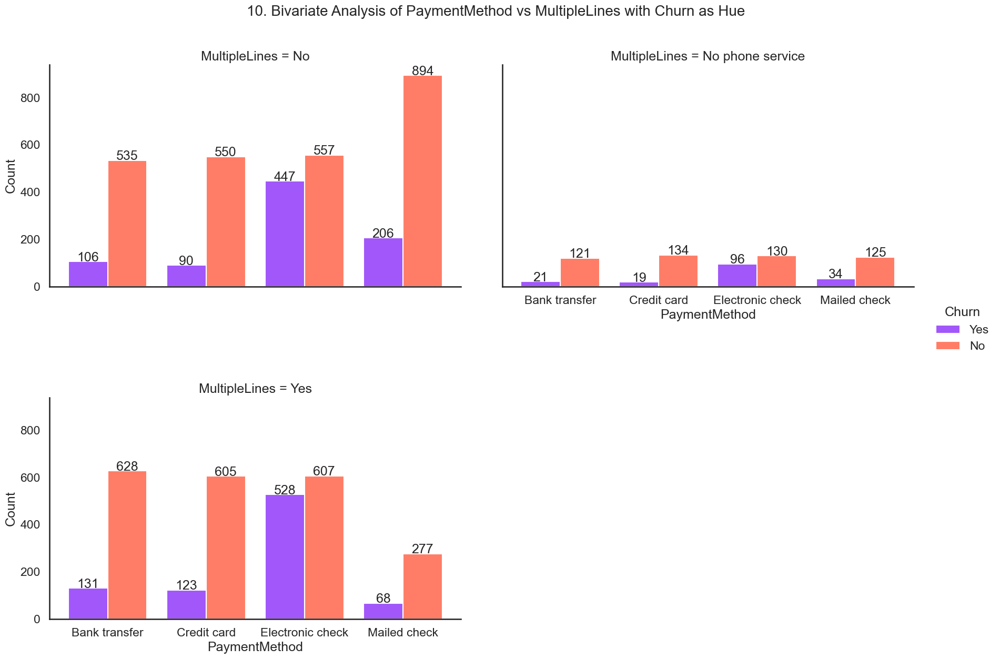

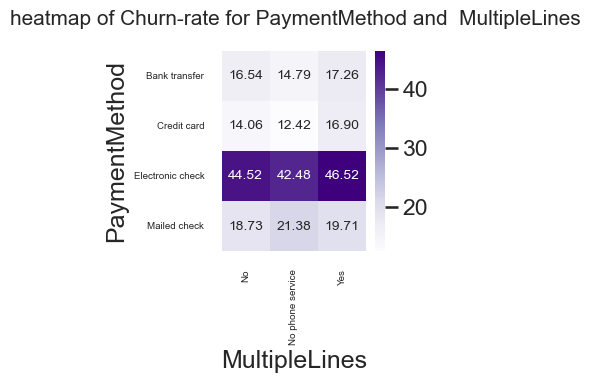

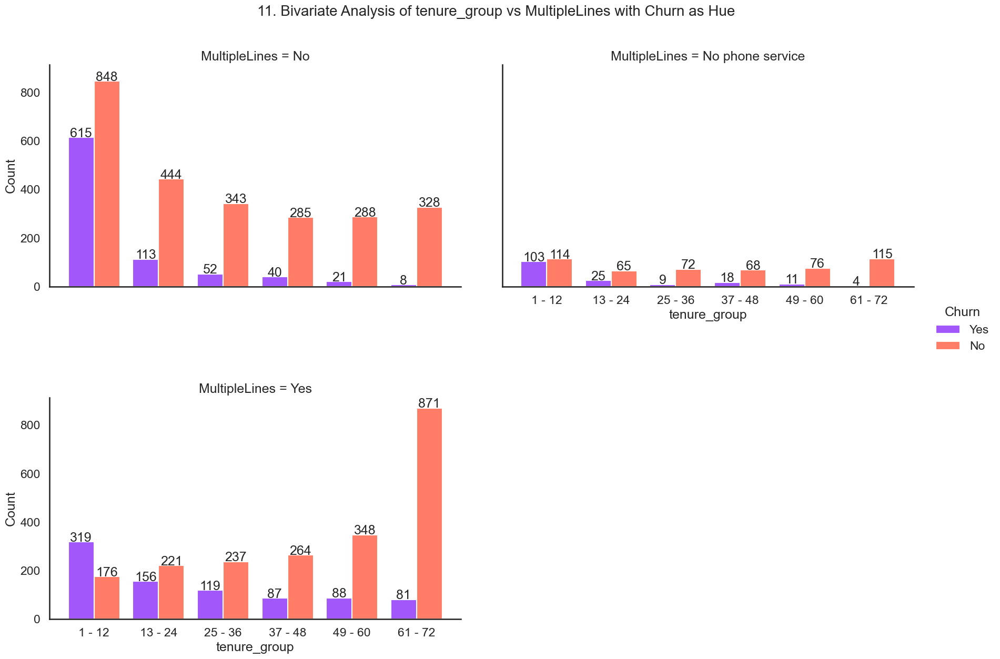

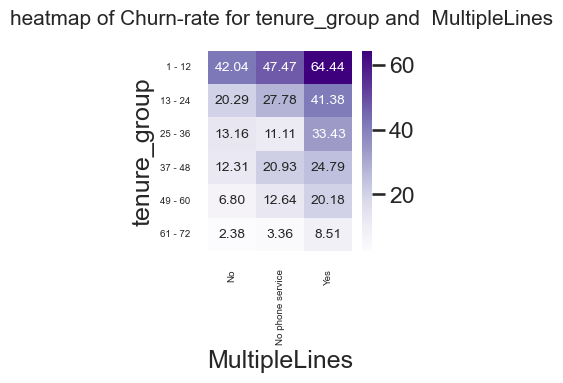

In [64]:
bivariate_plot(telco_data,'MultipleLines')


Insight:
1. Customers with Fiber Optic internet service are high churners especially with and without multiple lines at 39.5 and 45.7% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

2. Customers with No Online Security service are high churners especially with   multiple lines at 42.9% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

3. Customers with No Online Backup service are high churners especially with   multiple lines at 42.3% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

4. Customers with No Device Protection service are high churners especially with   multiple lines at 40.8% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

5. Customers with No Tech Support service are high churners especially with   multiple lines at 42.7% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

6. Customers with and without Streaming TV service are high churners especially with no multiple lines at 34.9% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

7. Customers with and without Streaming Movies service are high churners especially with no multiple lines at 36.17% churn rate. Customers with no internet service are low churners with lowest at 2.9% for those with multiple lines.

8. Customers with one-to-one contract are high churners, especially highest at 48.72% for those with multiple lines. Customers with two-year contract are low churners especially without multiple lines at 1.52%

9. Customers with Paperless billing option are high churners especially highest at 34.7% for those with multiple lines. Customers with without paperless billing option are low churners.

10. Customers with Electronic check payment option are high churners especially highest at 46.5% for those with multiple lines. Customers without phone service and a credit card option are low churners at 12%.

11. ustomers in 1-12 tenure group are high churners especially for those with multiple lines at 64%. As tenure increases, churn rate decreases with lowest without multiple lines at 2.38%



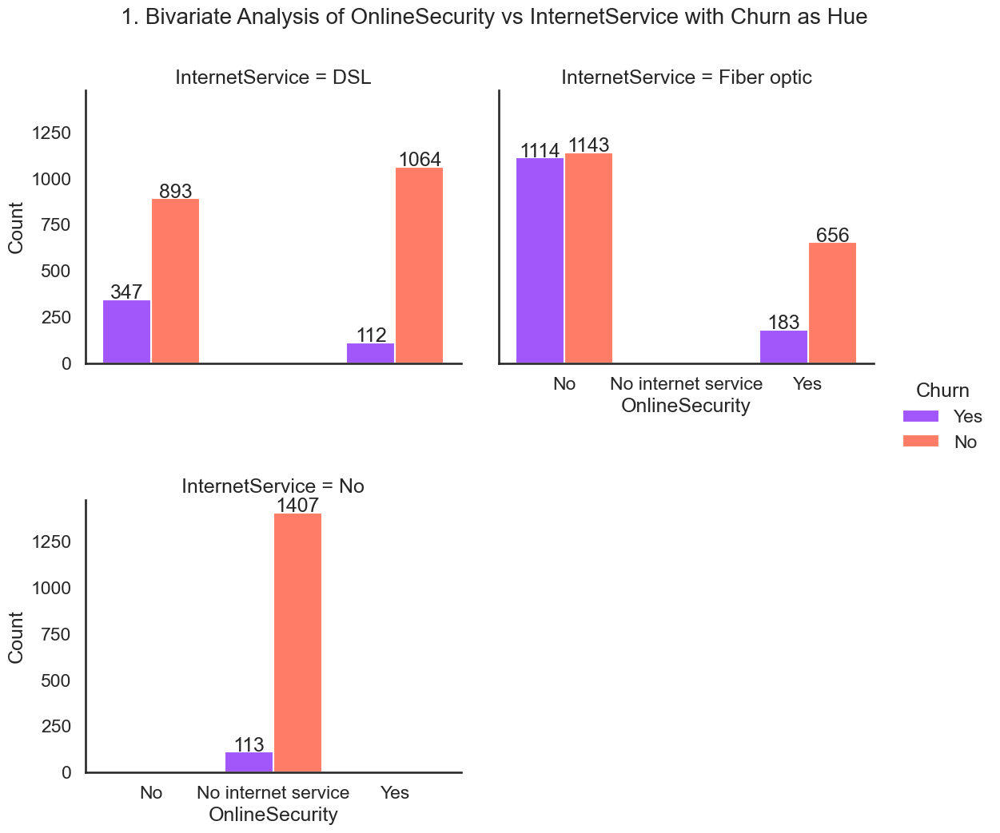

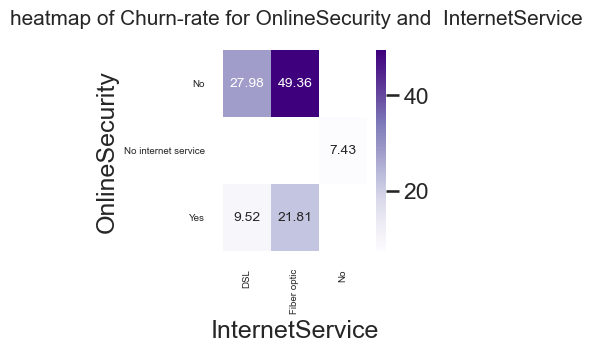

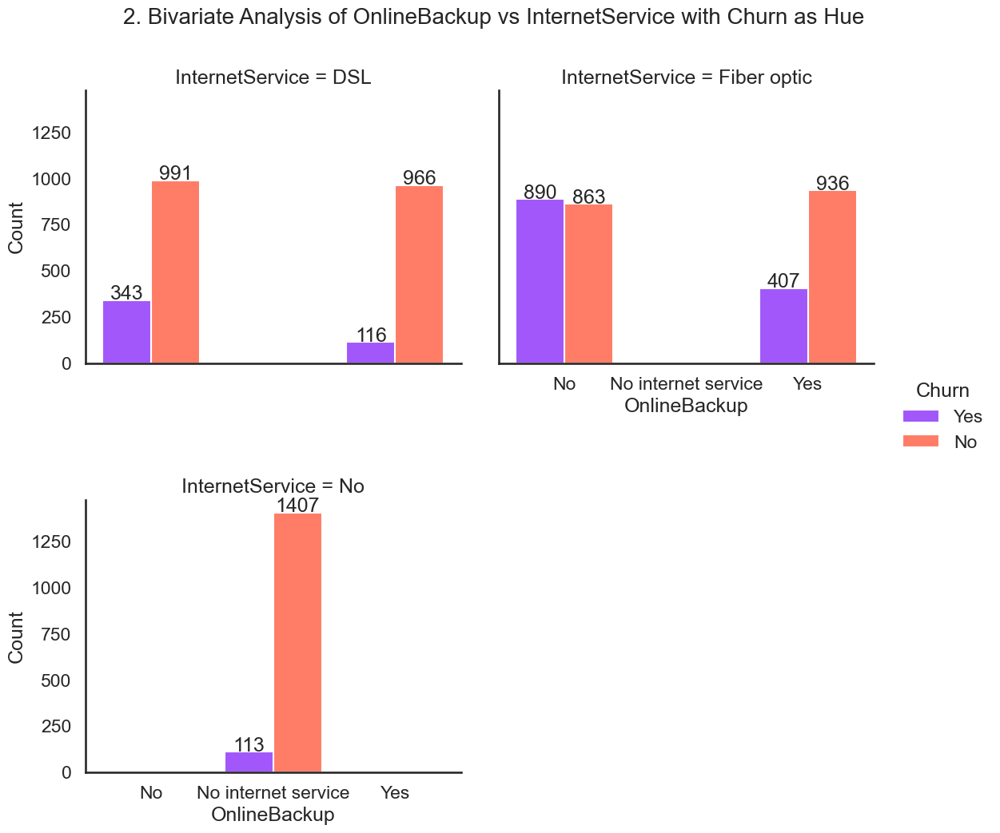

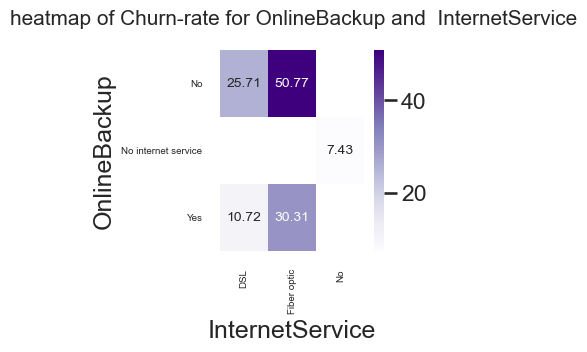

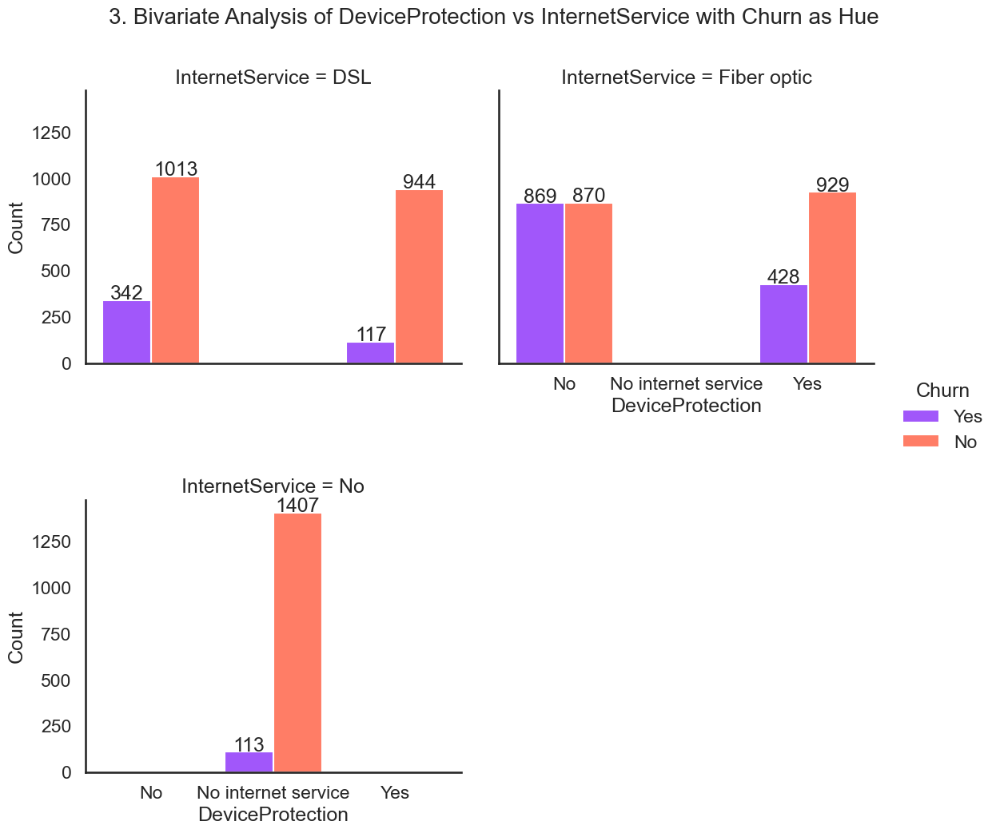

...

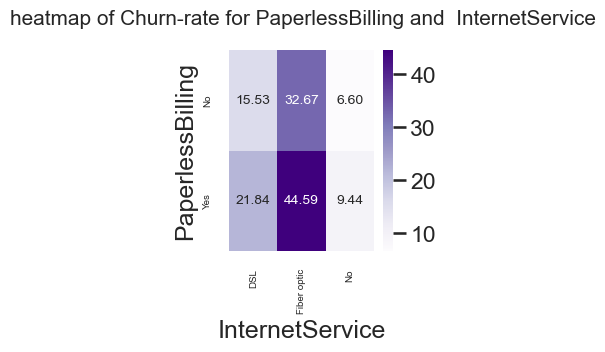

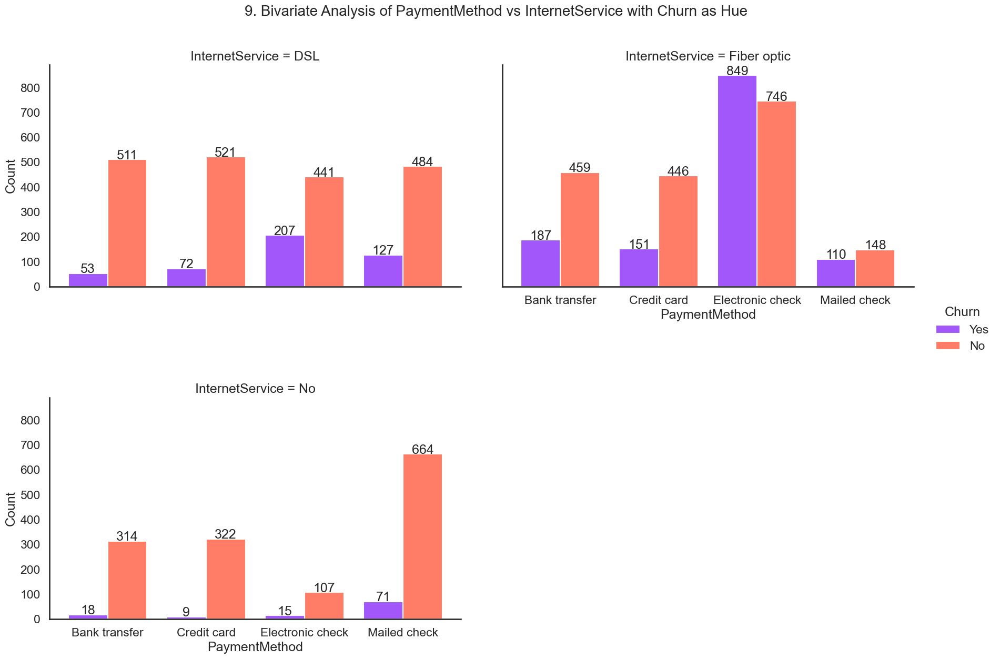

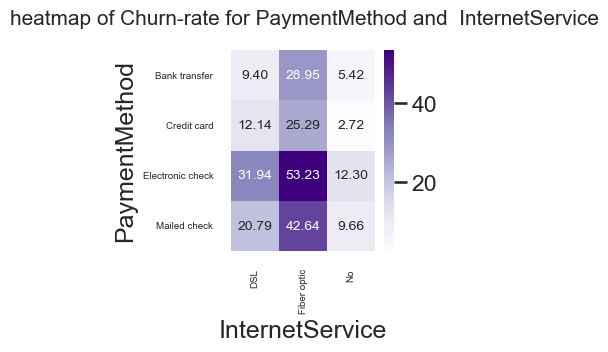

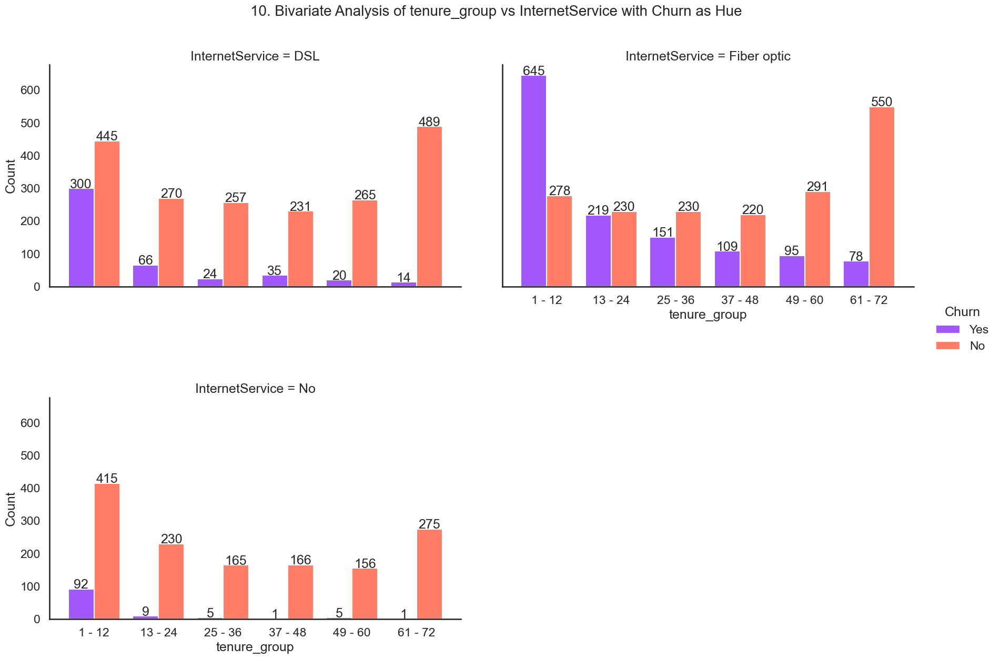

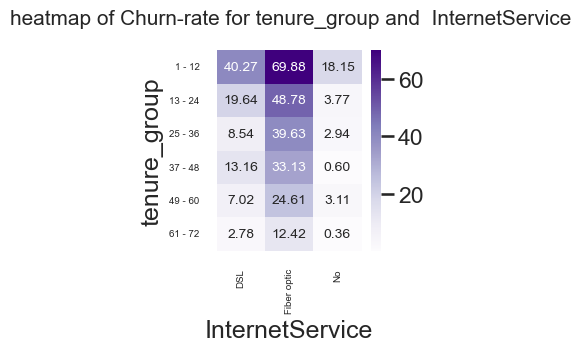

In [65]:
bivariate_plot(telco_data,'InternetService')

Insight:

1.Customers with fiber optic internet and no online security are high churners at 49.3%Customers with no online security and no internet service are low churners

2.Customers having fiber optic internet , no online back up and online back up are high churners at 50.7% and 30.3% respectively.

3.Customers having fiber optic internet , no device protection and with device protection are high churners at 49.97% and 31.53% respectively.

4.Customers having fiber optic internet and DSL, with no Tech Support are  high churners at 49.37% and 27.78% respectively.

5.Customers having fiber optic internet, with and without Streaming TV service are high churners at 45.32% and 39.26% respectively.

6.Customers having fiber optic internet, with and without Streaming Movies service are high churners at 45.82% and 38.8% respectively.

7.Customers with Fiber optic internet service and month-to-month contract are high churners at 54.6%. Customers with DSL internet and month-to-month contract are high churners at 32.2%. Customers with two-year contract are low churns, the lowest being 0.79% for no internet service  

8.Customers with Fiber optic internet and with and without paperless billing service are high churners at 44.59% and 32.67% respectively. Customers with no internet service and no paperless billing option are low churners at 6.6%.

 9.Customers with Fiber optic internet and electronic check and mailed check payment options are high churners at 53.23% and 42.64% respectively. Customers with no internet service and credit card payment option are low churners at 2.7%

10.Customers with Fiber optic internets service are churners in  1-12, 13-24, 25-36 and 37-48 months tenures with the highest at  69.8%. Customers with DSL internet service are high churners at 40.2% in 1-12 month tenure group.   As tenure increases the churn rate decreaes and is the lowest at0.36 % for the tenure 61-72 months and no internet service. Surprisingly, there is a 5% increase in churn rate from 25-36 tenure to 37-48 tenure for customers using DSL internet service.

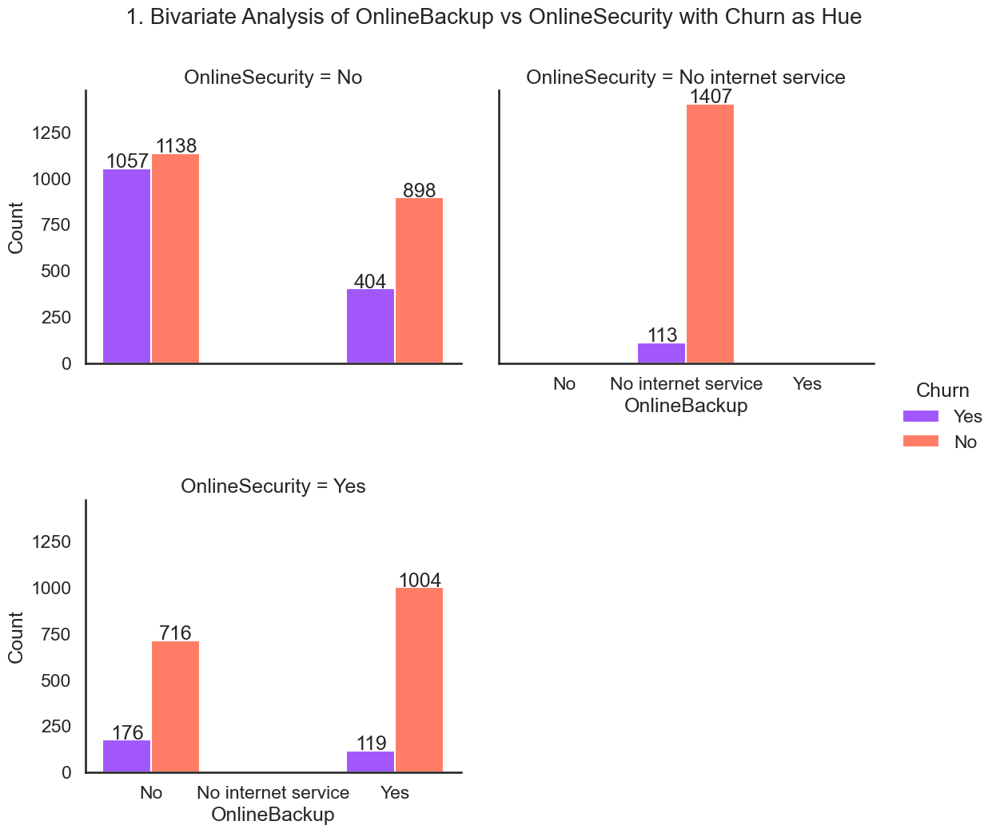

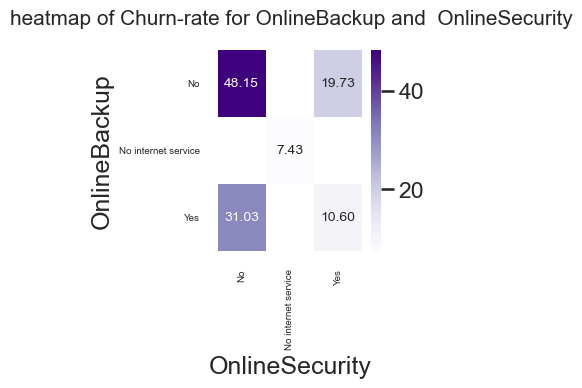

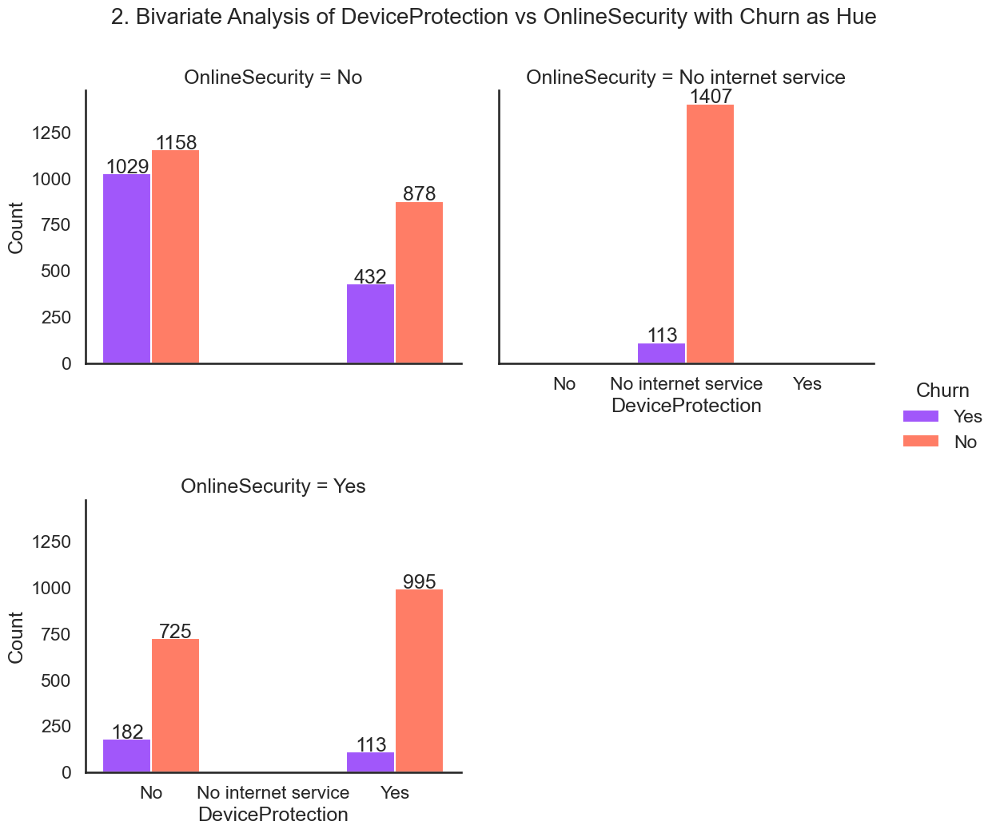

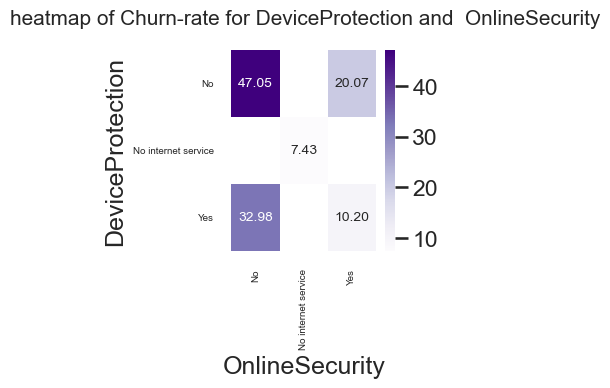

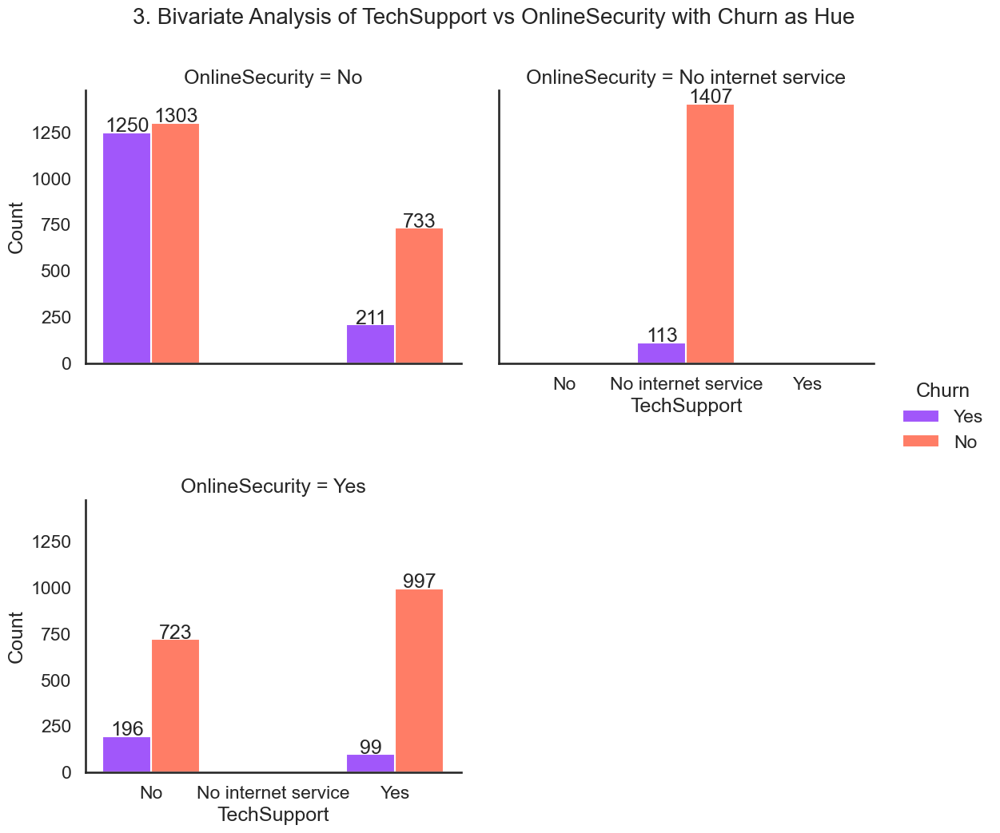

...

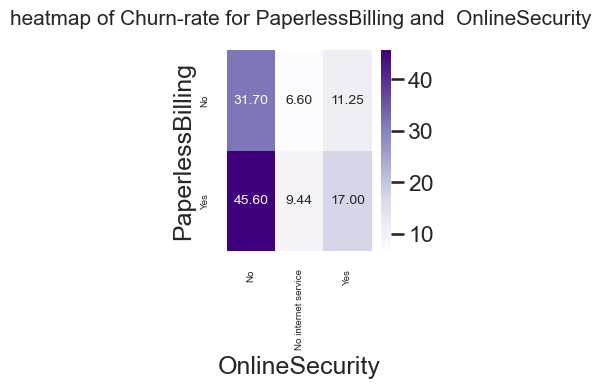

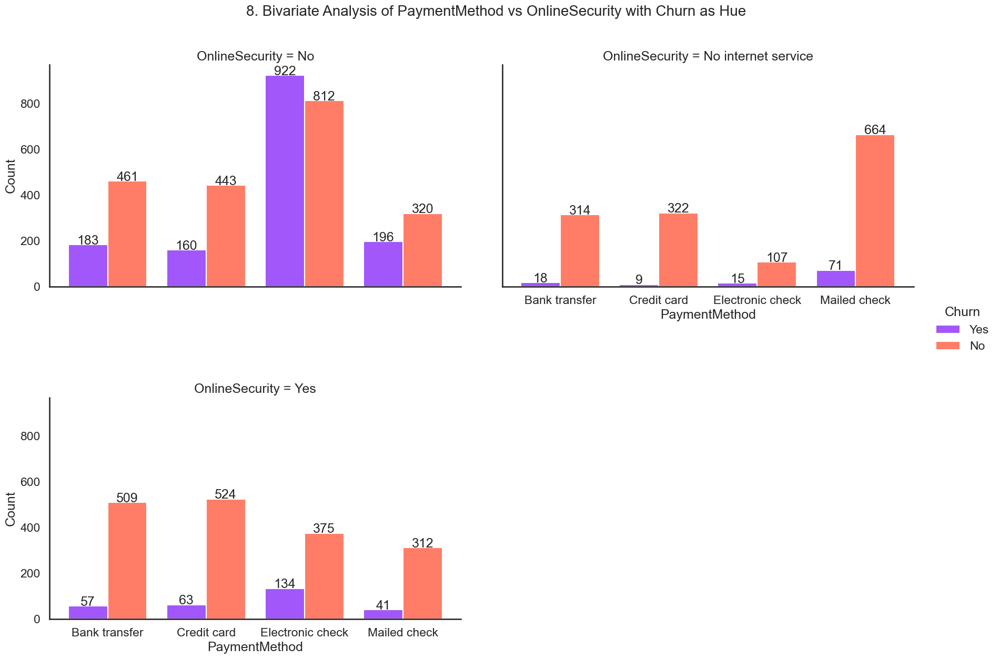

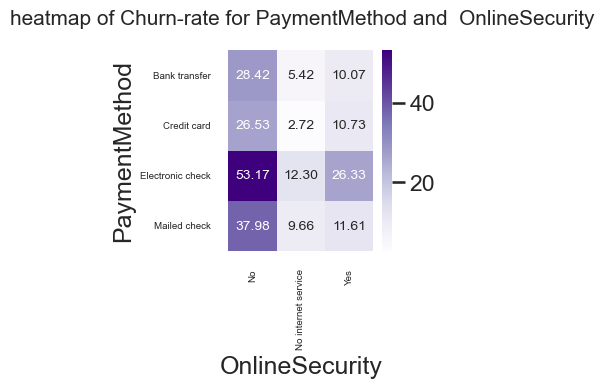

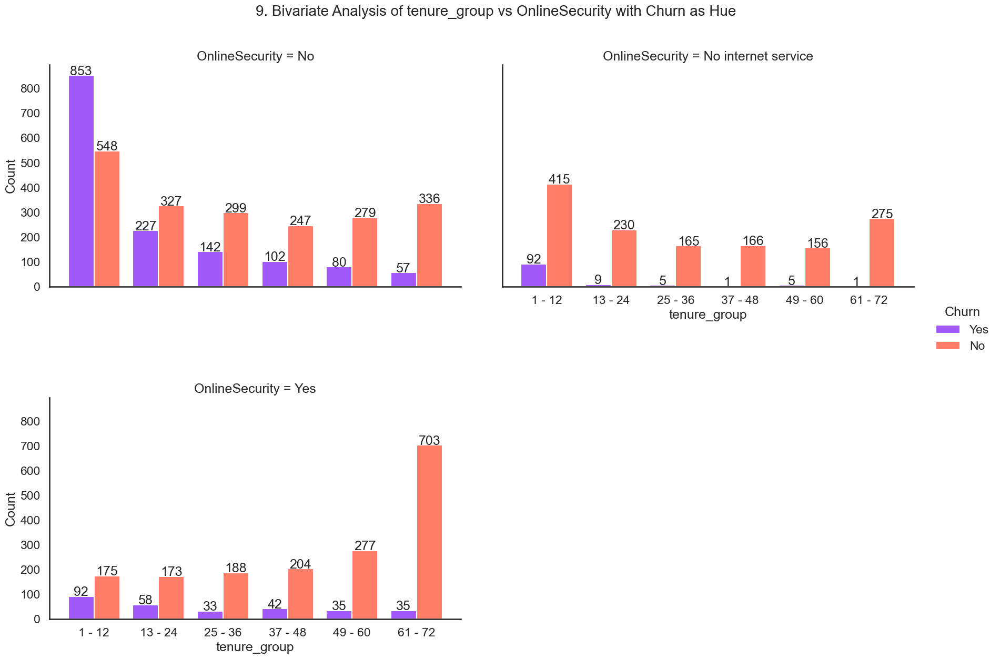

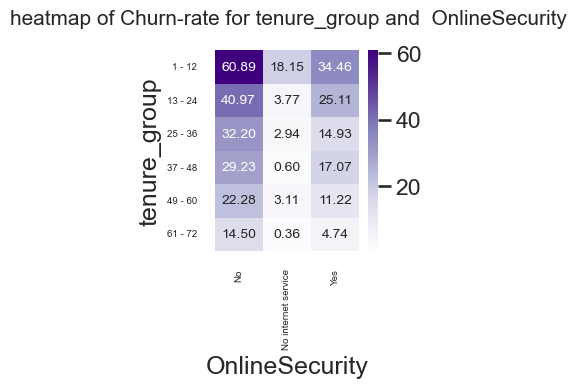

In [66]:
bivariate_plot(telco_data,'OnlineSecurity')

Insight:

1.Customers with no online security, with and without online backup service are high churners at 48.15% and 31.03%. Customers without internet service were low churners at 7.43%

2. Customers with no online security,  with and without Device Protection  service are high churners at 33% and 47.05% .

3. Customers with no online security,  with and without Tech Support service are high churners at 22.3% and 48.95%.

4. Customers with no online security,  with and without Stream TV service are high churners at 40% and 43.37%.

5.  Customers with no online security,  with and without Stream Movies service are high churners at 40.47% and 43%.

6. Customers having a month to month contract, with and without online security are high churners at 29.5% and 51.05% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

7. Customers with no online security,  with and without Paperless Billing service are high churners at 45.6% and 31.7%. Customers with no internet service and no paperless billing option are low churners at 6.6%

8. Customers with no online security,  with Electronic  and mailed check payment methid are high churners at 53.17% and 37.9%.Customers with no internet service and credit card payment method are low churners at 2.72%

9. Customers with no online Security and belonging to 1-12,13-24,25-36,37-48 tenure groups are high churners. Customers with no internet service are low churners. Customers with Online security and 1-12 tenure group are high churners with 34.46%.





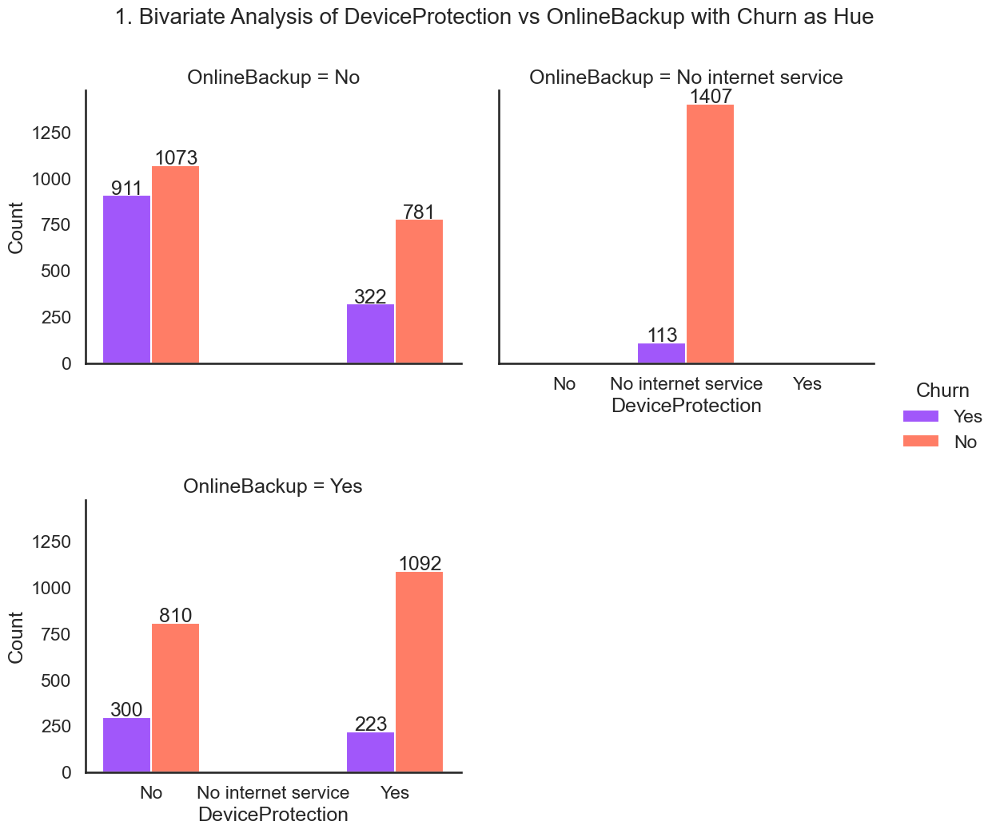

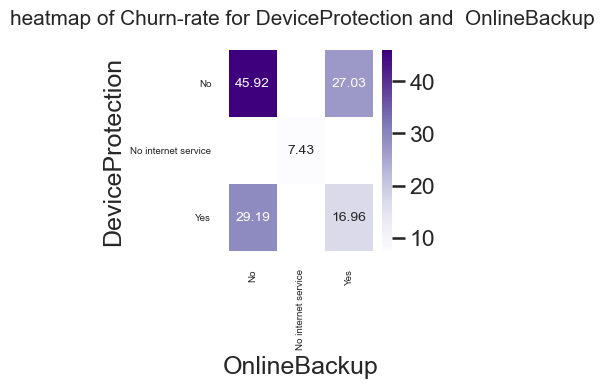

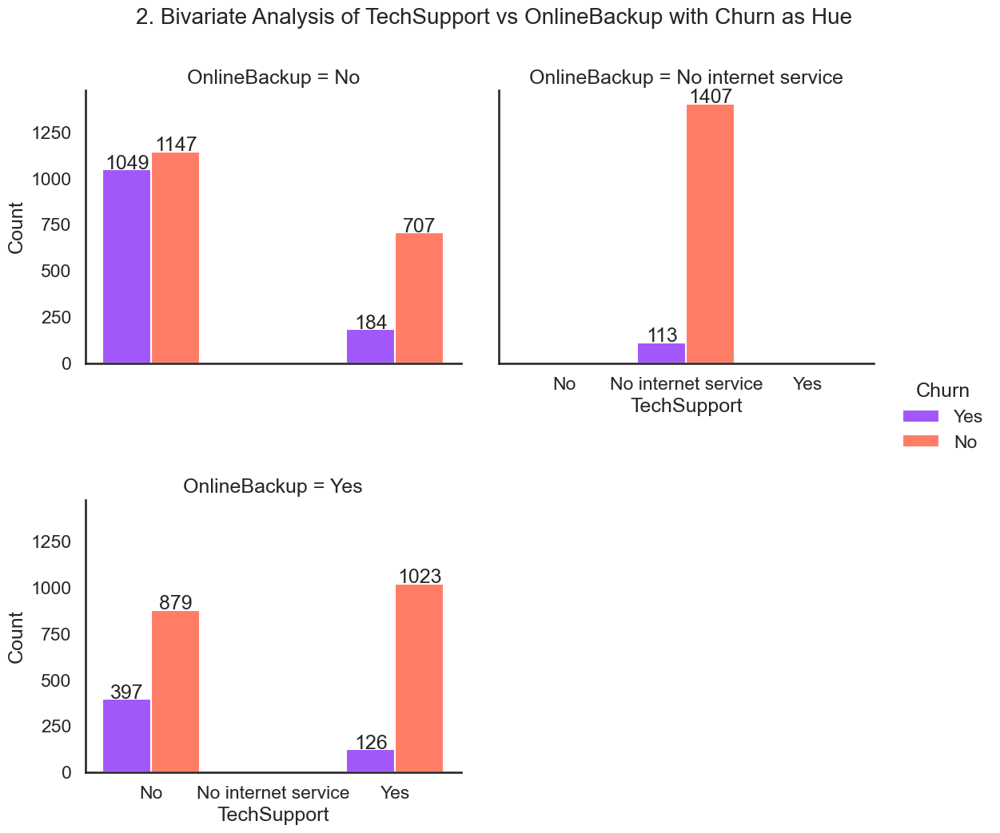

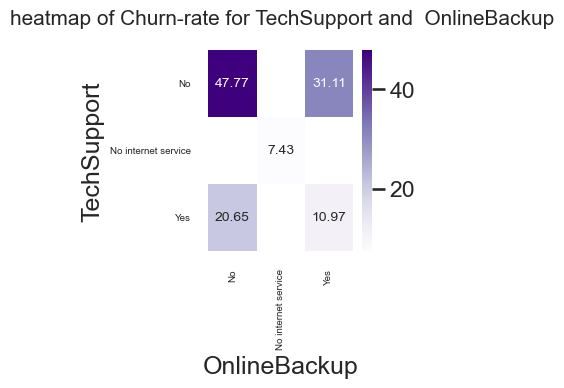

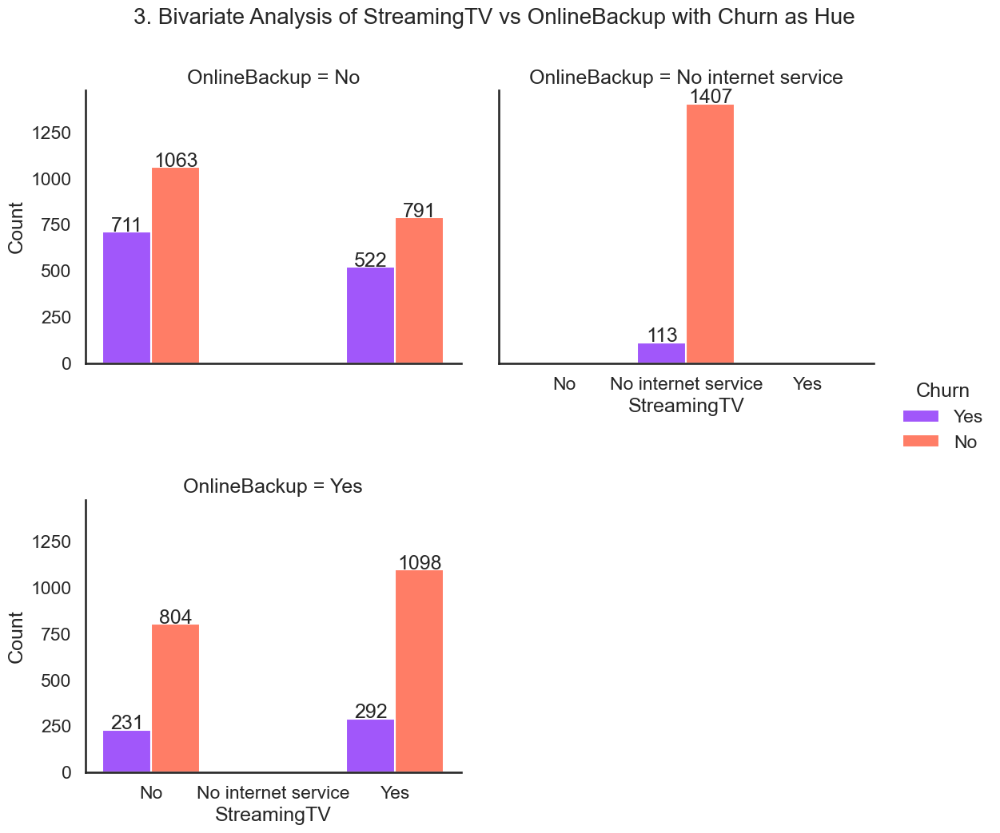

...

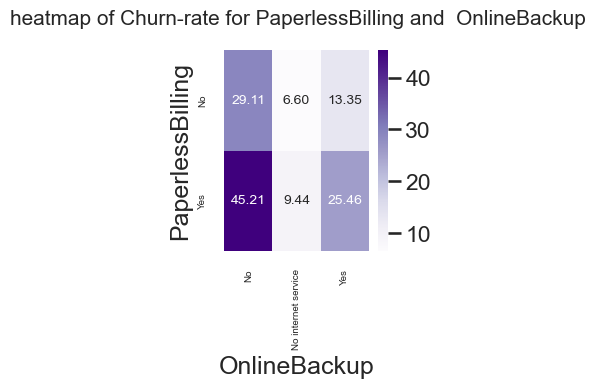

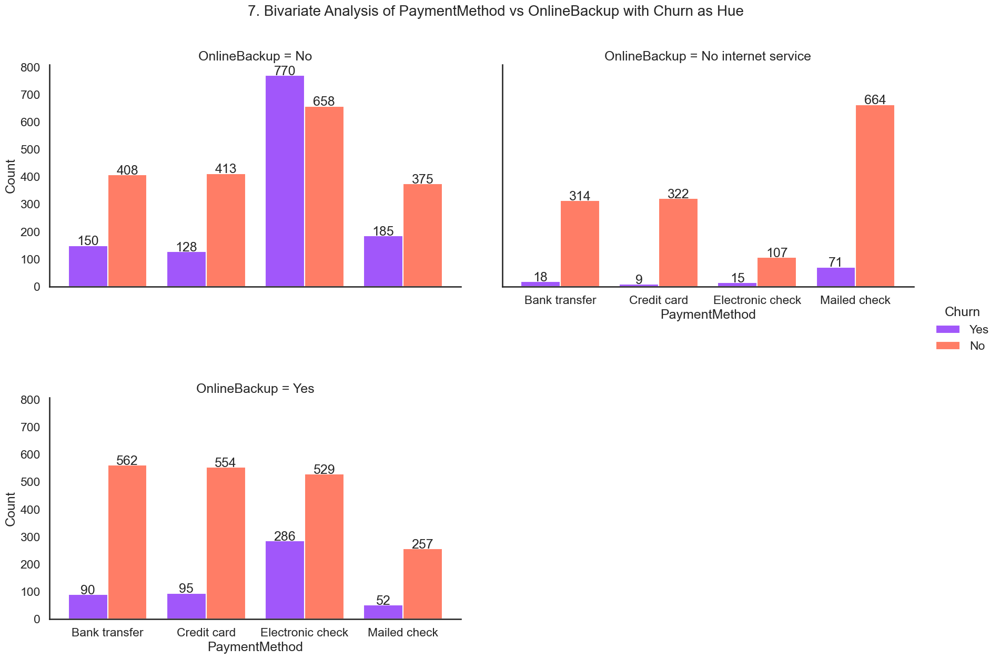

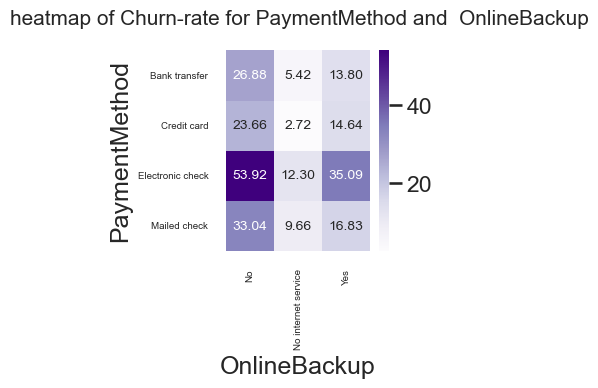

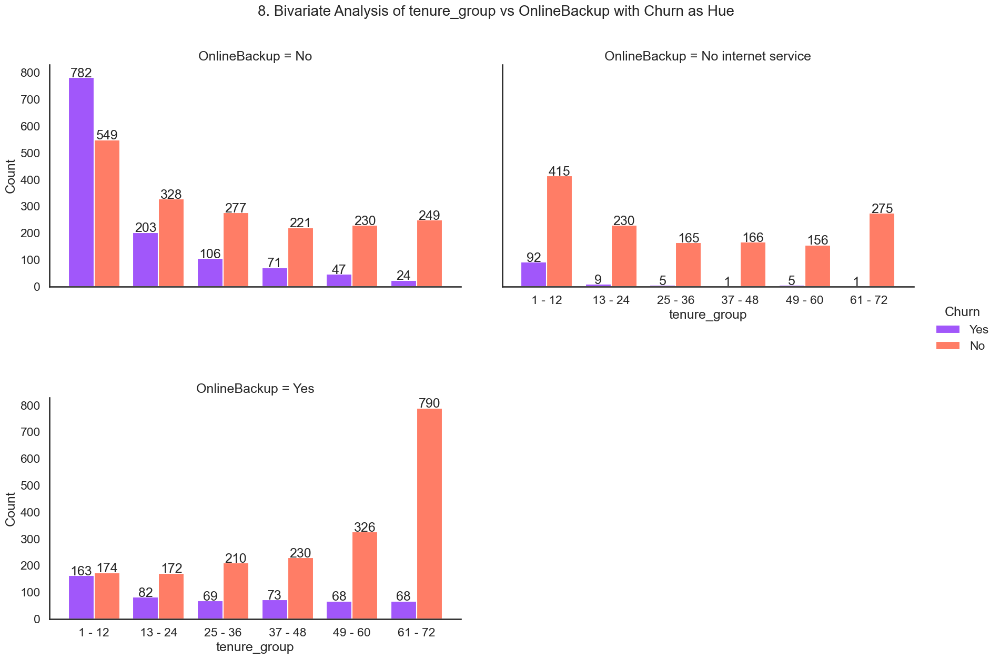

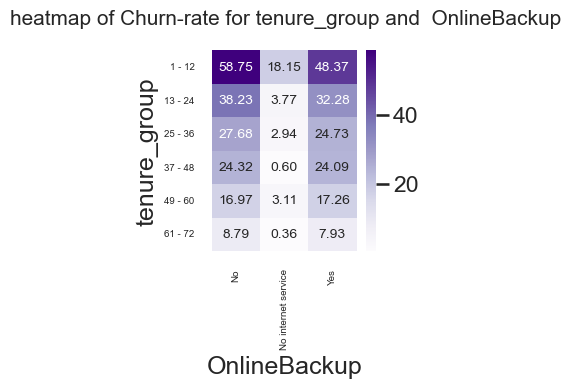

In [67]:
bivariate_plot(telco_data,'OnlineBackup')

Insight:
1. Customers with no online backup,  with and without Device Protection  service are high churners at 29.19% and 45.9%. Customers without internet service were low churners at 7.43%.

2. Customers with no online backup,  with and without Tech Support service are high churners at 20.65% and 47.77%.

3. Customers with no online backup,  with and without Stream TV service are high churners at 40% and 40%.

4.  Customers with no online backup,  with and without Stream Movies service are high churners at 39.3% and 40.4%.

6. Customers having a month to month contract, with and without online backup are high churners at 38.1% and 50.3% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

7. Customers with no online backup,  with and without Paperless Billing service are high churners at 45.2% and 29.11%. Customers with no internet service and no paperless billing option are low churners at 6.6%

8. Customers with no online backup,  with Electronic  and mailed check payment method are high churners at 53.9% and 33.04%. Customers with no internet service and credit card payment method are low churners at 2.72%

9. Customers with no online backup and belonging to 1-12,13-24,25-36,37-48 tenure groups are high churners. Customers with no internet service are low churners. Customers with Online backup and 1-12,13-24 tenure group are high churners with 48.3% and 32.46%.

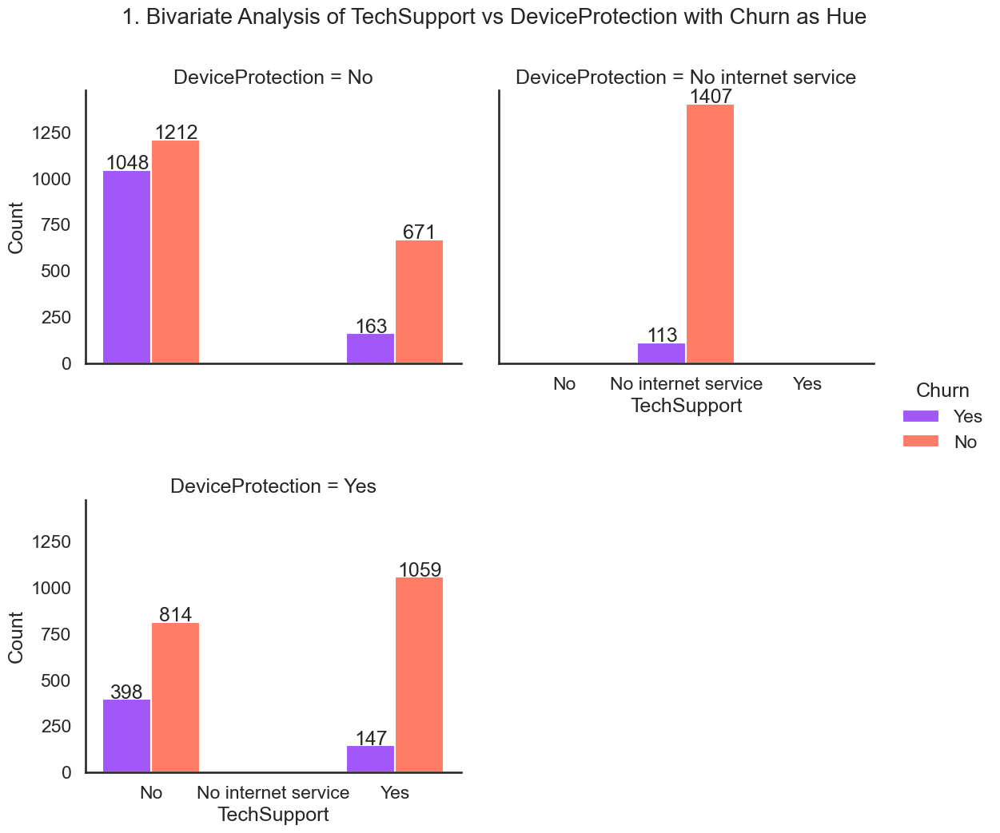

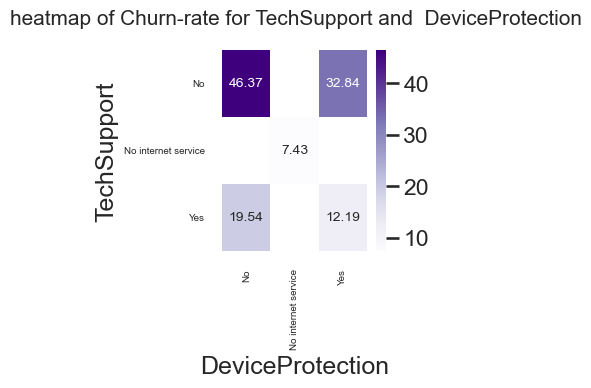

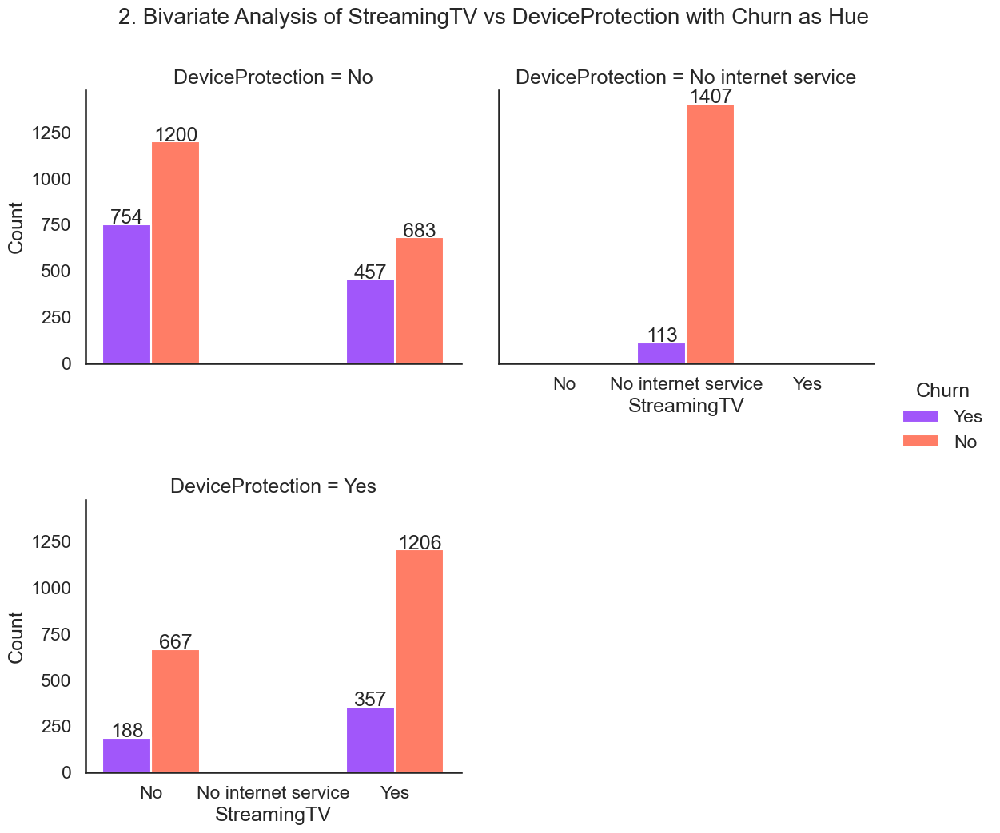

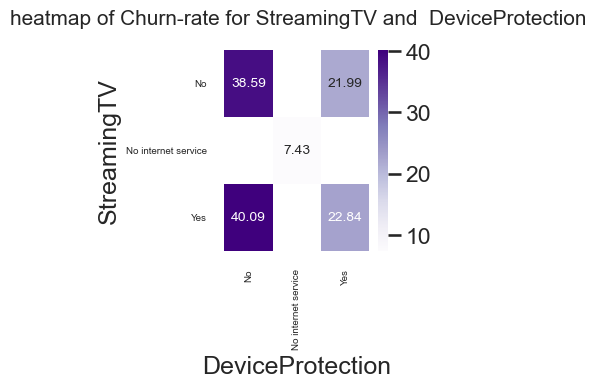

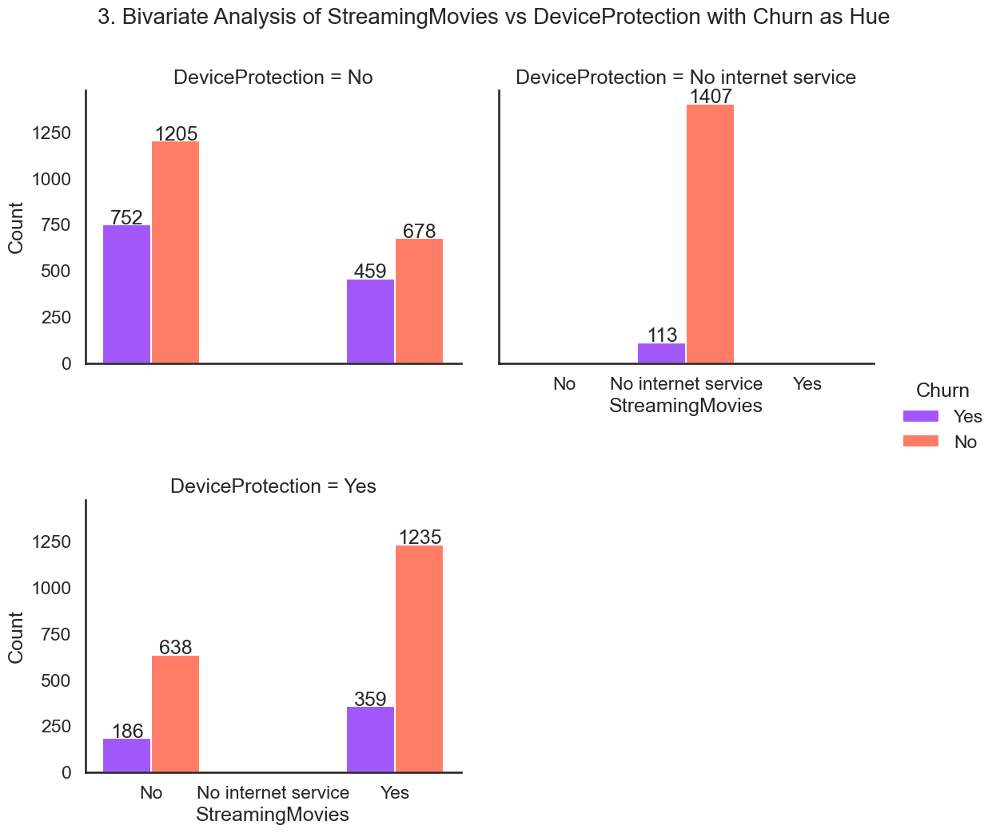

...

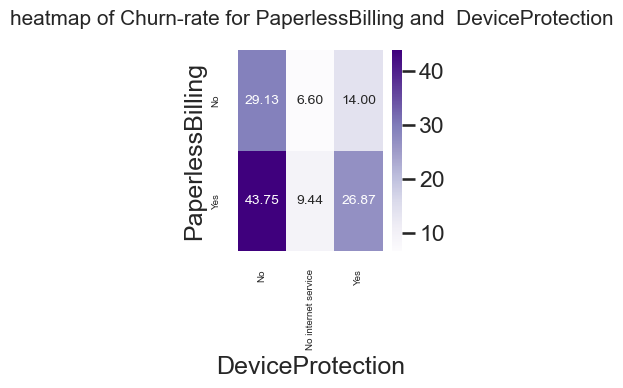

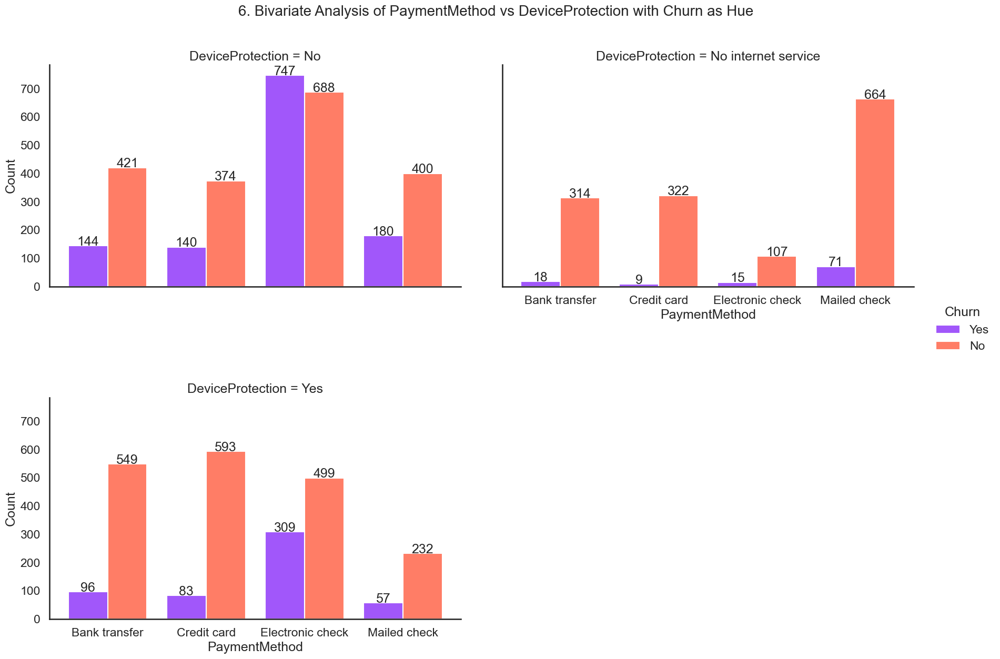

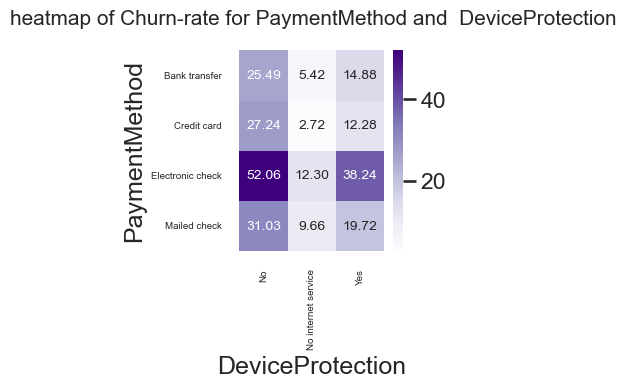

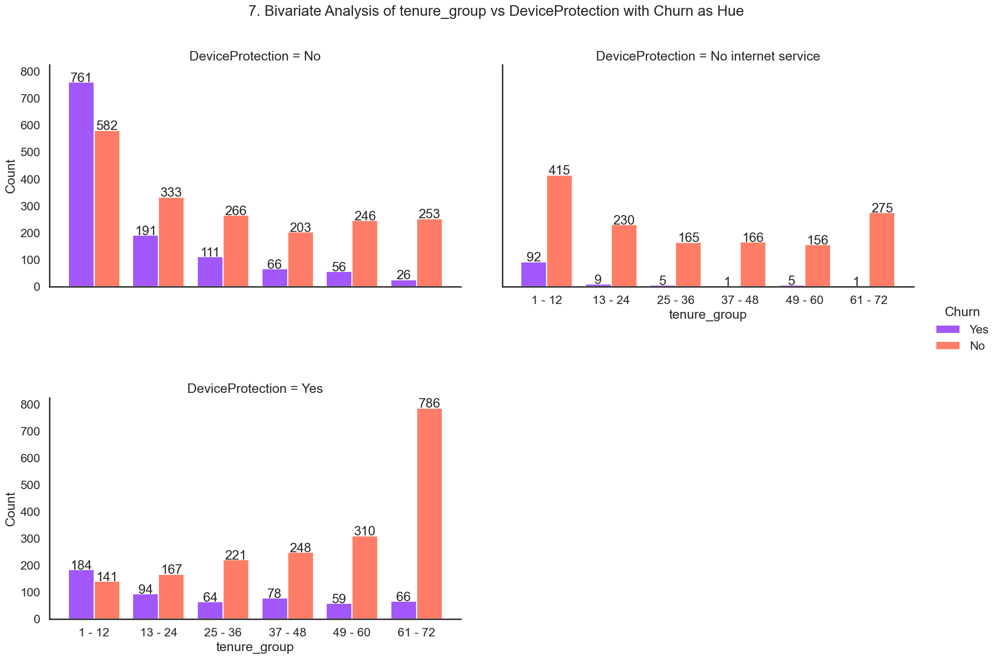

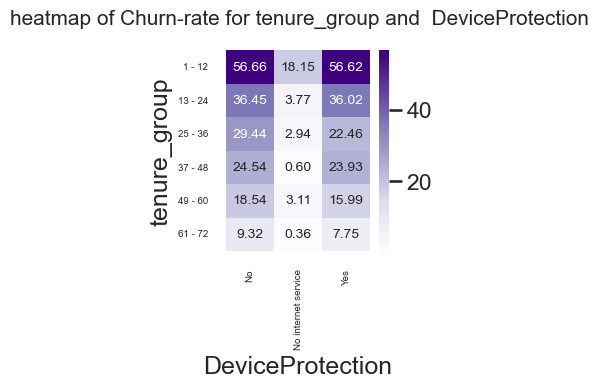

In [68]:
bivariate_plot(telco_data,'DeviceProtection')

Insight:

1. Customers with no TechSupport,  with and without Device Support service are high churners at 32.8% and 46.37%.

2. Customers with no  Device Protection,  with and without Streaming TV service are high churners at 40% and 38.5%.

3.  Customers with no   Device Protection ,with and without Streaming Movies service are high churners at 40.3% and 38.4%.

4. Customers having a month to month contract, with and without Device Protection are high churners at 43.5% and 47.5% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

5. Customers with no Device Protection,  with and without Paperless Billing service are high churners at 43.75% and 29.11%. Customers with no internet service and no paperless billing option are low churners at 6.6%

6. Customers with no Device Protection,  with Electronic  and mailed check payment method are high churners at 52.09% and 31.03%. Customers with no internet service and credit card payment method are low churners at 2.72%

7. Customers with no Device Protection and belonging to 1-12,13-24,25-36,37-48 tenure groups are high churners. Customers with no internet service are low churners. Customers with Device Protection and in 1-12,13-24 tenure group are high churners with 56.6% and 36%.

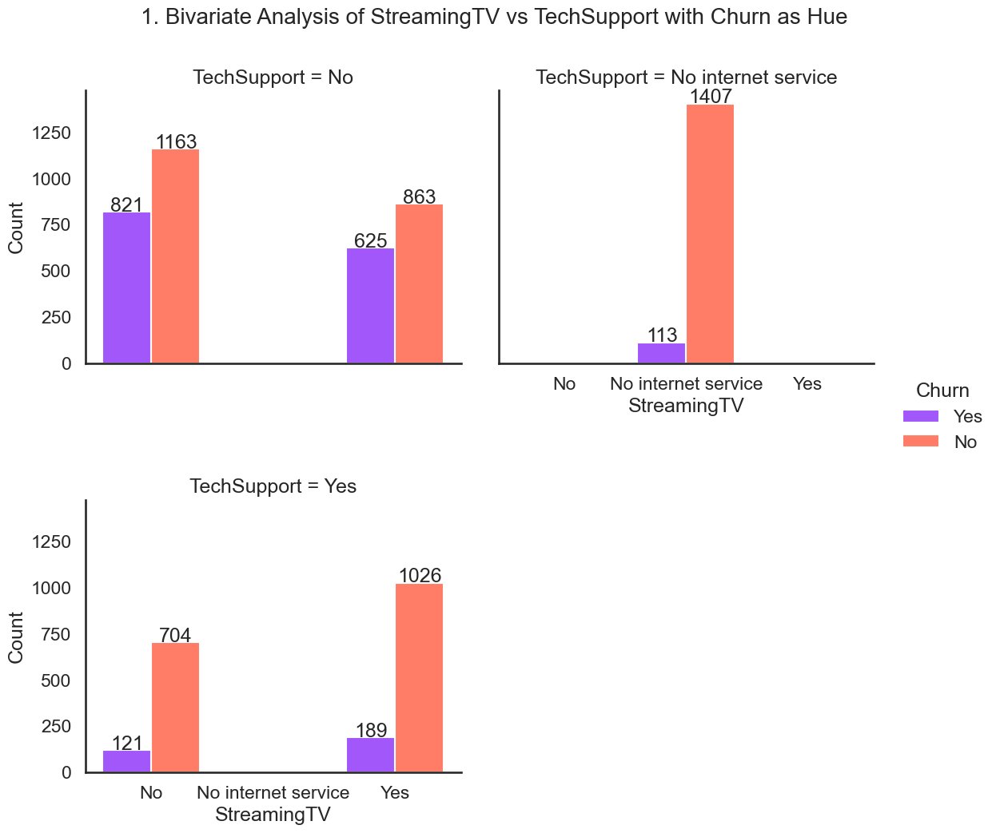

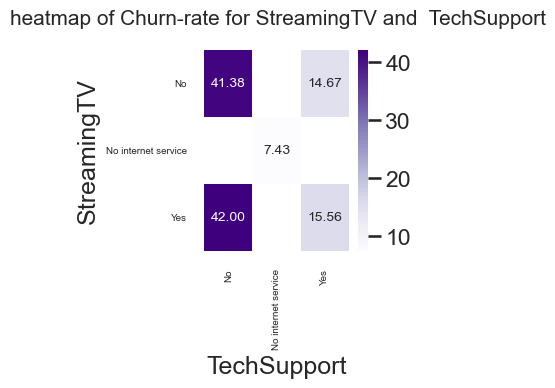

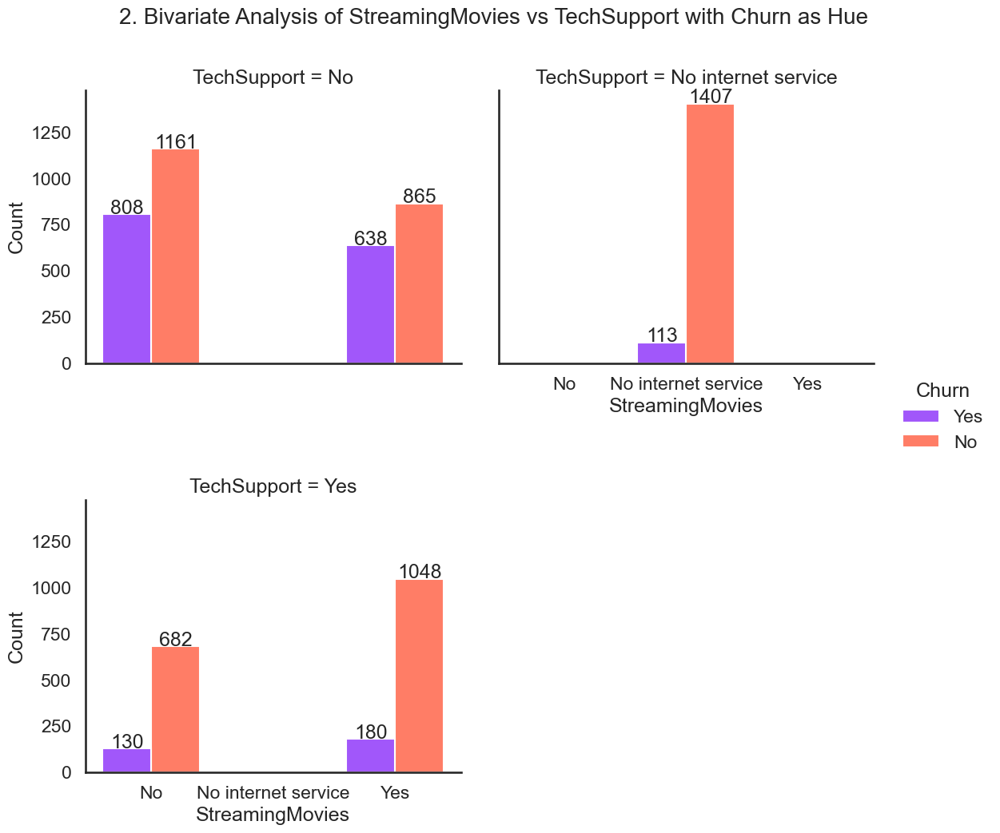

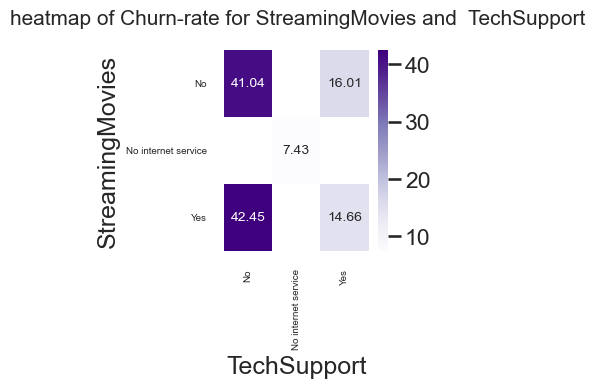

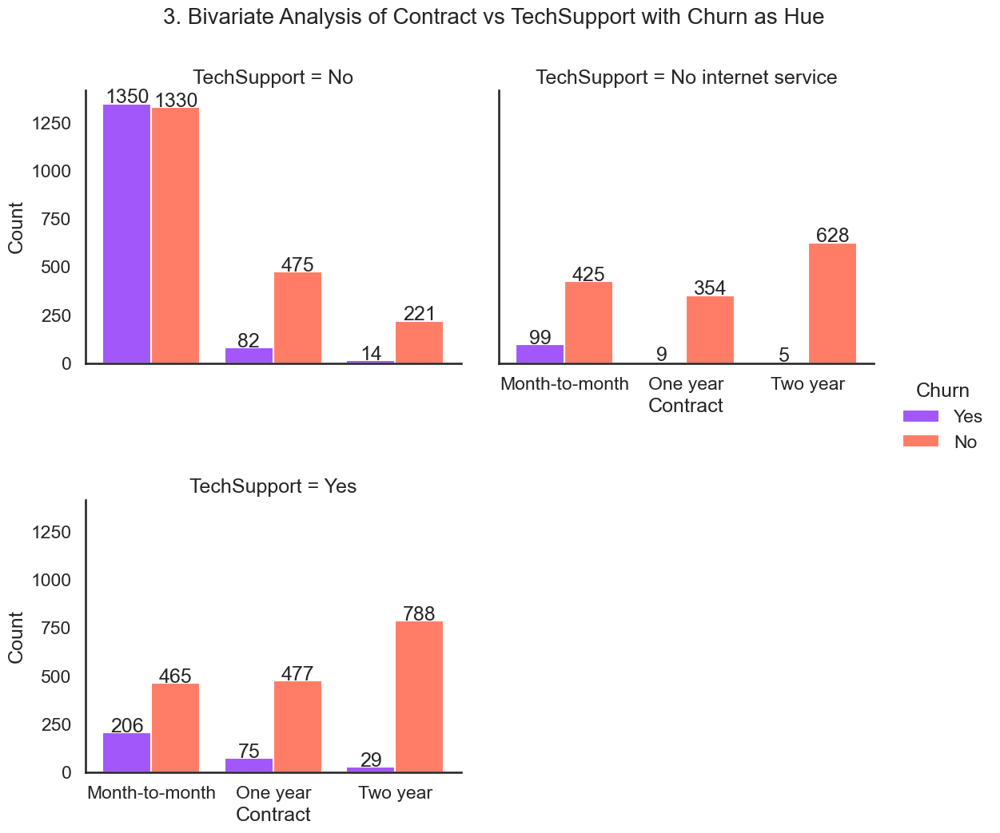

...

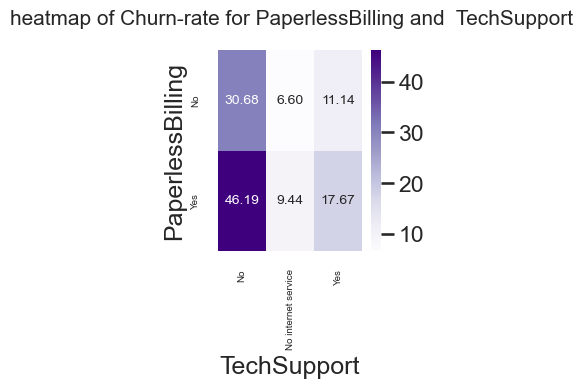

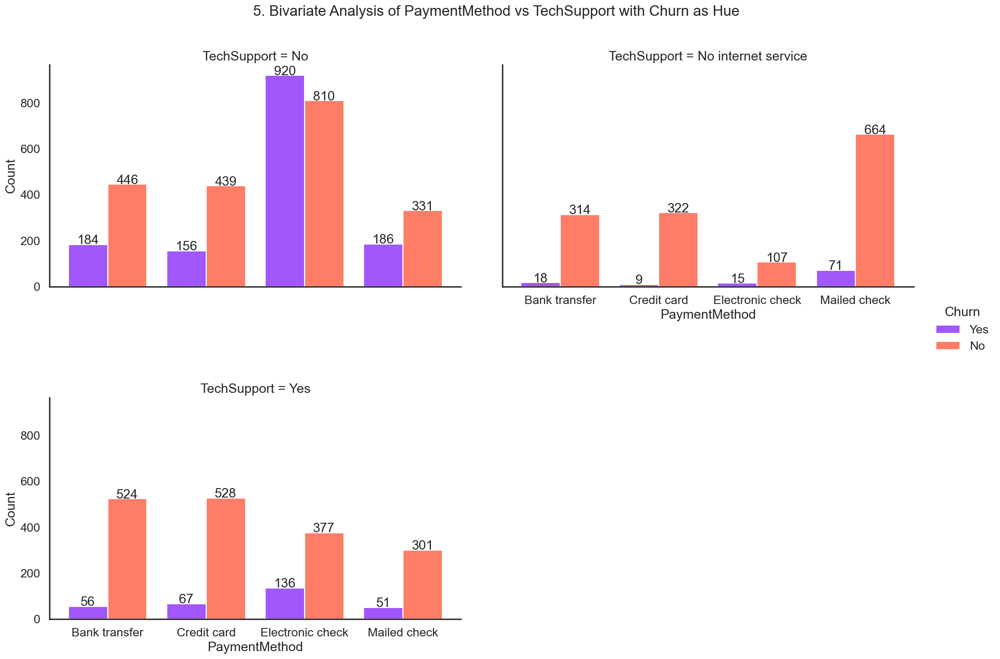

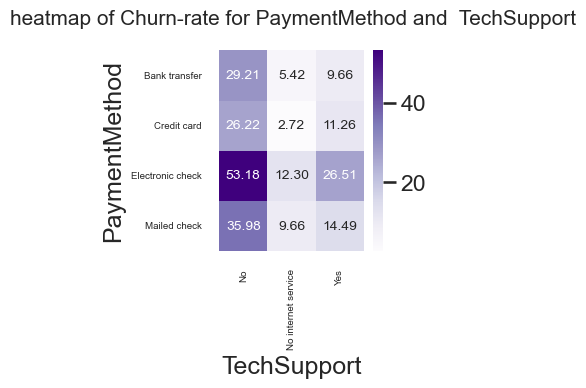

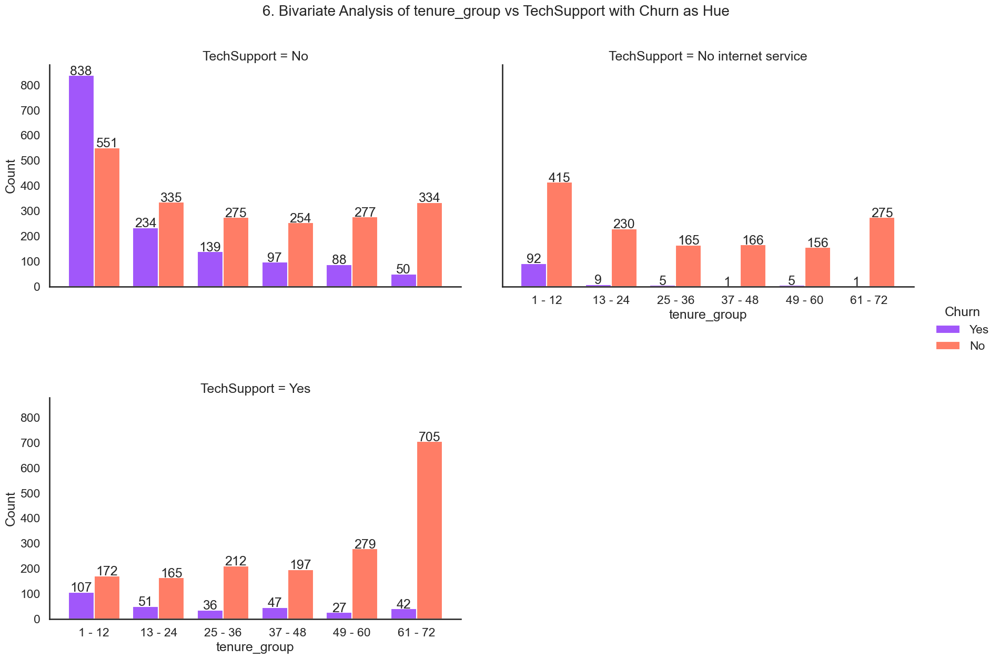

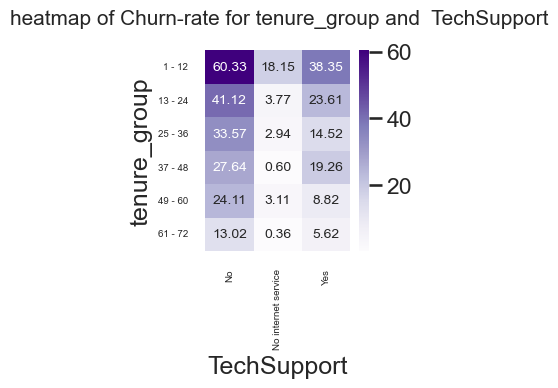

In [69]:
bivariate_plot(telco_data,'TechSupport')

Insight:


 1. Customers with no  Tech Support,  with and without Streaming TV service are high churners at 42% and 41%.

2.  Customers with no Tech Support   ,with and without Streaming Movies service are high churners at 42.3% and 41.04%.

3. Customers having a month to month contract, with and without Tech Support are high churners at 30.7% and 50.37% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

4. Customers with no Tech Support,  with and without Paperless Billing service are high churners at 46.19% and 30.68%. Customers with no internet service and no paperless billing option are low churners at 6.6%

5. Customers with no Tech Support,  with Electronic  and mailed check payment method are high churners at 53.18% and 35.9%. Customers with no internet service and credit card payment method are low churners at 2.72%

6. Customers with no Tech Support and belonging to 1-12,13-24,25-36,37-48,49-60 tenure groups are high churners. Customers with no internet service are low churners. Customers with Tech Support and in 1-12,13-24 tenure group are high churners with 38.35% and 23.6%.

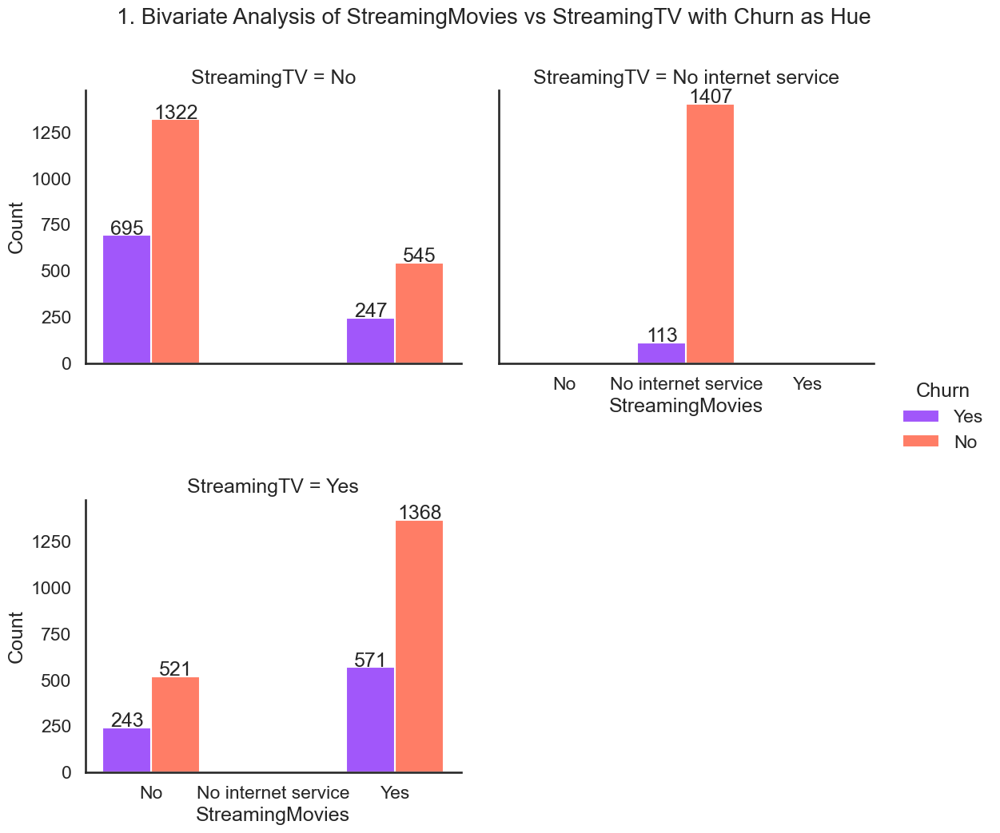

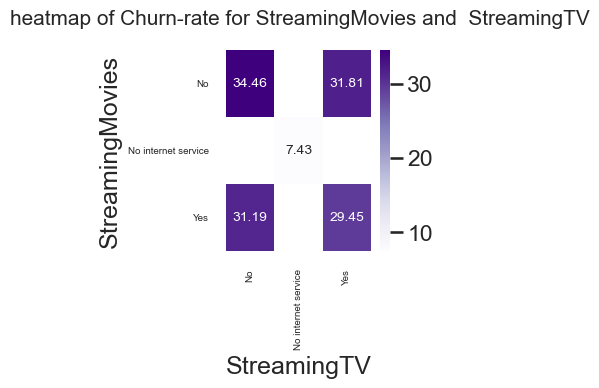

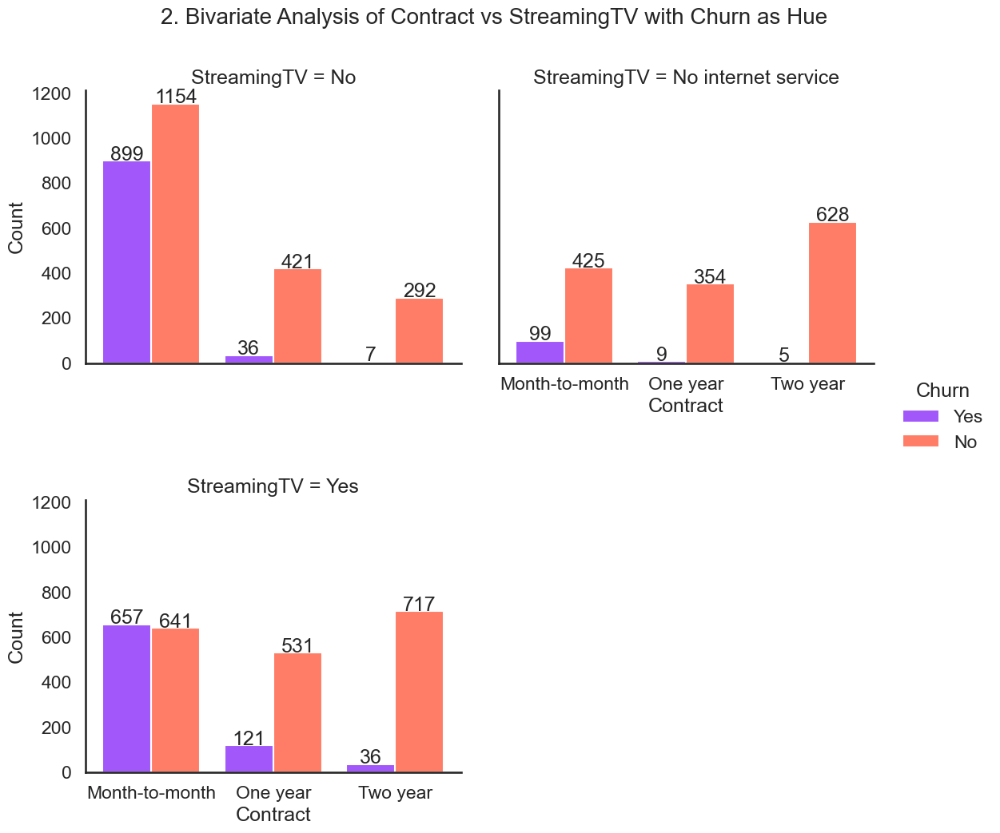

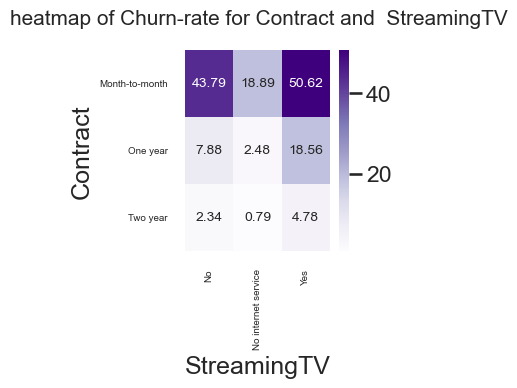

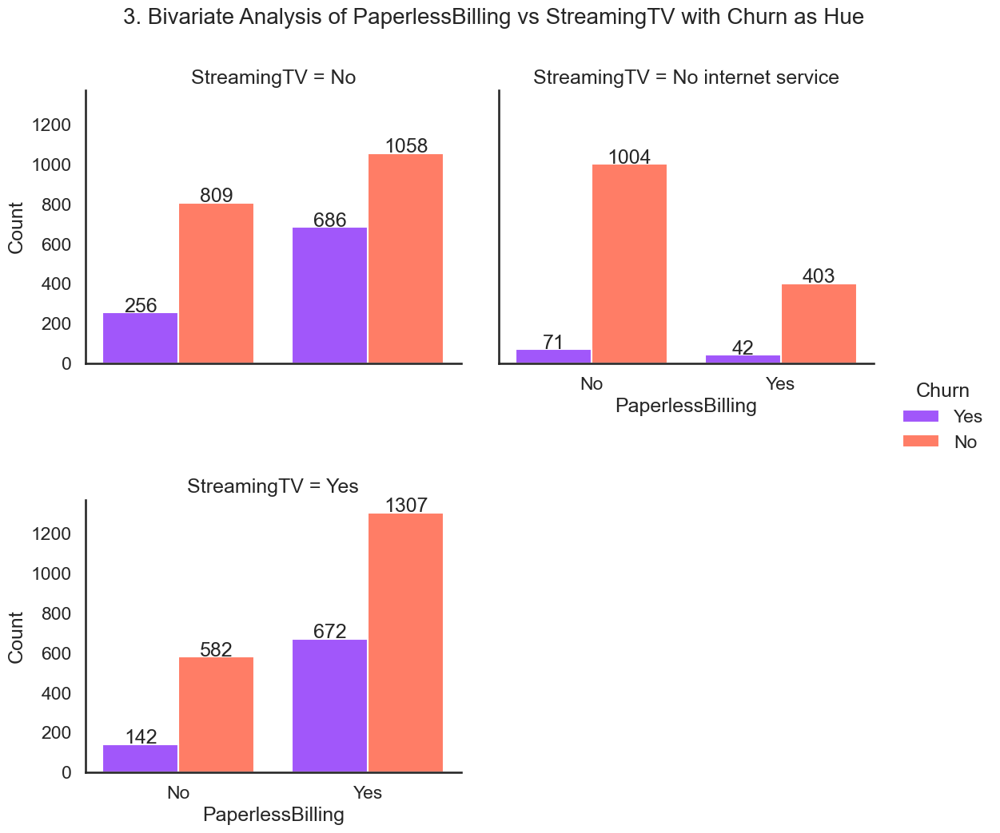

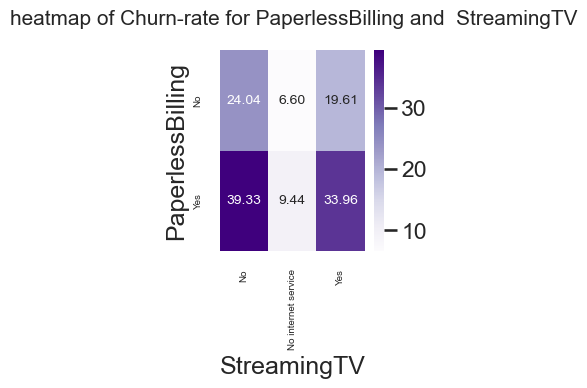

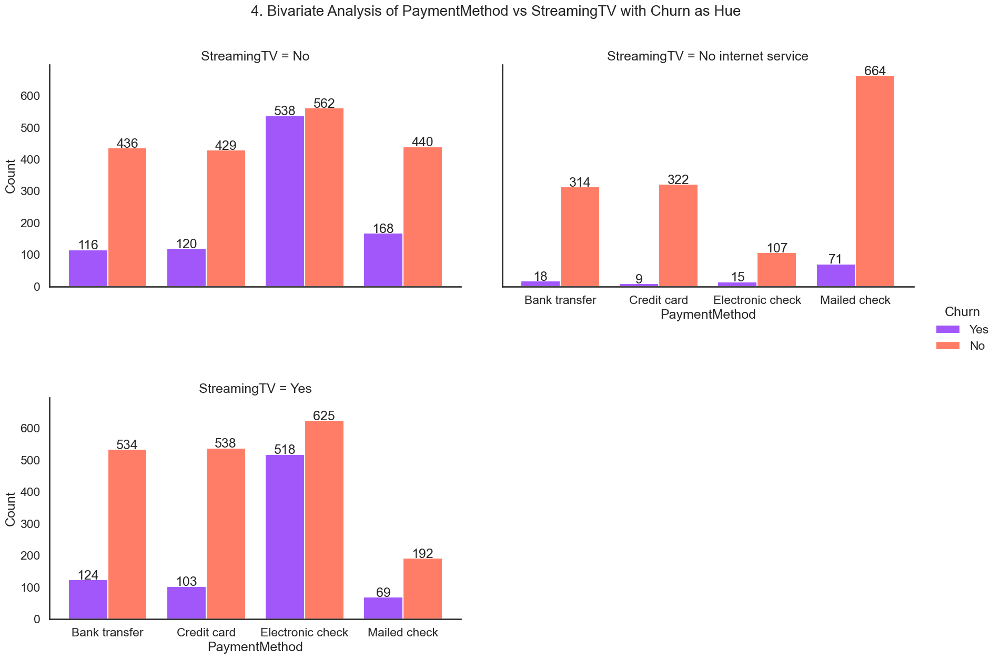

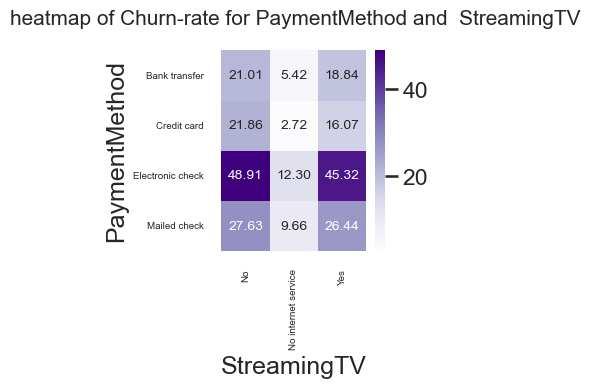

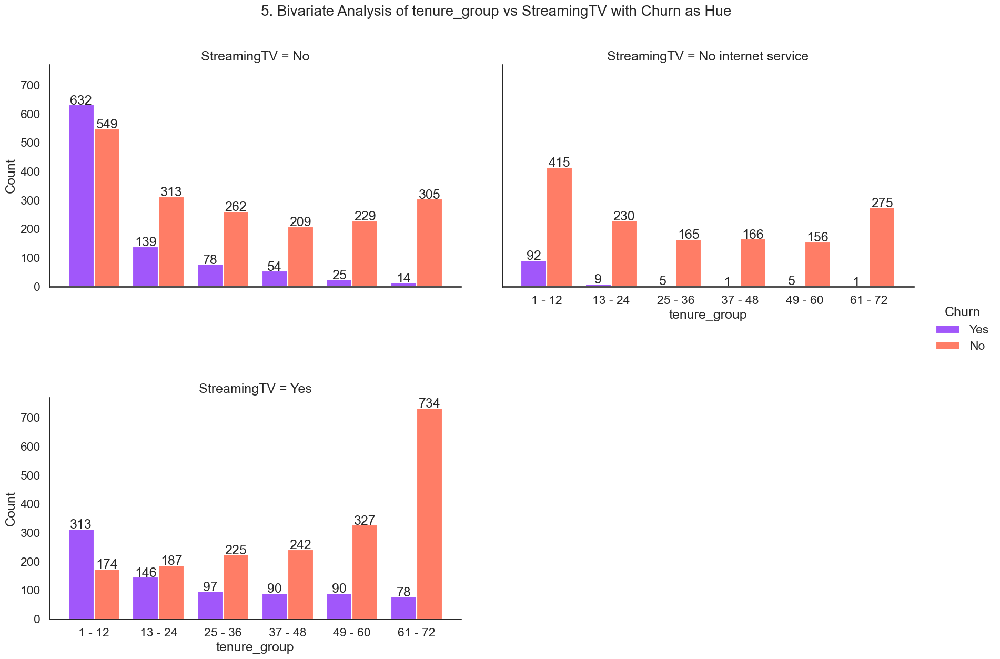

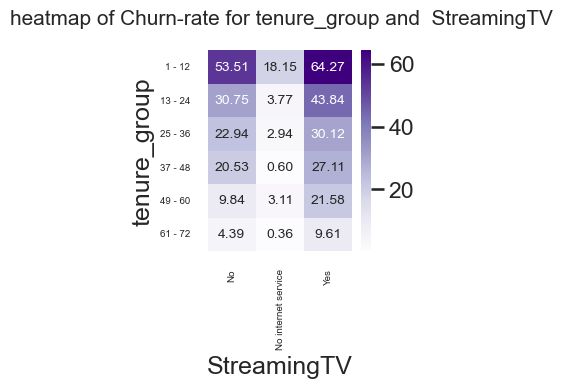

In [70]:
bivariate_plot(telco_data,'StreamingTV')

Insight:
1.  Customers with no Streaming TV services  ,with and without Streaming Movies service are high churners at 31.19% and 34.4%.

2. Customers having a month to month contract, with and without Streaming TV services are high churners at 50.6% and 43.7% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

3. Customers with no Streaming TV services,  with and without Paperless Billing service are high churners at 39.33% and 24.04%. Customers with no internet service and no paperless billing option are low churners at 6.6%

4. Customers with no Streaming TV services ,  with Electronic  and mailed check payment method are high churners at 48.9% and 27.63%. Customers with no internet service and credit card payment method are low churners at 2.72%

5. Customers with  and without Streaming TV services  and belonging to 1-12,13-24,25-36,37-48 tenure groups are high churners. Customers with no internet service are low churners.  

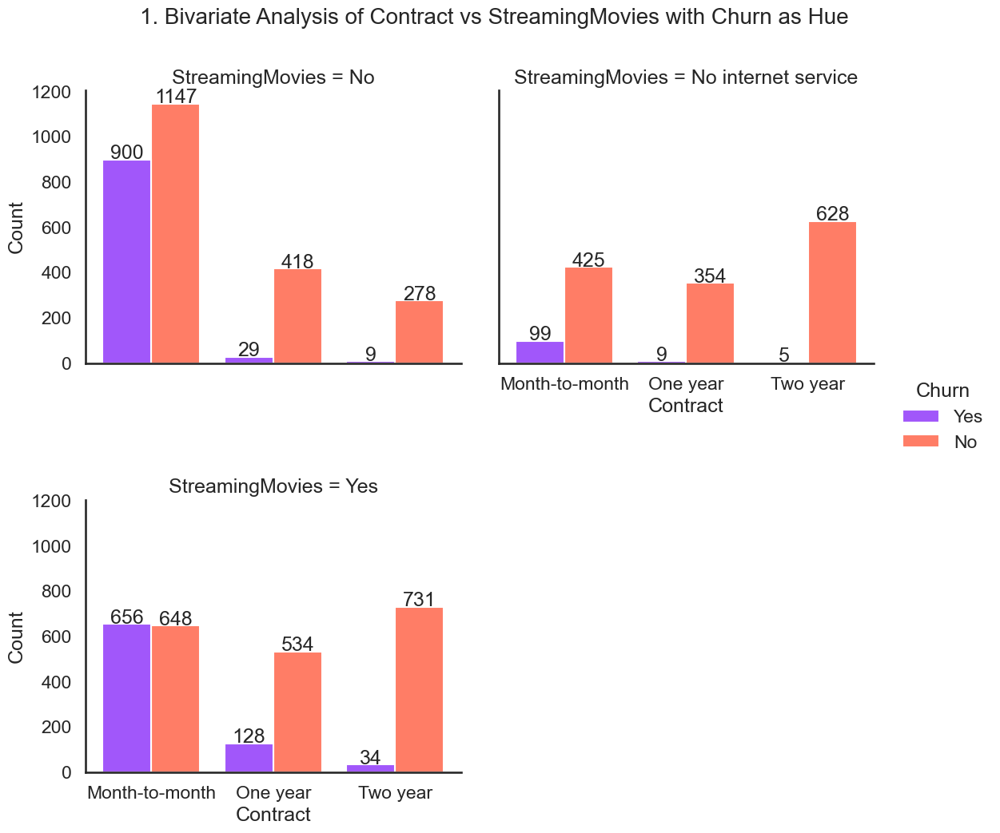

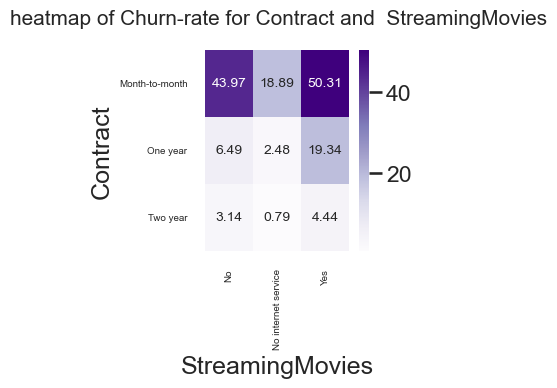

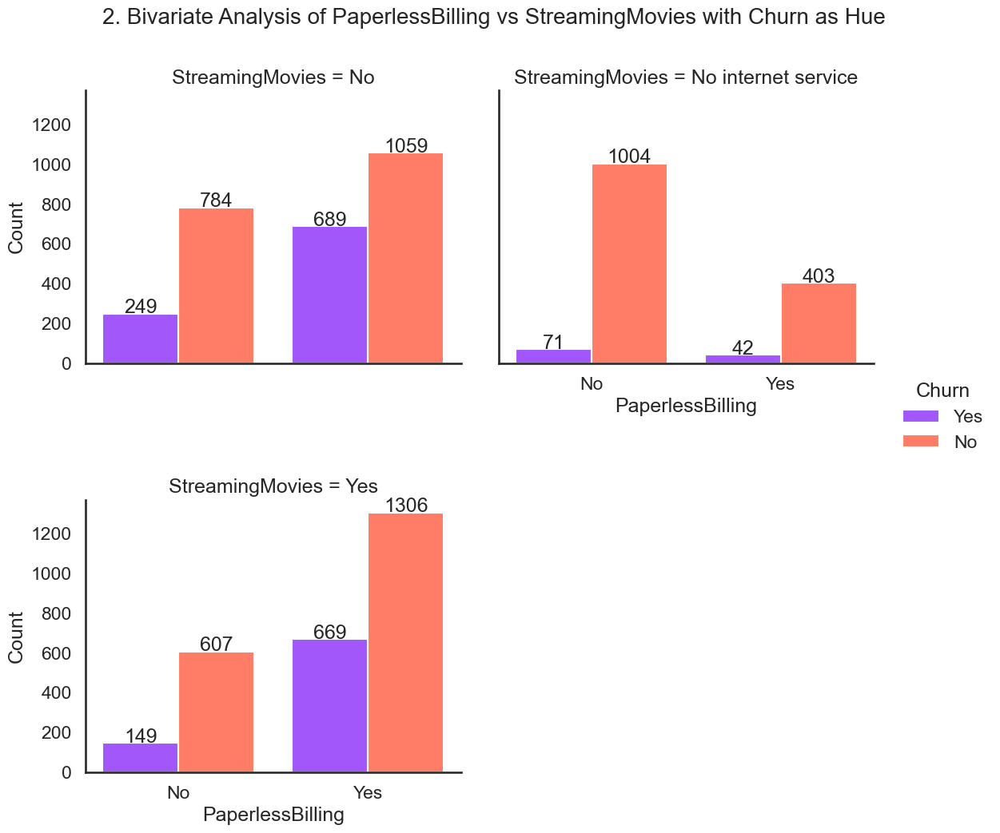

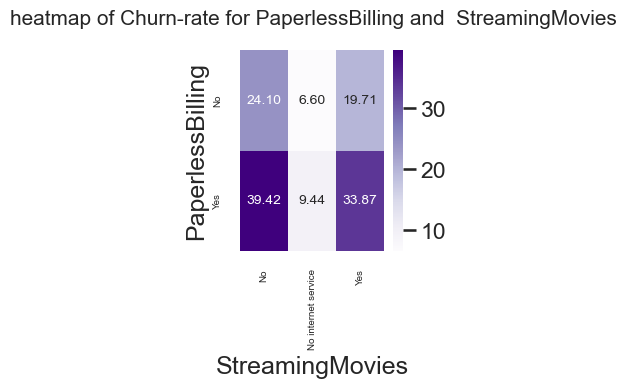

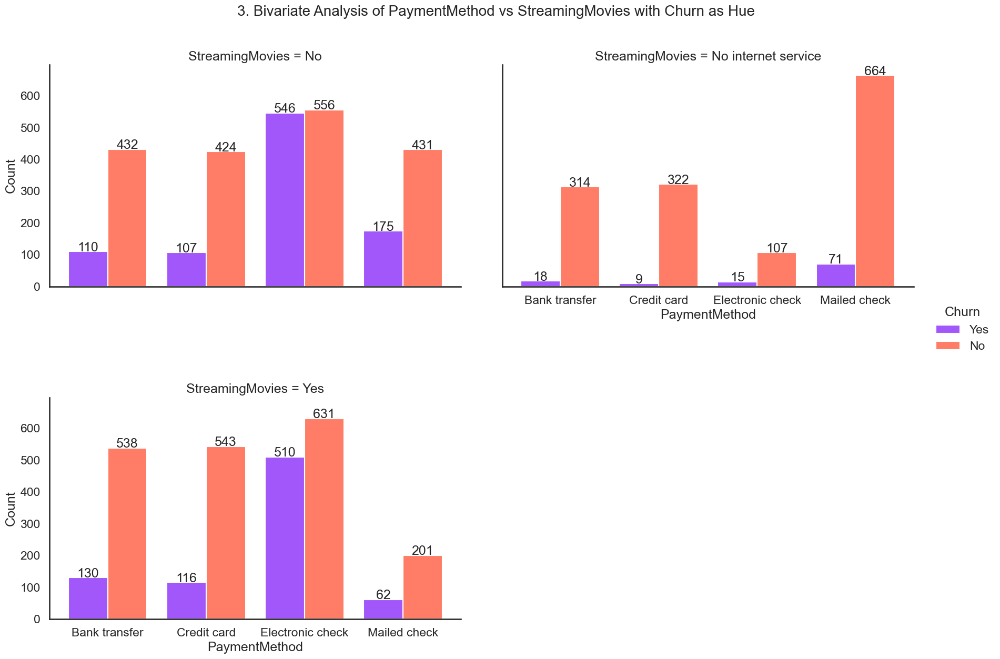

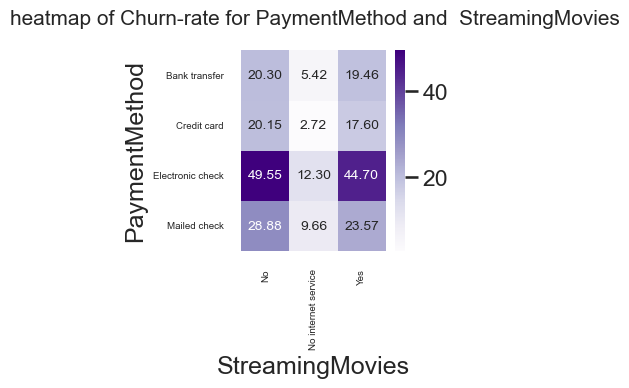

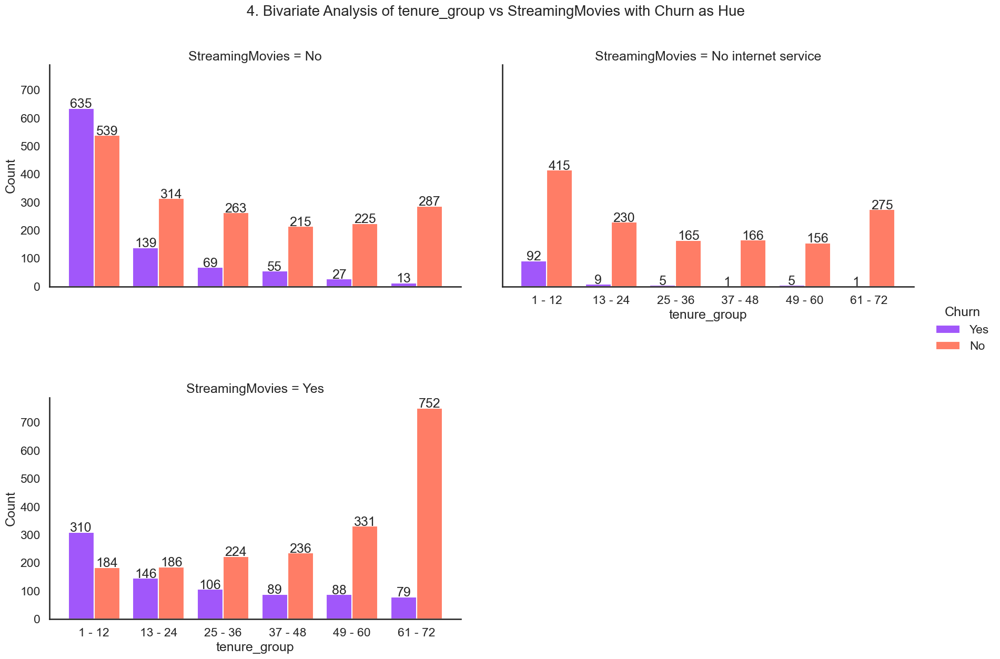

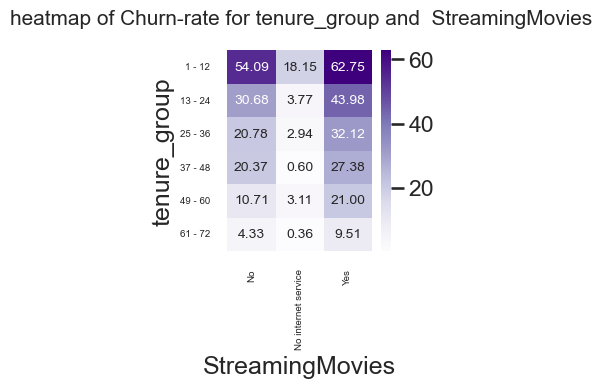

In [71]:
bivariate_plot(telco_data,'StreamingMovies')



Insight:

1. Customers having a month to month contract, with and without Streaming Movies services are high churners at 50.3% and 43.97% respectively. Customers with two year contracts are low churners , with the lowest being no internet service with 0.79%.

2. Customers with no Streaming Movies services,  with and without Paperless Billing service are high churners at 39.4% and 24.1%. Customers with no internet service and no paperless billing option are low churners at 6.6%.Customers with a Streaming Movies service and paperless billing option are high churners at 33.87%.

3. Customers with no Streaming TV services ,  with Electronic  and mailed check payment method are high churners at 49.5% and 28.83%. Customers with no internet service and credit card payment method are low churners at 2.72%. Customers with  Streaming TV services ,  with Electronic  check payment method are high churners at 44.7%

4. Customers with  and without Streaming Movies services  and belonging to 1-12,13-24,25-36,37-48 tenure groups are high churners. Customers with no internet service are low churners.

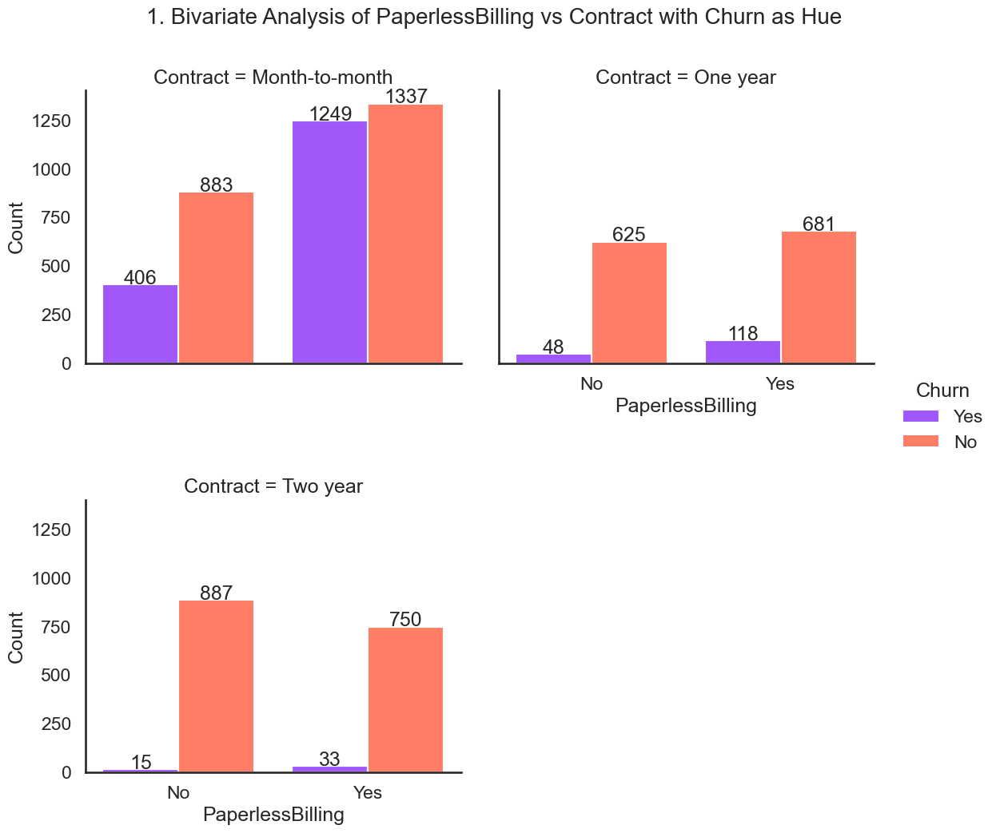

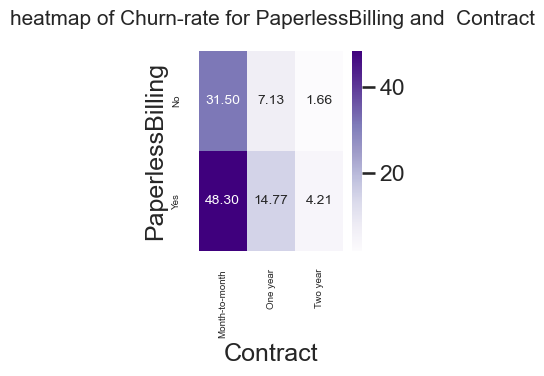

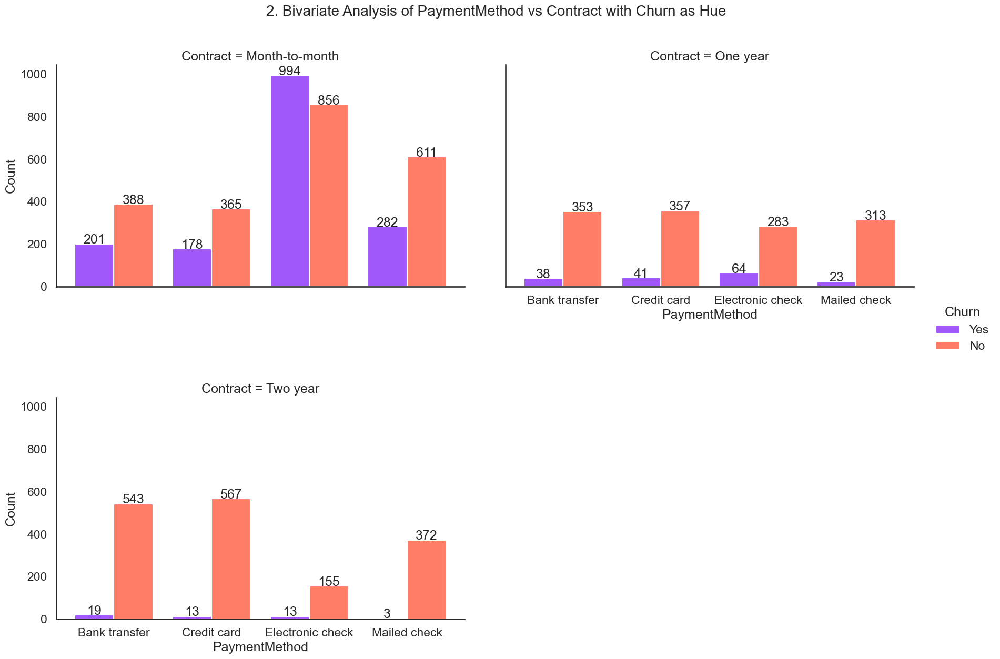

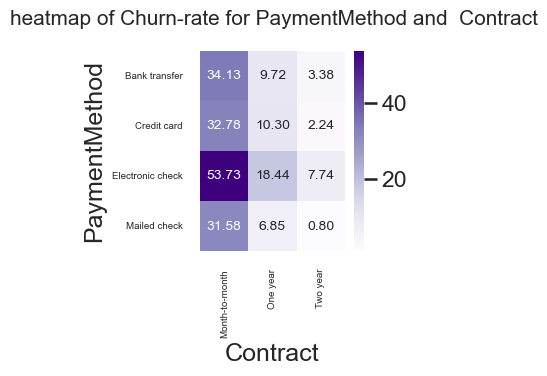

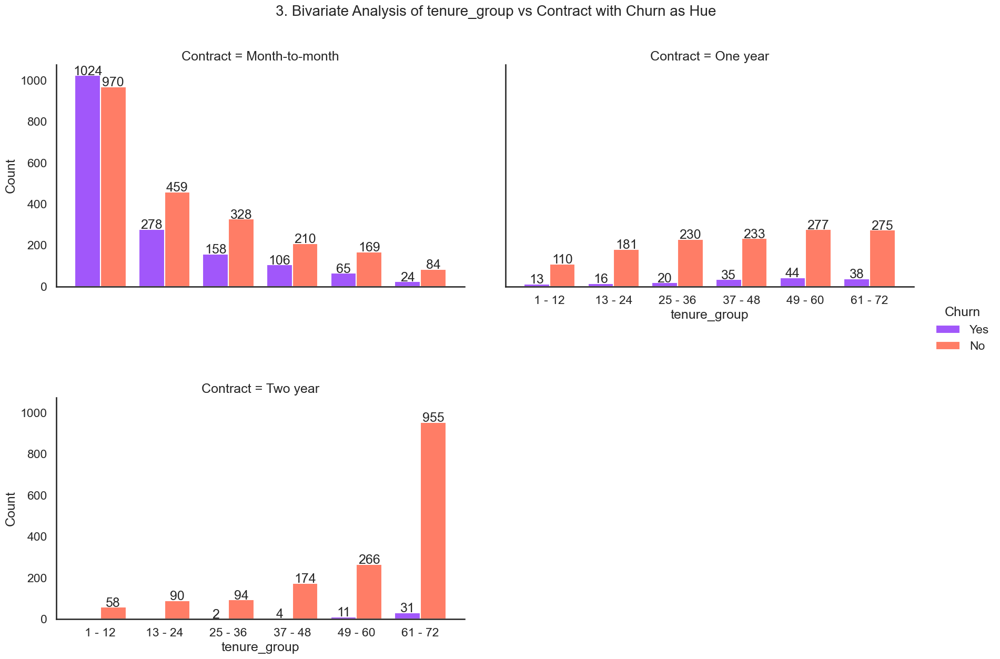

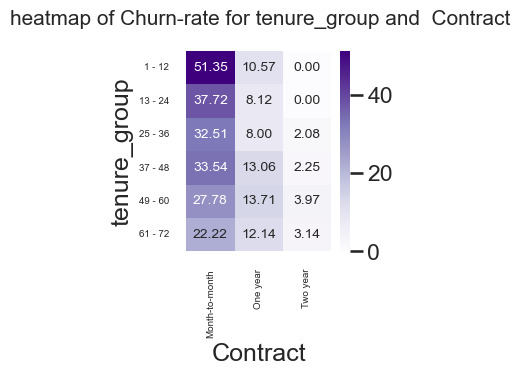

In [72]:
bivariate_plot(telco_data,'Contract')

Insight:
1. Customers with month to month contract,  with and without Paperless Billing service are high churners at 48.3% and 31.5%. Customers with two year contract and no paperless billing option are low churners at 1.6%.



2. Customers with month to month contract with all payment options are high churners, the highest being 53.73 churn rate for Electronic check. Customers in two year contract are low churners, the lowest being Mailed Check with 0.8%.



3. Customers with month to month contract are high churners, with highest being 51.35% in 1-12 tenure. Customers in two year contract are low churners, the lowest being 25-36 tenure at  2.08%.

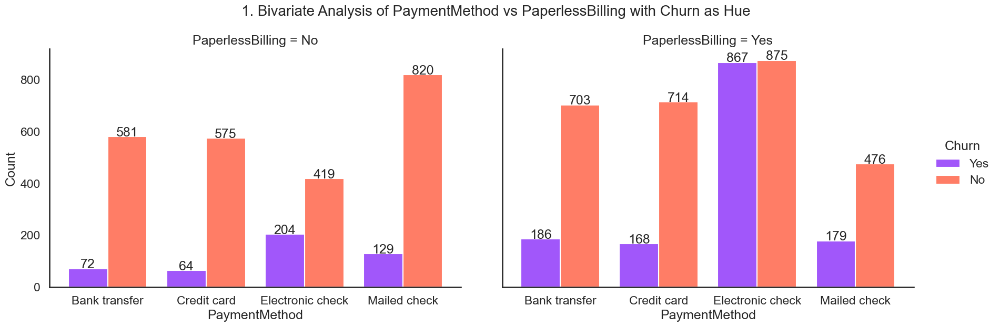

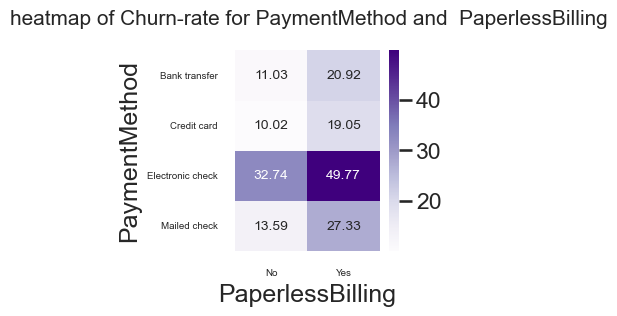

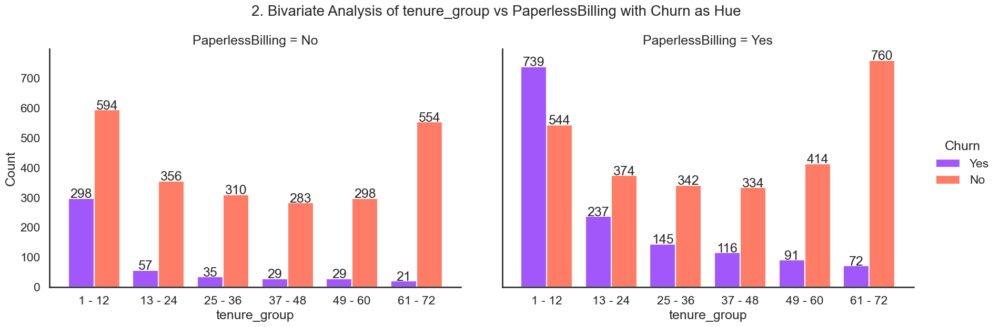

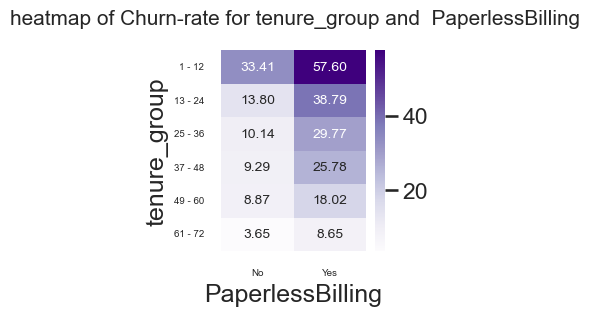

In [73]:
bivariate_plot(telco_data,'PaperlessBilling')

Insight:
1. Customers with and without  Electronic  check are high churners, with 49.77%  and 32.74. Customers with paperless Billing and mailed check are high churners  at  27.33%

2. Customers with paperless billing option are high churners in  tenure groups 1-12,13-24,25-36,37-48 with highest being  57.6% .Customers in paperless billing option and  1-12 tenure group are high churners at 33.4% .

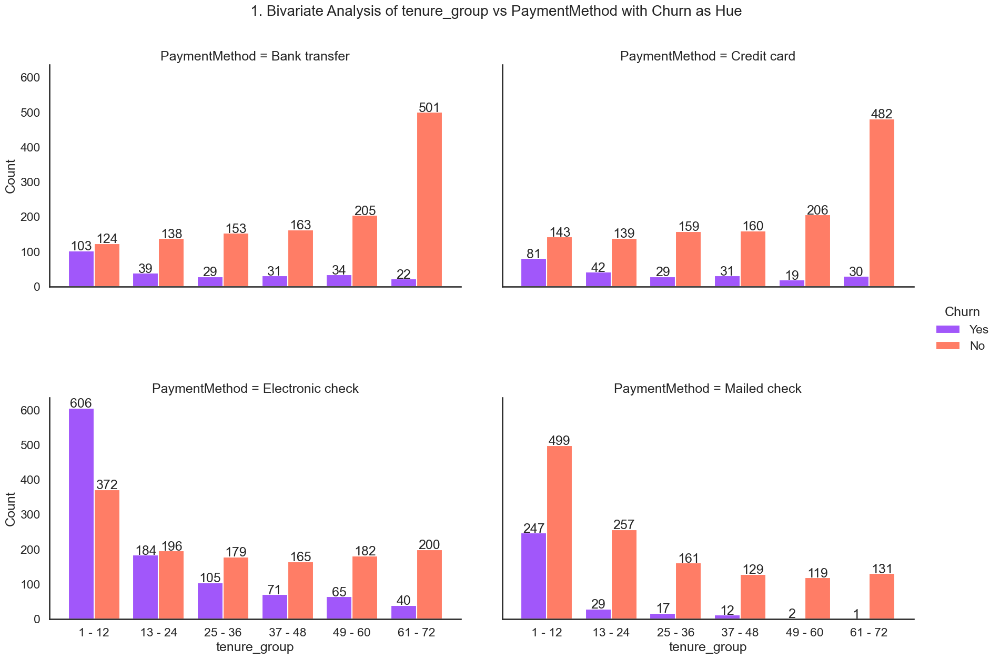

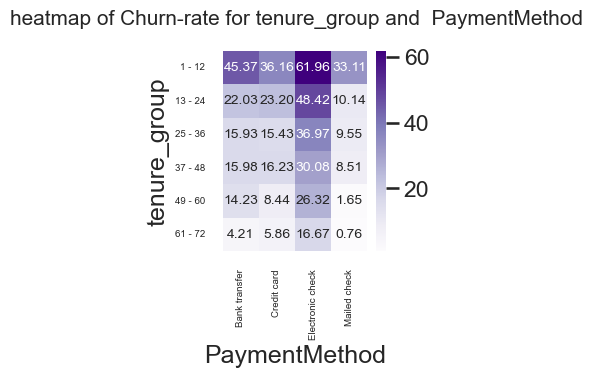

In [74]:
bivariate_plot(telco_data,'PaymentMethod')

Insight:

1. Customers in tenure 1-12 are high churners with all payment methods ,the highest being electronic check at 61.96%.Customers in tenure group 13-24,25-36,37-48  and electronic check payment are high churners .Customers in tenure group 61-72 are low churners.  

## **2B. BIVARIATE ANALYSIS OF CATEGORICAL AND NUMERICAL VARIABLES:**

We have 17 categorical and 2 numerical columns. Thheir relationship with respect to Churn can be shown using various estimate plots like bar,box,boxen,violen plots etc.
Relation of Monthly Charges with categorical columns

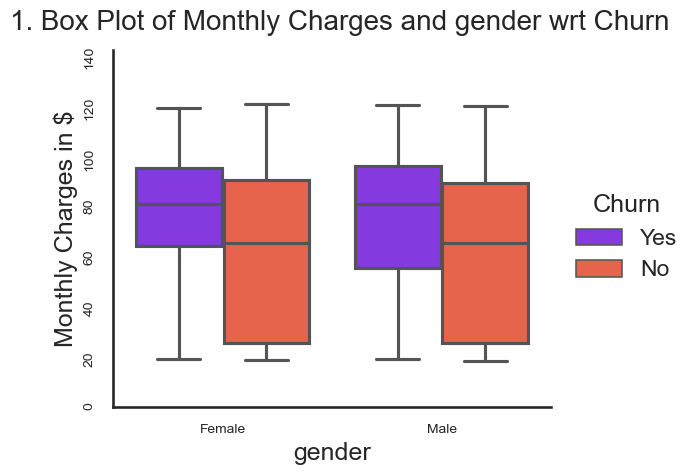

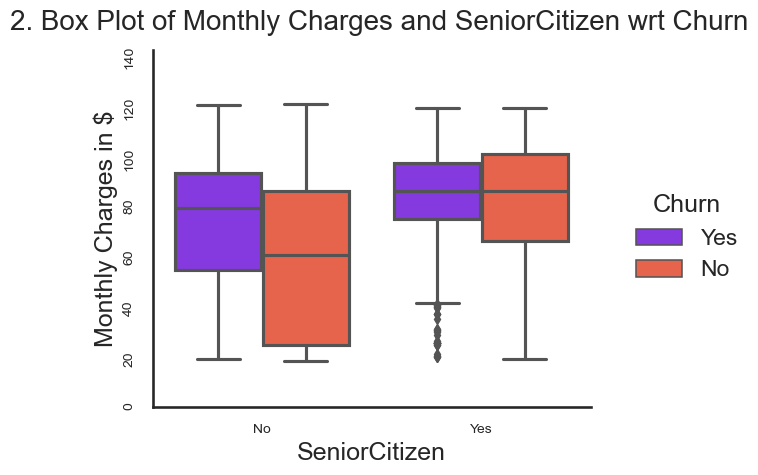

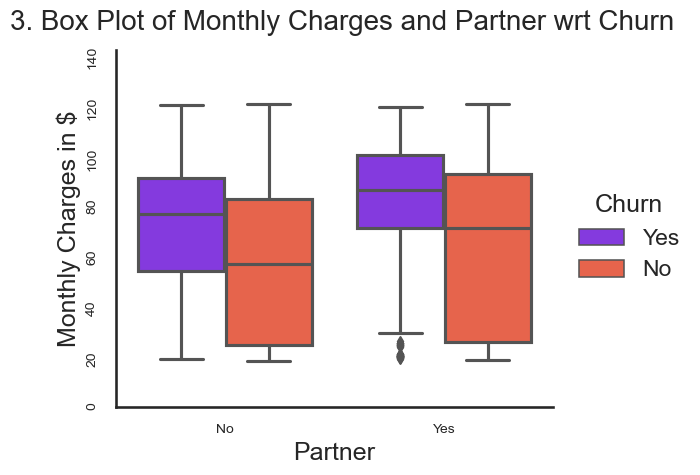

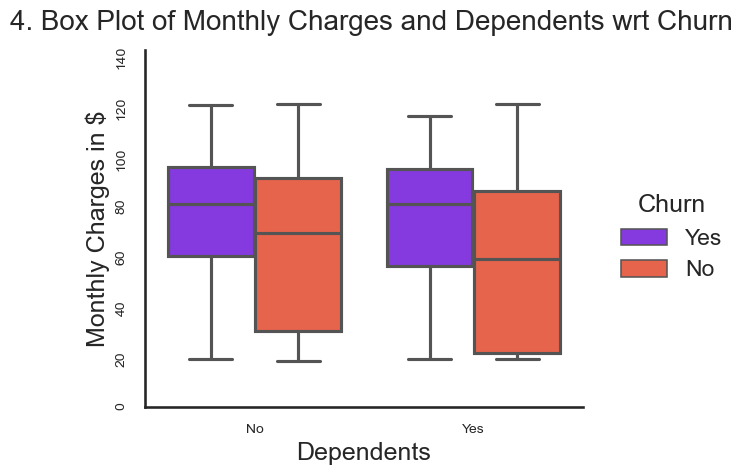

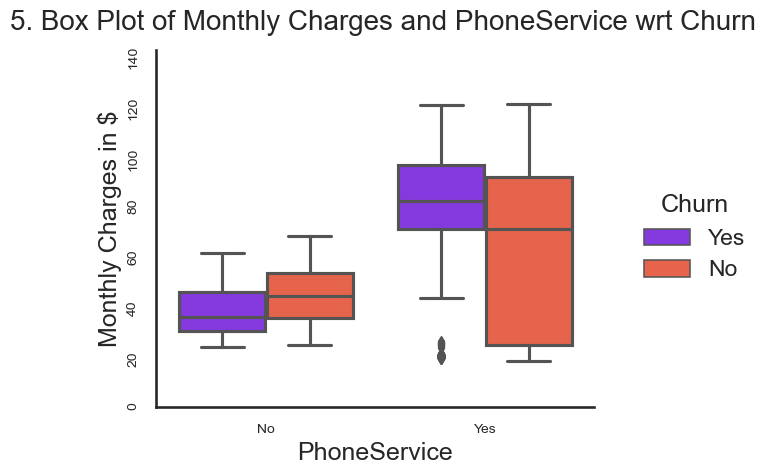

...

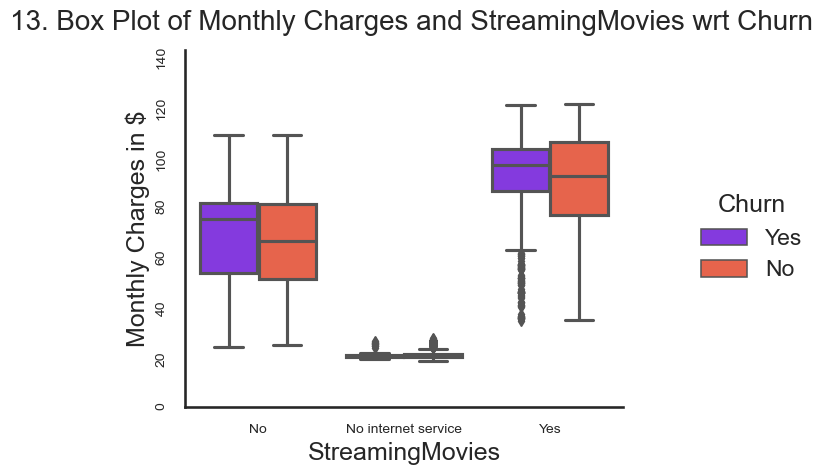

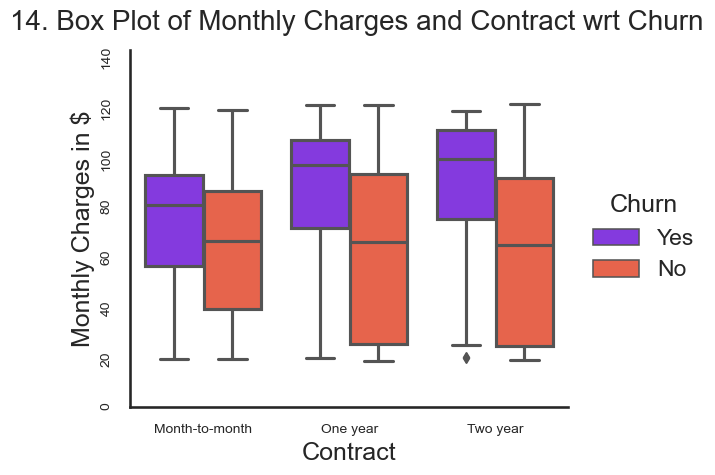

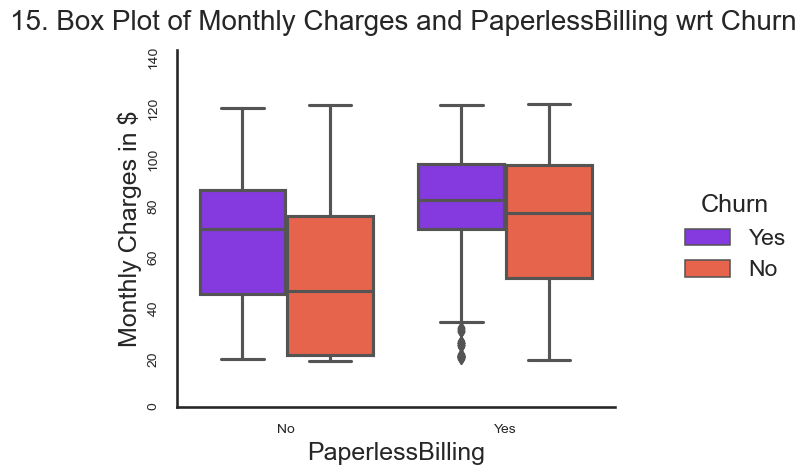

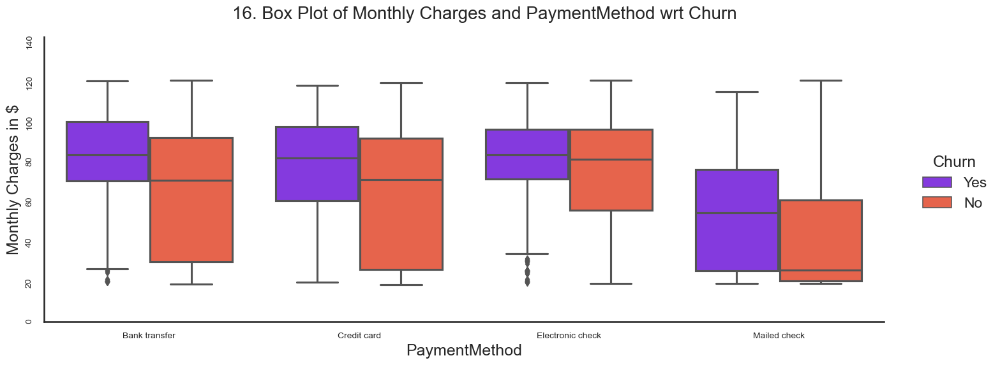

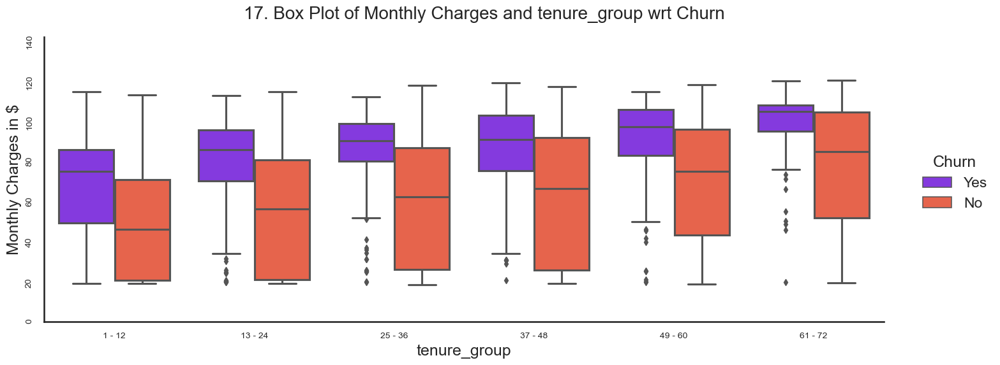

In [79]:

for i,col in enumerate(categorical_col):
        if telco_cleaned[col].nunique()>3 :
            fig_ht=6
            aspect=2.5
        else: 
            fig_ht=5
            aspect=1.2
            
        g = sns.catplot(kind='box',
                  data=telco_data,
                  x=col,y='MonthlyCharges',
                  hue='Churn',hue_order=['Yes','No'],palette=cpalette,
                  dodge=True,
                  sharex=False , margin_titles=True,
                  height=fig_ht, aspect=aspect
              )
        g.set(ylabel='Monthly Charges in $', xlabel=col)
        g.set_yticklabels(rotation=90)
        g.fig.subplots_adjust(top=0.9)  # Adjust the top of the figure to make space for the title
        
        g.fig.suptitle(f"{i+1}. Box Plot of Monthly Charges and {col} wrt Churn",fontsize=20)
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.subplots_adjust(hspace=2,wspace=2)
plt.show()
#plt.savefig("cat_monthly.png")


Insight:
1. Both male and female have high monthly charges are lileky to churn.

2. Monthly charges are significantly higher for Senior Citizens compared to Non-Senior Citizens and they are higher churn rate too.

3. Customers with partners have higher monthly charges when compared to customers without partners.They have higher churn rate also.

4. Customers with dependents have low Monthly charges when compared to customers without dependents.The churn rate is almost the same for both type of customers.

5. People with a phone service have a high monthly charges and their churn rate is also higher when compared to customers without a phone service.

6. Customers with multiple lines have higher monthly charges.Their  churn rate is also higher when compared to other two categories.Customers who have dont have multiple lines have signifantly lower monthly charges as shown above. As expected, customers who do not enroll in the phone service have low charges.

7. Customers who opted for 'Fiber optic' service have higher monthly charges. Customers who opted for 'DSL' service has signifantly lower monthly charges . As expected, customers who do not enroll in the internet service have low charges.Higher the charges,higher is the churn rate.

8. Customers who opted for 'Online security' service have slightly higher monthly charges. Customers who didnt opt for 'Online security' service has slightly lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

9. Customers who opted for 'Online Backup' service have higher monthly charges. Customers who didnt opt for 'Online Backup' service has lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

10. Customers who opted for 'Device Protection' service have higher monthly charges. Customers who didnt opt for 'Device Protection' service has lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

11. Customers who opted for 'Tech support' service have slighty higher monthly charges. Customers who didnt opt for 'Tech support' service has slightly lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

12. Customers who opted for 'Streaming TV' service have higher monthly charges. Customers who didnt opt for 'Streaming TV' service has lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

13. Customers who opted for 'Streaming Movies' service have higher monthly charges. Customers who didnt opt for 'Streaming Movies' service has lower monthly charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

14. Customers who opted for 'Two year' contract and  higher monthly charges have higher churn rate. Customers who opted for 'one year' contract has slightly lower monthly charges . As expected, customers who do not enroll in the contract or ona month to month basis, have lower monthly charges.Higher the charges,higher is the churn rate.

15. Customers who opted for 'Paperless Billing' service have higher monthly charges. Customers who didnt opt for 'Paperless Billing' service has lower monthly charges .Higher the charges,higher is the churn rate.

16. Customers who opted for 'Mailed check' payment method are low churners as their monthly charges are low. Rest other methods have higher monthly charges and that signifies a higher churn rate  
17. Customers in tenure group 61-72 have the highest monthly charges and have higher churn rate. In tenure 1-12 months ,monthy charges are lowest and so is the churn rate.As the length of tenure increases ,monthly charges and churn rate also increases.

Now we consider the relationship of Total Charges

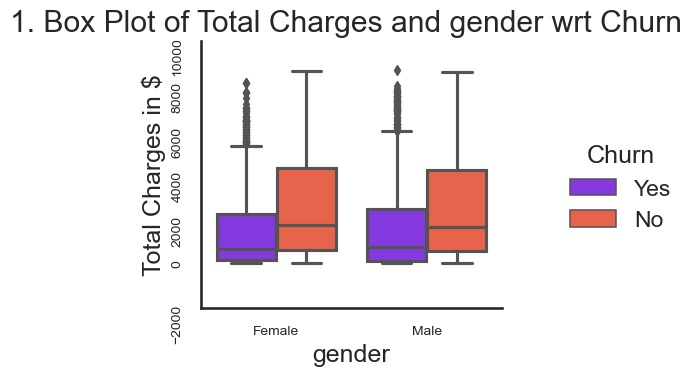

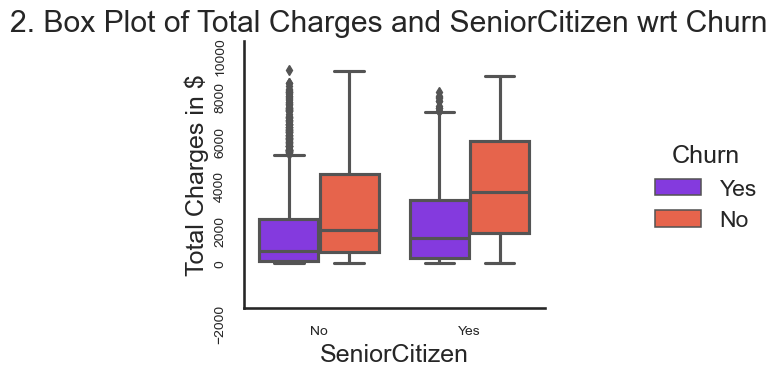

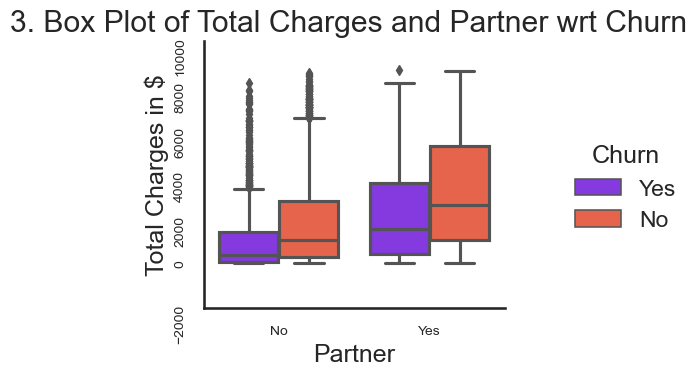

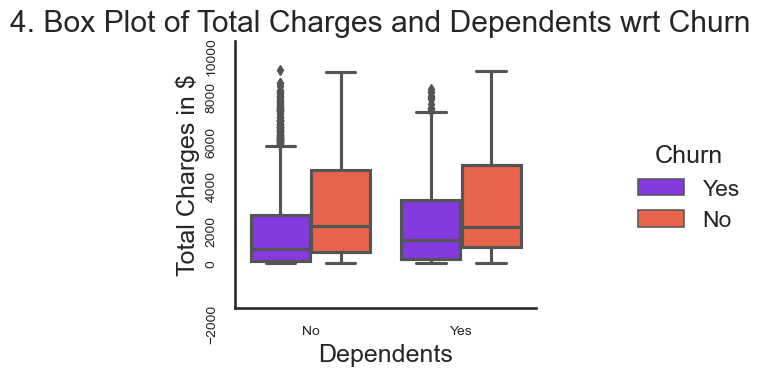

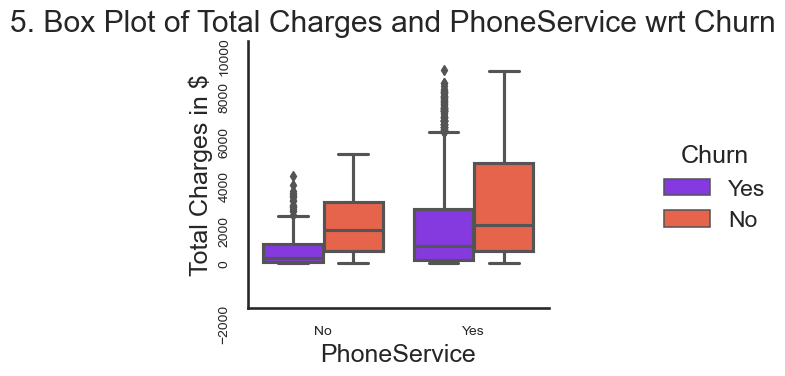

...

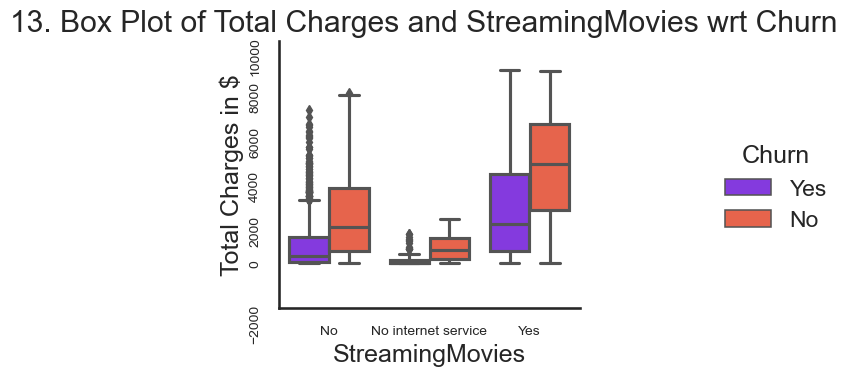

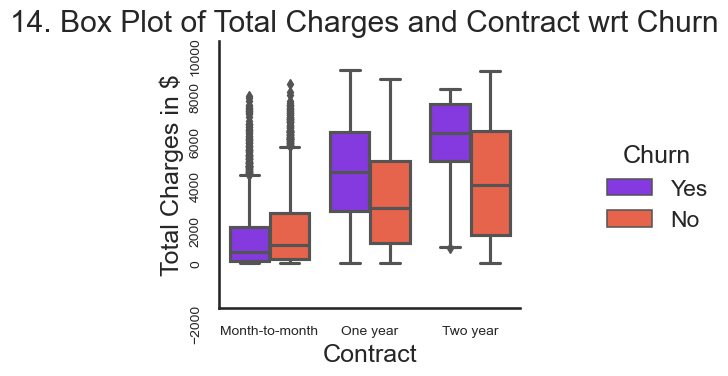

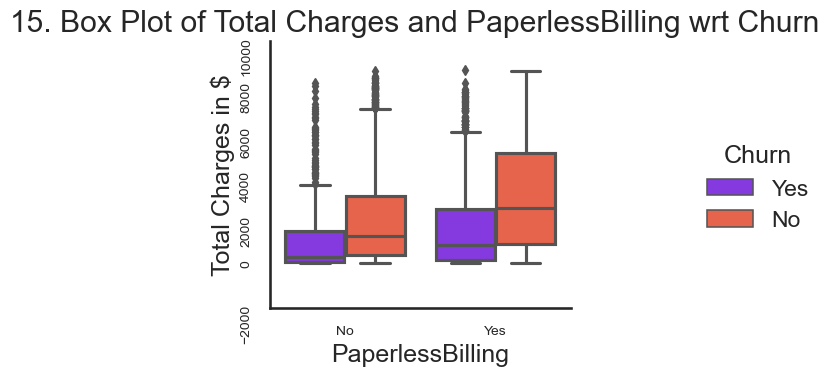

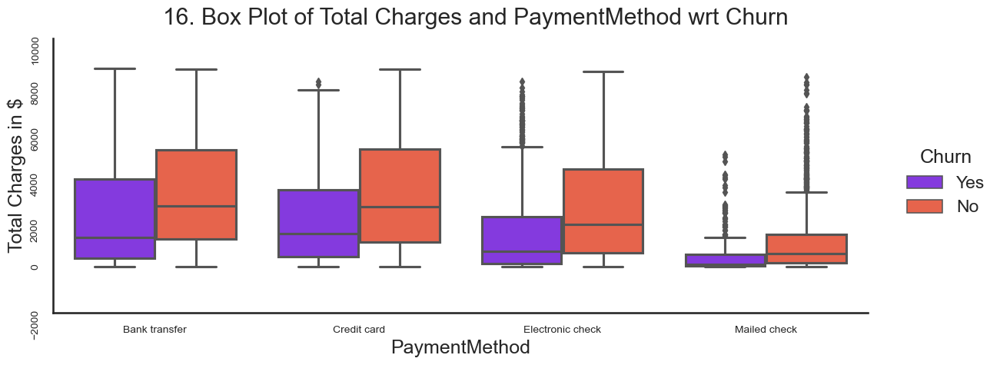

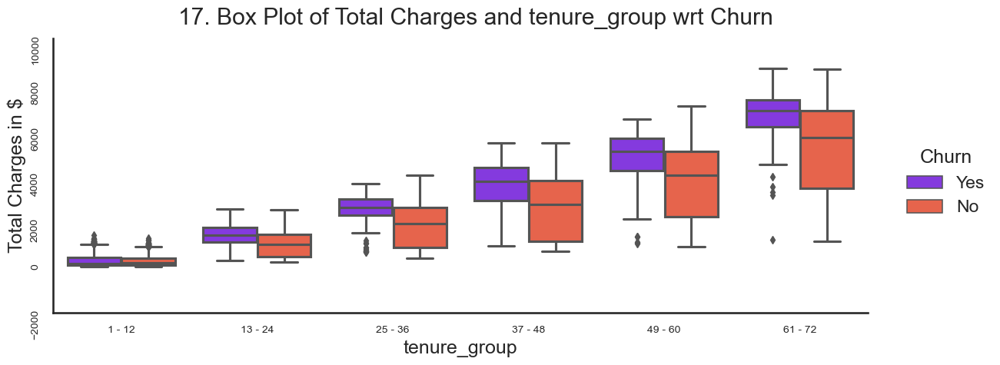

In [78]:
for i,col in enumerate(categorical_col):
        if telco_cleaned[col].nunique()>3 :
            fig_ht=5
            aspect=2.5
        else: 
            fig_ht=4
            aspect=1.2
            
        g = sns.catplot(kind='box',
                  data=telco_data,
                  x=col,y='TotalCharges',
                  hue='Churn',hue_order=['Yes','No'],palette=cpalette,
                  dodge=True,
                  sharex=False , margin_titles=True,
                  height=fig_ht, aspect=aspect
              )
        g.set(ylabel='Total Charges in $', xlabel=col)
        g.set_yticklabels(rotation=90)
        
        g.fig.subplots_adjust(top=0.9)  # Adjust the top of the figure to make space for the title
        
        g.fig.suptitle(f"{i+1}. Box Plot of Total Charges and {col} wrt Churn")
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.subplots_adjust(hspace=2,wspace=2)
        plt.show()

Insight:
1. Both male and female customers who have lower total charges are likely to churn.

2. Total charges are significantly higher for Senior Citizens compared to non-Senior Citizens and they have higher churn rate too.

3. Customers with partners have higher Total charges when compared to customers without partners.They have higher churn rate also.

4. Customers with dependents have high total charges when compared to customers without dependents.The churn rate is almost the same for both type of customers.

5. People with a phone service have a high total charges and their churn rate is also higher when compared to customers without a phone service.

6. Customers with multiple lines have higher total charges.Their  churn rate is also higher when compared to other two categories.Customers who have dont have multiple lines have signifantly lower total charges. As expected, customers who do not enroll in the phone service have low charges.

7. Customers who opted for 'Fiber optic' service have significantly higher  Total charges. Customers who opted for 'DSL' service has signifantly lower total charges . As expected, customers who do not enroll in the internet service have low charges.Higher the charges,higher is the churn rate.

8. Customers who opted for 'Online security' service have higher total charges. Customers who didnt opt for 'Online security' service has slightly lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

9. Customers who opted for 'Online Backup' service have higher total charges. Customers who didnt opt for 'Online Backup' service has lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

10. Customers who opted for 'Device Protection' service have higher total charges. Customers who didnt opt for 'Device Protection' service has lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

11. Customers who opted for 'Tech support' service have higher total charges. Customers who didnt opt for 'Tech support' service has lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

12. Customers who opted for 'Streaming TV' service have higher total charges. Customers who didnt opt for 'Streaming TV' service has lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

13. Customers who opted for 'Streaming Movies' service have higher total charges. Customers who didnt opt for 'Streaming Movies' service has lower total charges . As expected, customers who do not enroll in the internet service have minimal charges.Higher the charges,higher is the churn rate.

14. Customers who opted for 'Two year' contract and  higher total charges have higher churn rate. Customers who opted for 'one year' contract has slightly lower total charges . As expected, customers who do not enroll in the contract or on a month to month basis, have lower total charges.Higher the charges,higher is the churn rate.

15. Customers who opted for 'Paperless Billing' service have higher total charges. Customers who didnt opt for 'Paperless Billing' service has lower total charges .Higher the charges,higher is the churn rate.

16. Customers who opted for 'Mailed check' payment method are low churners as their monthly charges are low. Customers who opted for Credit card or Bank transfer methods have higher total charges and that signifies a higher churn rate  
17. Customers in tenure group 61-72 have the highest charges and have higher churn rate. In tenure 1-12 months ,total charges are lowest and so is the churn rate.As the length of tenure increases ,total charges and churn rate also increases

## **2C. BIVARIATE ANALYSIS BETWEEN NUMERICAL COLUMNS**

Relationship between Monthly Charges and Total Charges can also be shown using the LMP Plot.#LMP plot combines the functionality of scatterplot and regplot which helps in fitting a regression line over the scattered plot

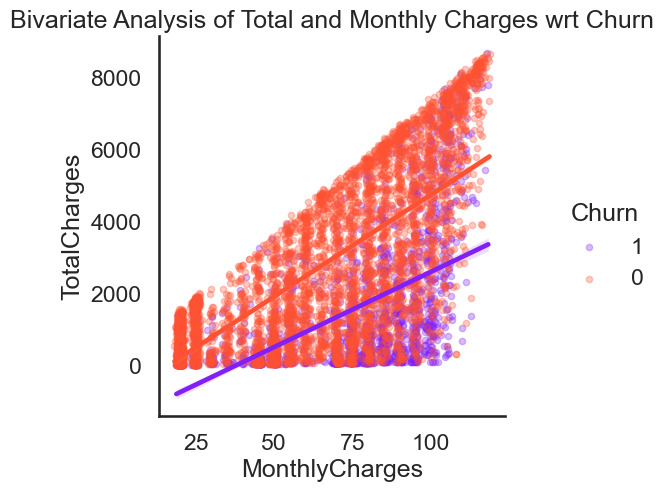

In [89]:



sns.lmplot(data=telco_data_dummies, x="MonthlyCharges", y="TotalCharges", hue="Churn",hue_order=[1,0], palette=cpalette, markers='.',
           
           scatter_kws={'alpha': 0.3})
plt.title("Bivariate Analysis of Total and Monthly Charges wrt Churn")

plt.show()


Insight:

1. Here from the above graph it is clear that as the monthy charges are increasing we can experience the total charges also increase which shows the positive correlation too.


# 3. ANALYSIS OF ALL INDEPENDENT COLUMNS WITH RESPECT TO CHURN


## 3A. UNIVARIATE ANALYSIS OF ALL INDEPENDENT COLUMNS WITH RESPECT TO CHURN



**Build a corelation of all predictors with 'Churn'**

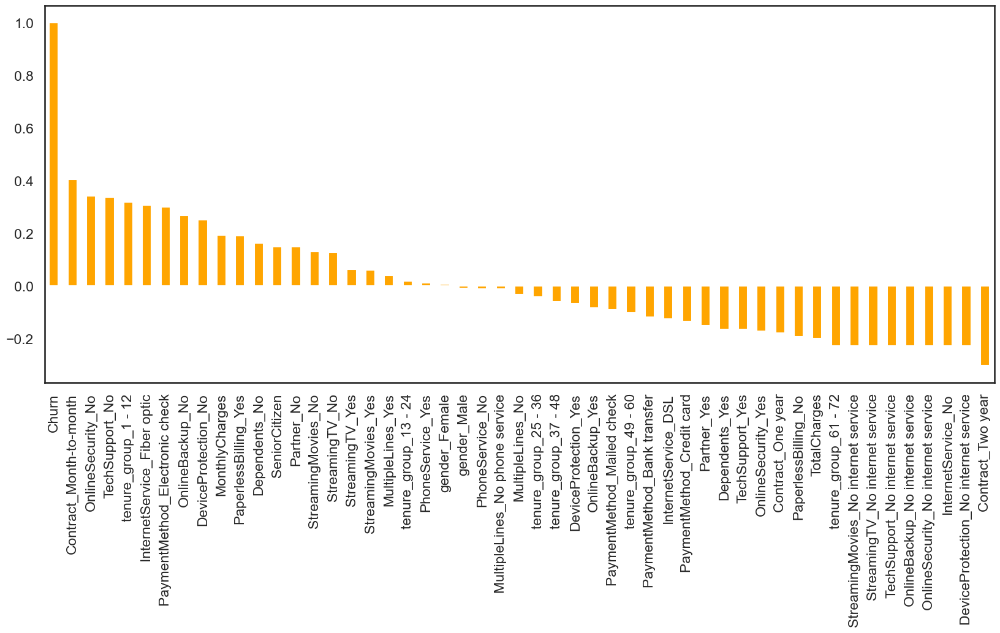

In [93]:
plt.figure(figsize=(20,8))
telco_data_dummies.corr()['Churn'].sort_values(ascending = False).plot(kind='bar', color='orange')
plt.show()
plt.close()

Derived Insight:
1. **HIGH** Churn seen in case of  **Month to month contracts**, **No online security**, **No Tech support**, **First year of subscription** and **Fibre Optics Internet**.  **LOW** Churn is seens in case of **Long term contracts**, **Subscriptions without internet service** and **The customers engaged for 5+ years**. Factors like **Gender**, **Availability of PhoneService** and **no of multiple lines** have alomost **NO** impact on Churn. This is also evident from the **Heatmap** below

## **3B. BIVARIATE ANALYSIS WITH RESPECT TO TARGET COLUMN**

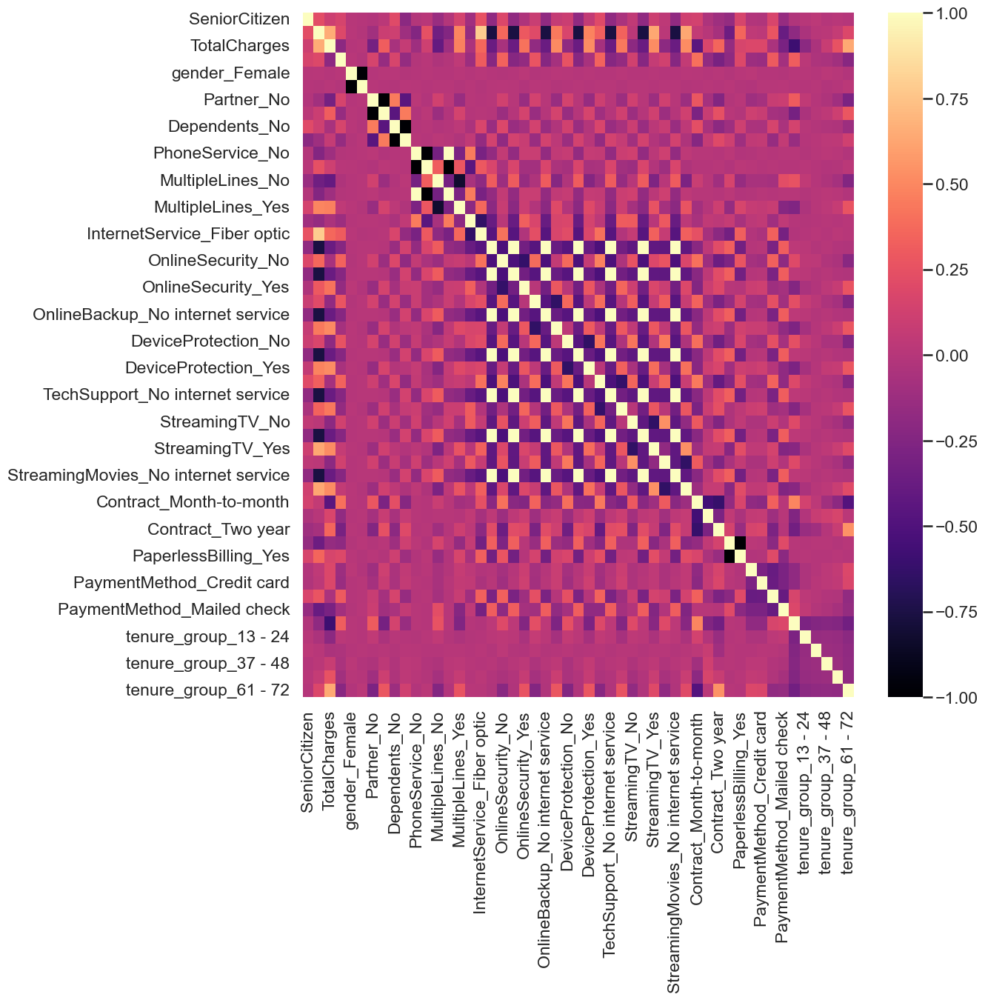

In [94]:
plt.figure(figsize=(12,12))
sns.heatmap(telco_data_dummies.corr(), vmin=-1,vmax=1, cmap='magma')
plt.show()
plt.close()


 Insight:

Based on the heatmap given, it could be seen that there is a strong correlation between the TotalCharges and the Tenure of staying in a service. This is true in real-life because the longer a customer stays in a service, the more willing he/she are going to be using that same service along with additional features or add-ons as well.It could also be seen that people who have opted for phone services from Telco did not opt for multiple lines of the same service. Therefore, we get to know that customers are open to adding multiple lines of different service providers rather than staying with the same phone service provider.Monthly charges are negatively correlated with whether a person has internet service, online security, online backup internet security, internet tech support, streaming TV service and streaming movies service.

# **SUMMARY OF INFERENCES**


1. Senior Citizens:
   Senior citizens without partners or dependents show significantly
   higher churn rates.
   Fiber optic internet increases churn rates among senior citizens.
   Month-to-month contracts contribute to a higher churn rate among senior citizens.

2. Gender:
   Overall, gender does not have a consistent impact on churn rates.
   Female customers with no partners, no dependents, and using certain services (fiber optic internet, no online security) tend to have higher churn rates.

3. Partners:
   Customers without partners and dependents are more likely to churn.
   Having fiber optic internet increases churn rates, especially for customers without partners.
   Month-to-month contracts and electronic check payments are associated with higher churn.

4. Dependents:
   Customers without dependents are generally high churners.
   Multiple lines and fiber optic internet increase churn rates for customers without dependents.

5. Phone Service:
   Customers with phone service and fiber optic internet are high churners.
   Lack of online security, online backup, and device protection in combination with phone service contribute to higher churn.

6. Multiple Lines:
   Fiber optic internet, along with multiple lines, leads to high churn rates.
   No online security, no online backup, and no device protection in combination with multiple lines contribute to high churn.

7. Internet Service:
   Fiber optic internet users exhibit higher churn rates, especially with no online security.
   Month-to-month contracts with fiber optic internet contribute significantly to churn.

8. Additional Services (Online Security, Online Backup, Device Protection, Tech Support, Streaming Services):
   Lack of online security, online backup, device protection, and tech support lead to higher churn rates.
   Month-to-month contracts without these services are associated with higher churn.
   Streaming services (TV and Movies) contribute to higher churn with month-to-month contracts.

9. Contract Type:
   Month-to-month contracts consistently result in higher churn across various services.
   Two-year contracts generally exhibit lower churn rates.

10. Paperless Billing:
    Electronic check payment with paperless billing shows high churn rates.
    Customers without paperless billing options demonstrate lower churn.

11. Payment Methods:
    Electronic check payment method, especially in combination with month-to-month contracts, leads to high churn.
    Customers with credit card payments and longer contracts (2 years) exhibit lower churn.

